In [1]:
from PIL import Image
from PIL import ImageDraw
import pandas as pd
import gdal
import math
import numpy as np
import matplotlib.pyplot as plt
import cv2 as cv

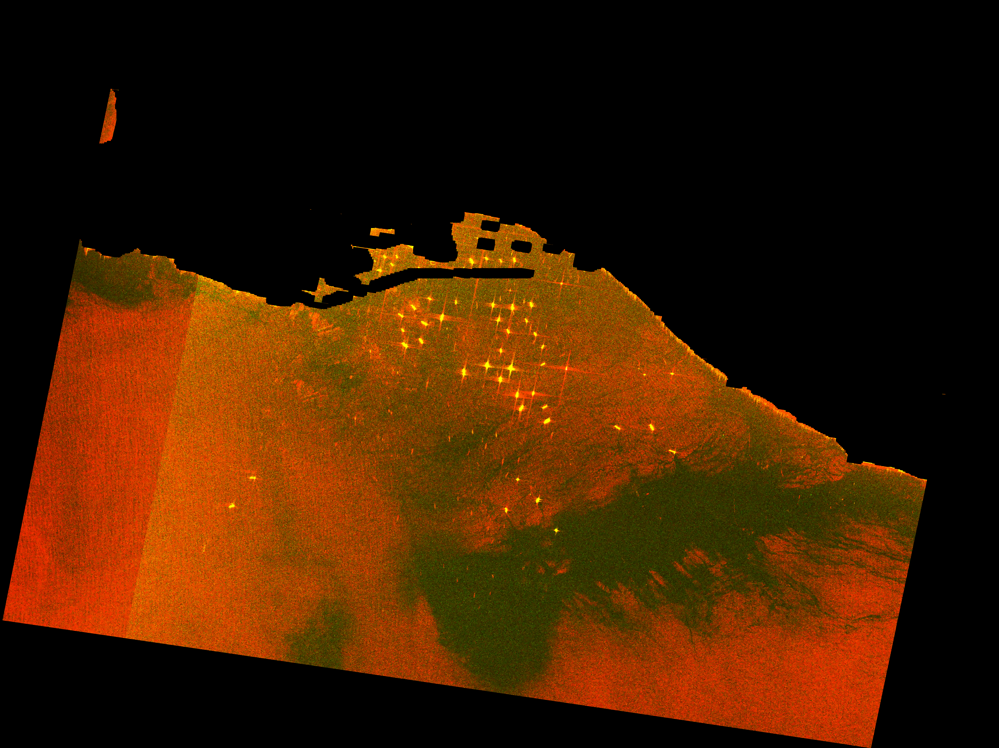

In [87]:
# im = Image.open("denoised_S1A_IW_GRDH_1SDV_20210106T015004_20210106T015033_036011_04381A_71E9.png")
im = Image.open("S1A_IW_GRDH_1SDV_20210118T135238_20210118T135303_036193_043E88_BD9D.png")
im

In [88]:
im_data = pd.read_csv("interpolated_processed_AIS_2021_01_06.csv", index_col=0)
im_data

,MMSI,BaseDateTime,LAT,LON,SOG,COG,Heading,VesselName,IMO,CallSign,VesselType,Status,Length,Width,Draft,Cargo,TranscieverClass
0,311827000,2021-01-06 01:50:18.500,33.735010,-118.143113,0.1,0.8,261.0,NORWEGIAN JEWEL,IMO9304045,C6TX6,60.0,1.0,294.0,37.0,8.3,NaN,A
1,367369720,2021-01-06 01:50:18.500,33.735033,-118.159440,0.0,327.6,272.0,ALTA JUNE,IMO9552290,WDE5645,31.0,0.0,23.0,10.0,NaN,NaN,A
2,367655170,2021-01-06 01:50:18.500,33.723813,-118.280826,0.5,42.5,511.0,PACIFIC STAR,IMO0000000,WDH8150,34.0,NaN,22.0,8.0,NaN,NaN,B
3,367344710,2021-01-06 01:50:18.500,33.614810,-117.914550,0.0,34.9,25.0,SERENGETI,NaN,WDE3827,37.0,5.0,35.0,7.0,NaN,37.0,A
4,636019717,2021-01-06 01:50:18.500,33.677190,-118.210063,0.2,295.9,269.0,VOLANS,IMO9430777,D5VV2,71.0,1.0,265.0,32.0,11.5,71.0,A
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
315,338239156,2021-01-06 01:50:18.500,33.719223,-118.278425,0.0,360.0,511.0,CONTROLLED CHAOS,IMO0000000,NaN,37.0,NaN,17.0,5.0,NaN,NaN,B
316,368167990,2021-01-06 01:50:18.500,33.610220,-117.925263,0.0,50.8,511.0,IT'S ALL GOOD,IMO0000000,WDL8279,37.0,NaN,14.0,5.0,NaN,NaN,B
317,338310827,2021-01-06 01:50:18.500,33.721710,-118.070111,0.0,58.0,511.0,JAWS,IMO0000000,NaN,37.0,NaN,16.0,4.0,NaN,NaN,B
318,367450790,2021-01-06 01:50:18.500,33.620436,-117.926894,0.0,258.0,511.0,IMAGINE,NaN,WDF4347,37.0,NaN,17.0,5.0,NaN,NaN,B


In [4]:
def calculate_px_from_lon2(row, xOrigin, pixelWidth):
    return (row['LON'] - xOrigin) / pixelWidth

def calculate_px_from_lat2(row, yOrigin, pixelHeight):
    return (yOrigin - row['LAT']) / pixelHeight

In [5]:
def calculate_px_from_Length(row, meters_in_one_pixel):
    if math.isnan(row['Length']):
        return math.nan
    return row['Length'] / meters_in_one_pixel

def calculate_px_from_Width(row, meters_in_one_pixel):
    if math.isnan(row['Width']):
        return math.nan
    return row['Width'] / meters_in_one_pixel

In [6]:
def calculate_Length_ratio(row, image_height):
    if math.isnan(row['Length_px']) or row['Length_px'] == 0:
        return math.nan
    return image_height / row['Length_px']

def calculate_Width_ratio(row, image_width):
    if math.isnan(row['Width_px']) or row['Width_px'] == 0:
        return math.nan
    return image_width / row['Width_px']

In [89]:
in_ds = gdal.Open("S1A_IW_GRDH_1SDV_20210106T015004_20210106T015033_036011_04381A_71E9.png")
image_width = in_ds.RasterXSize
image_height = in_ds.RasterYSize
geo_transform = in_ds.GetGeoTransform()
xOrigin = geo_transform[0]  # NEEDED
yOrigin = geo_transform[3]  # NEEDED
pixelWidth = geo_transform[1]  # NEEDED
pixelHeight = -geo_transform[5]  # NEEDED
print(image_width, image_height,  xOrigin, yOrigin, pixelWidth, pixelHeight)

minx = geo_transform[0]  # minLON
miny = geo_transform[3] + image_width * geo_transform[4] + image_height * geo_transform[5]  # minLAT
maxx = geo_transform[0] + image_width * geo_transform[1] + image_height * geo_transform[2]  # maxLON
maxy = geo_transform[3]  # maxLAT

condition1 = (im_data.LAT > miny) & (im_data.LAT < maxy)
# condition for latitude: between -157.0894 and -154.4233
condition2 = (im_data.LON > minx) & (im_data.LON < maxx)
# final dataframe
target_area = im_data[condition1 & condition2].copy().reset_index(drop=True)
im_data = target_area

# 1 pixel is about 11.5 meters
METERS_IN_ONE_PIXEL = 11.5
for _, row in im_data.iterrows():
    im_data['LONpx_X2'] = im_data.apply(
        lambda row: calculate_px_from_lon2(row, xOrigin, pixelWidth), axis=1)
    im_data['LATpx_Y2'] = im_data.apply(
        lambda row: calculate_px_from_lat2(row, yOrigin, pixelHeight), axis=1)
    im_data['Length_px'] = im_data.apply(
        lambda row: calculate_px_from_Length(row, METERS_IN_ONE_PIXEL), axis=1)
    im_data['Width_px'] = im_data.apply(
        lambda row: calculate_px_from_Width(row, METERS_IN_ONE_PIXEL), axis=1)
#     im_data['Length_px_ratio'] = im_data.apply(
#         lambda row: calculate_Length_ratio(row, image_height), axis=1)
#     im_data['Width_px_ratio'] = im_data.apply(
#         lambda row: calculate_Width_ratio(row, image_width), axis=1)

5813 3814 -118.41420082828058 33.833581925625644 8.983152841195215e-05 8.983152841195215e-05


In [90]:
im_data#.head(20)

,MMSI,BaseDateTime,LAT,LON,SOG,COG,Heading,VesselName,IMO,CallSign,...,Status,Length,Width,Draft,Cargo,TranscieverClass,LONpx_X2,LATpx_Y2,Length_px,Width_px
0,311827000,2021-01-06 01:50:18.500,33.735010,-118.143113,0.1,0.8,261.0,NORWEGIAN JEWEL,IMO9304045,C6TX6,...,1.0,294.0,37.0,8.3,NaN,A,3017.732190,1097.297657,25.565217,3.217391
1,367369720,2021-01-06 01:50:18.500,33.735033,-118.159440,0.0,327.6,272.0,ALTA JUNE,IMO9552290,WDE5645,...,0.0,23.0,10.0,NaN,NaN,A,2835.984568,1097.044658,2.000000,0.869565
2,367655170,2021-01-06 01:50:18.500,33.723813,-118.280826,0.5,42.5,511.0,PACIFIC STAR,IMO0000000,WDH8150,...,NaN,22.0,8.0,NaN,NaN,B,1484.716361,1221.939373,1.913043,0.695652
3,367344710,2021-01-06 01:50:18.500,33.614810,-117.914550,0.0,34.9,25.0,SERENGETI,NaN,WDE3827,...,5.0,35.0,7.0,NaN,37.0,A,5562.087578,2435.357936,3.043478,0.608696
4,636019717,2021-01-06 01:50:18.500,33.677190,-118.210063,0.2,295.9,269.0,VOLANS,IMO9430777,D5VV2,...,1.0,265.0,32.0,11.5,71.0,A,2272.449683,1740.946952,23.043478,2.782609
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
314,338239156,2021-01-06 01:50:18.500,33.719223,-118.278425,0.0,360.0,511.0,CONTROLLED CHAOS,IMO0000000,NaN,...,NaN,17.0,5.0,NaN,NaN,B,1511.445239,1273.036938,1.478261,0.434783
315,368167990,2021-01-06 01:50:18.500,33.610220,-117.925263,0.0,50.8,511.0,IT'S ALL GOOD,IMO0000000,WDL8279,...,NaN,14.0,5.0,NaN,NaN,B,5442.832757,2486.453582,1.217391,0.434783
316,338310827,2021-01-06 01:50:18.500,33.721710,-118.070111,0.0,58.0,511.0,JAWS,IMO0000000,NaN,...,NaN,16.0,4.0,NaN,NaN,B,3830.387132,1245.352579,1.391304,0.347826
317,367450790,2021-01-06 01:50:18.500,33.620436,-117.926894,0.0,258.0,511.0,IMAGINE,NaN,WDF4347,...,NaN,17.0,5.0,NaN,NaN,B,5424.669604,2372.734785,1.478261,0.434783


In [9]:
# BAD SOLUTION
# im_data_no_nans = im_data.dropna().reset_index(drop=True)
# im_data_no_nans

In [179]:
def getRed(R): return '#%02x%02x%02x' #(R,0,0)
def getGreen(G): return '#%02x%02x%02x' #(0,G,0)
def getBlue(B):return '#%02x%02x%02x' #(0,0,B)

In [77]:
120*120

14400

5813 3814
31.783333333333335 48.44166666666667

---------------------
NEW PICTURE
Ship center current coordinates: (3017.732189795386, 1097.2976567158862)
Ship left upper corner current coordinates: (2957.732189795386, 1037.2976567158862)
Ship right lower current coordinates: (3077.732189795386, 1157.2976567158862)
Cropped image size: (120, 120)


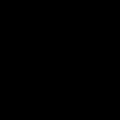

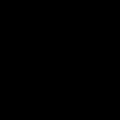

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



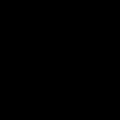

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (2835.9845678266897, 1097.0446578732378)
Ship left upper corner current coordinates: (2775.9845678266897, 1037.0446578732378)
Ship right lower current coordinates: (2895.9845678266897, 1157.0446578732378)
Cropped image size: (120, 120)


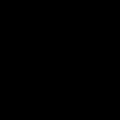

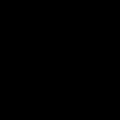

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



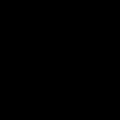

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (1484.7163612159547, 1221.9393727233996)
Ship left upper corner current coordinates: (1424.7163612159547, 1161.9393727233996)
Ship right lower current coordinates: (1544.7163612159547, 1281.9393727233996)
Cropped image size: (120, 120)


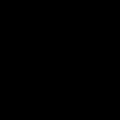

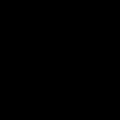

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



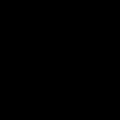

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (5562.087577863144, 2435.35793605108)
Ship left upper corner current coordinates: (5502.087577863144, 2375.35793605108)
Ship right lower current coordinates: (5622.087577863144, 2495.35793605108)
Cropped image size: (120, 120)


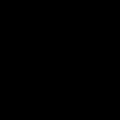

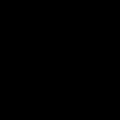

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



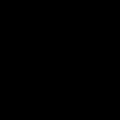

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (2272.4496831941988, 1740.9469524825888)
Ship left upper corner current coordinates: (2212.4496831941988, 1680.9469524825888)
Ship right lower current coordinates: (2332.4496831941988, 1800.9469524825888)
Cropped image size: (120, 120)


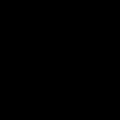

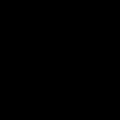

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



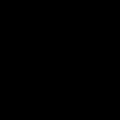

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (5563.595107916356, 2436.1201915473116)
Ship left upper corner current coordinates: (5503.595107916356, 2376.1201915473116)
Ship right lower current coordinates: (5623.595107916356, 2496.1201915473116)
Cropped image size: (120, 120)


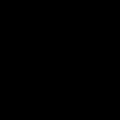

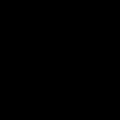

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



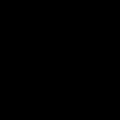

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (1544.010557680065, 882.2284005032768)
Ship left upper corner current coordinates: (1484.010557680065, 822.2284005032768)
Ship right lower current coordinates: (1604.010557680065, 942.2284005032768)
Cropped image size: (120, 120)


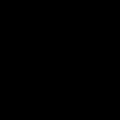

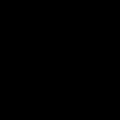

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



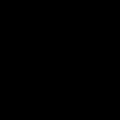

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (1545.6904699957886, 1157.5569210730557)
Ship left upper corner current coordinates: (1485.6904699957886, 1097.5569210730557)
Ship right lower current coordinates: (1605.6904699957886, 1217.5569210730557)
Cropped image size: (120, 120)


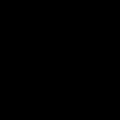

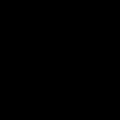

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



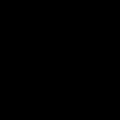

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (2254.932077058123, 690.9462641484005)
Ship left upper corner current coordinates: (2194.932077058123, 630.9462641484005)
Ship right lower current coordinates: (2314.932077058123, 750.9462641484005)
Cropped image size: (120, 120)


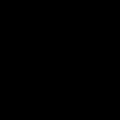

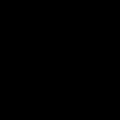

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



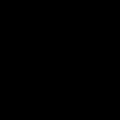

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (2196.9906531650254, 1211.6925339748684)
Ship left upper corner current coordinates: (2136.9906531650254, 1151.6925339748684)
Ship right lower current coordinates: (2256.9906531650254, 1271.6925339748684)
Cropped image size: (120, 120)


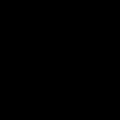

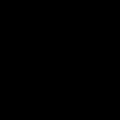

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



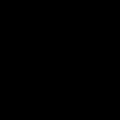

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (1530.4644599103997, 1268.5070335559453)
Ship left upper corner current coordinates: (1470.4644599103997, 1208.5070335559453)
Ship right lower current coordinates: (1590.4644599103997, 1328.5070335559453)
Cropped image size: (120, 120)


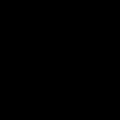

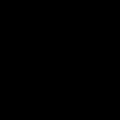

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



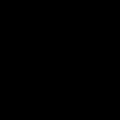

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (1795.739908421347, 1116.5649241376066)
Ship left upper corner current coordinates: (1735.739908421347, 1056.5649241376066)
Ship right lower current coordinates: (1855.739908421347, 1176.5649241376066)
Cropped image size: (120, 120)


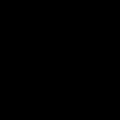

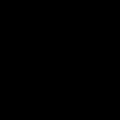

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



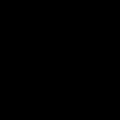

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (998.970090848727, 2724.333214196703)
Ship left upper corner current coordinates: (938.970090848727, 2664.333214196703)
Ship right lower current coordinates: (1058.970090848727, 2784.333214196703)
Cropped image size: (120, 120)


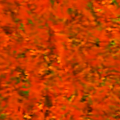

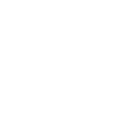

[[1 1 1 ... 1 1 1]
 [1 1 1 ... 1 1 1]
 [1 1 1 ... 1 1 1]
 ...
 [1 1 1 ... 1 1 1]
 [1 1 1 ... 1 1 1]
 [1 1 1 ... 1 1 1]]
black pixels cordinates: []
array shape: (0, 2)


,R,G,B
0,194,53,0
1,179,55,0
2,167,55,0
3,156,53,0
4,152,52,0
...,...,...,...
14395,200,63,0
14396,163,62,0
14397,166,55,0
14398,182,49,0


mean_pixel_value_from_image: [192, 61, 0]



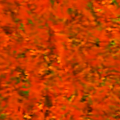

Ship center current coordinates: (60.00000000000006, 60.0)
RGB = (254, 98, 4)
Ship Length: (322.0 m), Width: (42.0 m)
50 50


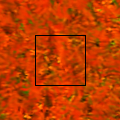

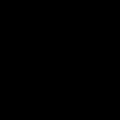

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
Maximum x-axis pixel: 0
Cumulated axis=0 sum px < THRESHOLD (0 < 5) - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (1557.9240195989437, 902.6776435189635)
Ship left upper corner current coordinates: (1497.9240195989437, 842.6776435189635)
Ship right lower current coordinates: (1617.9240195989437, 962.6776435189635)
Cropped image size: (120, 120)


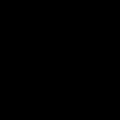

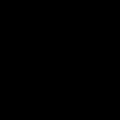

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



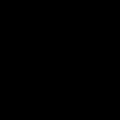

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (2341.837348195428, 1438.825854469692)
Ship left upper corner current coordinates: (2281.837348195428, 1378.825854469692)
Ship right lower current coordinates: (2401.837348195428, 1498.825854469692)
Cropped image size: (120, 120)


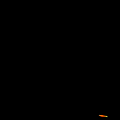

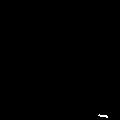

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14380, 2)


,R,G,B
0,12,7,4
1,12,7,4
2,192,109,44
3,249,130,19
4,254,119,7
5,238,93,2
6,165,62,0
7,100,41,0
8,43,28,2
9,10,9,3


mean_pixel_value_from_image: [123, 64, 11]



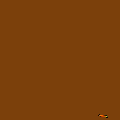

Ship center current coordinates: (60.0, 60.0)
RGB = (123, 64, 11)
Ship Length: (208.0 m), Width: (29.0 m)
50 50


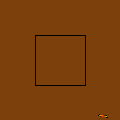

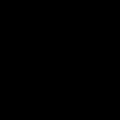

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
Maximum x-axis pixel: 0
Cumulated axis=0 sum px < THRESHOLD (0 < 5) - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (2157.1583129692995, 738.9602158523394)
Ship left upper corner current coordinates: (2097.1583129692995, 678.9602158523394)
Ship right lower current coordinates: (2217.1583129692995, 798.9602158523394)
Cropped image size: (120, 120)


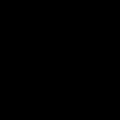

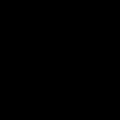

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



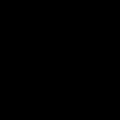

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (1663.3950945171737, 885.979560959099)
Ship left upper corner current coordinates: (1603.3950945171737, 825.979560959099)
Ship right lower current coordinates: (1723.3950945171737, 945.979560959099)
Cropped image size: (120, 120)


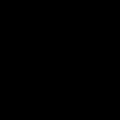

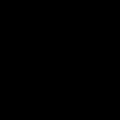

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



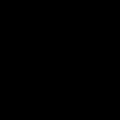

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (1771.5142010141326, 1151.243081954313)
Ship left upper corner current coordinates: (1711.5142010141326, 1091.243081954313)
Ship right lower current coordinates: (1831.5142010141326, 1211.243081954313)
Cropped image size: (120, 120)


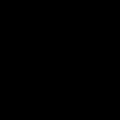

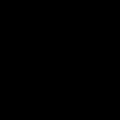

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



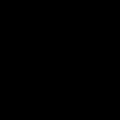

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (2245.5252090209533, 642.8009554452933)
Ship left upper corner current coordinates: (2185.5252090209533, 582.8009554452933)
Ship right lower current coordinates: (2305.5252090209533, 702.8009554452933)
Cropped image size: (120, 120)


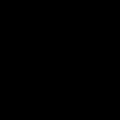

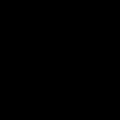

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



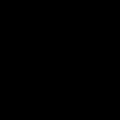

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (3167.77416546084, 1608.9220364017815)
Ship left upper corner current coordinates: (3107.77416546084, 1548.9220364017815)
Ship right lower current coordinates: (3227.77416546084, 1668.9220364017815)
Cropped image size: (120, 120)


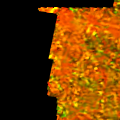

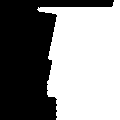

[[0 0 0 ... 1 1 1]
 [0 0 0 ... 1 1 1]
 [0 0 0 ... 1 1 1]
 ...
 [0 0 0 ... 1 1 1]
 [0 0 0 ... 1 1 1]
 [0 0 0 ... 1 1 1]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119  53]
 [119  54]
 [119  55]]
array shape: (6600, 2)


,R,G,B
0,68,78,2
1,98,101,0
2,101,78,0
3,111,94,0
4,126,149,1
...,...,...,...
7826,116,85,0
7827,116,79,0
7828,118,68,0
7829,137,74,0


mean_pixel_value_from_image: [193, 102, 1]



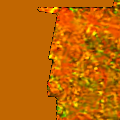

Ship center current coordinates: (60.0, 60.0)
RGB = (213, 119, 0)
Ship Length: (nan m), Width: (nan m)
50 50


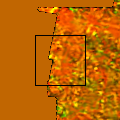

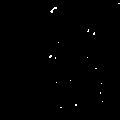

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
Maximum x-axis pixel: 5


0      0
1      0
2      0
3      0
4      0
      ..
115    0
116    0
117    0
118    1
119    1
Length: 120, dtype: int32

Maximum y-axis sum: 5
Maximum x-axis pixel: from 49 to 119
Maximum x-axis pixel: 51
Center x-axis pixel: 84
Maximum y-axis pixel: 51
Maximum y-axis pixel: 4
Cumulated axis=1 sum px < THRESHOLD (4 < 5) - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (1486.704455603704, 1226.5395855269276)
Ship left upper corner current coordinates: (1426.704455603704, 1166.5395855269276)
Ship right lower current coordinates: (1546.704455603704, 1286.5395855269276)
Cropped image size: (120, 120)


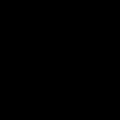

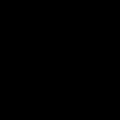

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



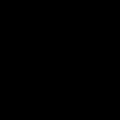

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (3003.7575119859835, 1322.816473529249)
Ship left upper corner current coordinates: (2943.7575119859835, 1262.816473529249)
Ship right lower current coordinates: (3063.7575119859835, 1382.816473529249)
Cropped image size: (120, 120)


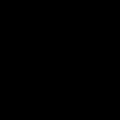

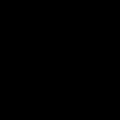

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



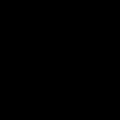

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (5702.107738071451, 2451.6105817069156)
Ship left upper corner current coordinates: (5642.107738071451, 2391.6105817069156)
Ship right lower current coordinates: (5762.107738071451, 2511.6105817069156)
Cropped image size: (120, 120)


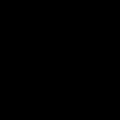

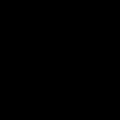

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



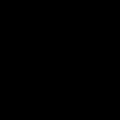

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (1582.0257902307137, 773.1401557453135)
Ship left upper corner current coordinates: (1522.0257902307137, 713.1401557453135)
Ship right lower current coordinates: (1642.0257902307137, 833.1401557453135)
Cropped image size: (120, 120)


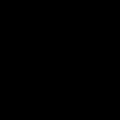

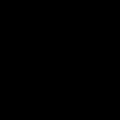

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



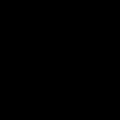

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (3817.2658791693834, 1223.5339592755045)
Ship left upper corner current coordinates: (3757.2658791693834, 1163.5339592755045)
Ship right lower current coordinates: (3877.2658791693834, 1283.5339592755045)
Cropped image size: (120, 120)


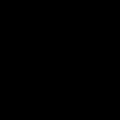

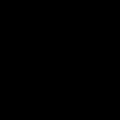

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



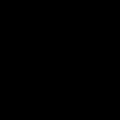

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (3257.983105033734, 2896.7268165631567)
Ship left upper corner current coordinates: (3197.983105033734, 2836.7268165631567)
Ship right lower current coordinates: (3317.983105033734, 2956.7268165631567)
Cropped image size: (120, 120)


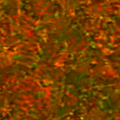

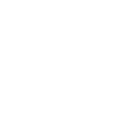

[[1 1 1 ... 1 1 1]
 [1 1 1 ... 1 1 1]
 [1 1 1 ... 1 1 1]
 ...
 [1 1 1 ... 1 1 1]
 [1 1 1 ... 1 1 1]
 [1 1 1 ... 1 1 1]]
black pixels cordinates: []
array shape: (0, 2)


,R,G,B
0,154,84,1
1,163,87,0
2,164,93,1
3,134,96,2
4,111,93,1
...,...,...,...
14395,149,54,0
14396,192,44,0
14397,197,38,0
14398,170,42,0


mean_pixel_value_from_image: [118, 62, 0]



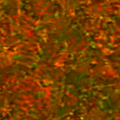

Ship center current coordinates: (60.0, 60.0)
RGB = (192, 64, 0)
Ship Length: (31.0 m), Width: (6.0 m)
50 50


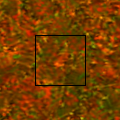

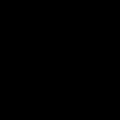

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
Maximum x-axis pixel: 0
Cumulated axis=0 sum px < THRESHOLD (0 < 5) - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (1489.1300487189626, 1248.6605181856798)
Ship left upper corner current coordinates: (1429.1300487189626, 1188.6605181856798)
Ship right lower current coordinates: (1549.1300487189626, 1308.6605181856798)
Cropped image size: (120, 120)


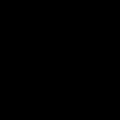

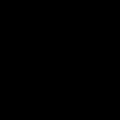

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



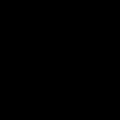

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (1523.0495783453712, 1143.2067762827448)
Ship left upper corner current coordinates: (1463.0495783453712, 1083.2067762827448)
Ship right lower current coordinates: (1583.0495783453712, 1203.2067762827448)
Cropped image size: (120, 120)


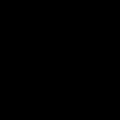

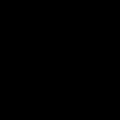

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



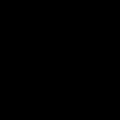

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (1837.6713743925977, 1105.2013405622654)
Ship left upper corner current coordinates: (1777.6713743925977, 1045.2013405622654)
Ship right lower current coordinates: (1897.6713743925977, 1165.2013405622654)
Cropped image size: (120, 120)


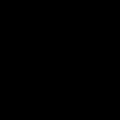

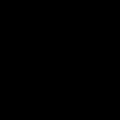

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



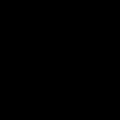

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (3390.244312486416, 901.6937266634577)
Ship left upper corner current coordinates: (3330.244312486416, 841.6937266634577)
Ship right lower current coordinates: (3450.244312486416, 961.6937266634577)
Cropped image size: (120, 120)


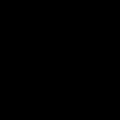

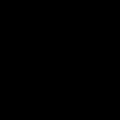

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



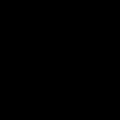

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (2210.146390586948, 961.4411237619668)
Ship left upper corner current coordinates: (2150.146390586948, 901.4411237619668)
Ship right lower current coordinates: (2270.146390586948, 1021.4411237619668)
Cropped image size: (120, 120)


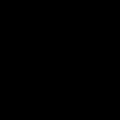

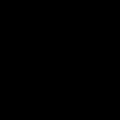

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



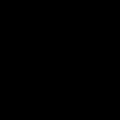

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (5568.259872562867, 2461.3261757983896)
Ship left upper corner current coordinates: (5508.259872562867, 2401.3261757983896)
Ship right lower current coordinates: (5628.259872562867, 2521.3261757983896)
Cropped image size: (120, 120)


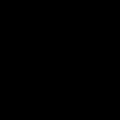

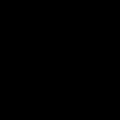

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



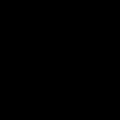

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (2441.7720941426055, 1353.3417931901638)
Ship left upper corner current coordinates: (2381.7720941426055, 1293.3417931901638)
Ship right lower current coordinates: (2501.7720941426055, 1413.3417931901638)
Cropped image size: (120, 120)


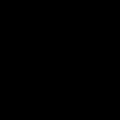

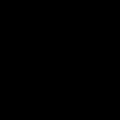

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



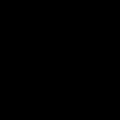

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (2081.3497397390634, 997.413646146873)
Ship left upper corner current coordinates: (2021.3497397390634, 937.413646146873)
Ship right lower current coordinates: (2141.3497397390634, 1057.413646146873)
Cropped image size: (120, 120)


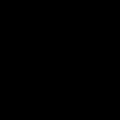

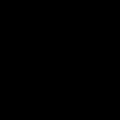

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



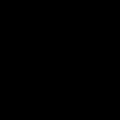

Ship center current coordinates: (60.0, 59.99999999999994)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (2755.6319329823227, 1095.8705408439287)
Ship left upper corner current coordinates: (2695.6319329823227, 1035.8705408439287)
Ship right lower current coordinates: (2815.6319329823227, 1155.8705408439287)
Cropped image size: (120, 120)


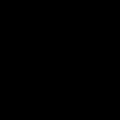

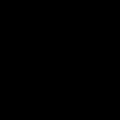

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



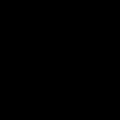

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (2386.309484767378, 1127.787479352185)
Ship left upper corner current coordinates: (2326.309484767378, 1067.787479352185)
Ship right lower current coordinates: (2446.309484767378, 1187.787479352185)
Cropped image size: (120, 120)


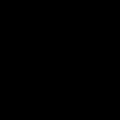

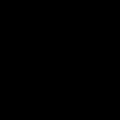

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



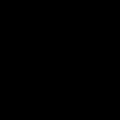

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (1579.7762399837668, 939.8493114255848)
Ship left upper corner current coordinates: (1519.7762399837668, 879.8493114255848)
Ship right lower current coordinates: (1639.7762399837668, 999.8493114255848)
Cropped image size: (120, 120)


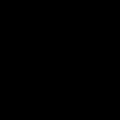

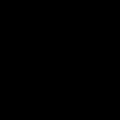

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



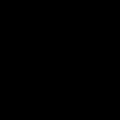

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (1612.5833640086564, 1083.3021992684603)
Ship left upper corner current coordinates: (1552.5833640086564, 1023.3021992684603)
Ship right lower current coordinates: (1672.5833640086564, 1143.3021992684603)
Cropped image size: (120, 120)


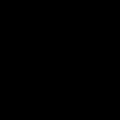

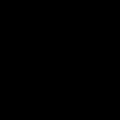

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



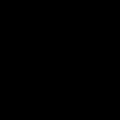

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (1990.0677572887125, 892.6115404745643)
Ship left upper corner current coordinates: (1930.0677572887125, 832.6115404745643)
Ship right lower current coordinates: (2050.0677572887125, 952.6115404745643)
Cropped image size: (120, 120)


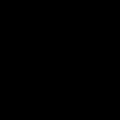

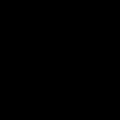

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



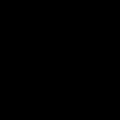

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (2555.459451027661, 799.3363143173314)
Ship left upper corner current coordinates: (2495.459451027661, 739.3363143173314)
Ship right lower current coordinates: (2615.459451027661, 859.3363143173314)
Cropped image size: (120, 120)


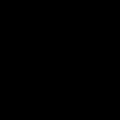

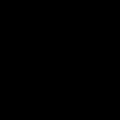

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



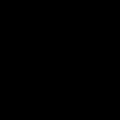

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (1637.6263019375704, 1268.3617655679698)
Ship left upper corner current coordinates: (1577.6263019375704, 1208.3617655679698)
Ship right lower current coordinates: (1697.6263019375704, 1328.3617655679698)
Cropped image size: (120, 120)


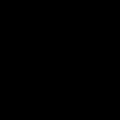

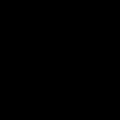

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



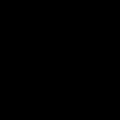

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (2549.893476487971, 829.3816986390057)
Ship left upper corner current coordinates: (2489.893476487971, 769.3816986390057)
Ship right lower current coordinates: (2609.893476487971, 889.3816986390057)
Cropped image size: (120, 120)


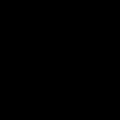

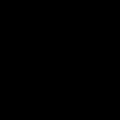

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



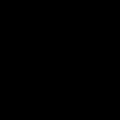

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (1705.7522669367331, 1150.6020580350917)
Ship left upper corner current coordinates: (1645.7522669367331, 1090.6020580350917)
Ship right lower current coordinates: (1765.7522669367331, 1210.6020580350917)
Cropped image size: (120, 120)


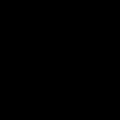

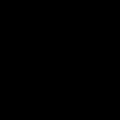

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



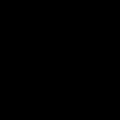

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (2843.7769321823193, 1102.917064611149)
Ship left upper corner current coordinates: (2783.7769321823193, 1042.917064611149)
Ship right lower current coordinates: (2903.7769321823193, 1162.917064611149)
Cropped image size: (120, 120)


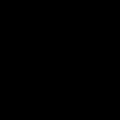

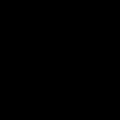

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



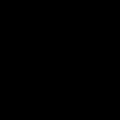

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (1513.9824024129196, 1252.6996658633452)
Ship left upper corner current coordinates: (1453.9824024129196, 1192.6996658633452)
Ship right lower current coordinates: (1573.9824024129196, 1312.6996658633452)
Cropped image size: (120, 120)


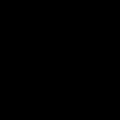

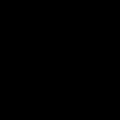

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



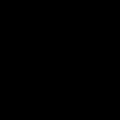

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (2390.51868918275, 785.3457200022749)
Ship left upper corner current coordinates: (2330.51868918275, 725.3457200022749)
Ship right lower current coordinates: (2450.51868918275, 845.3457200022749)
Cropped image size: (120, 120)


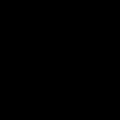

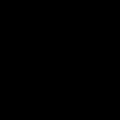

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



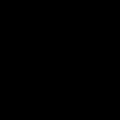

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (3775.243892061241, 1199.1549907917909)
Ship left upper corner current coordinates: (3715.243892061241, 1139.1549907917909)
Ship right lower current coordinates: (3835.243892061241, 1259.1549907917909)
Cropped image size: (120, 120)


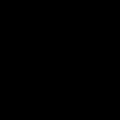

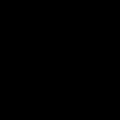

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



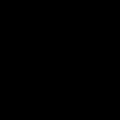

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (2239.8686946286953, 703.6881291968383)
Ship left upper corner current coordinates: (2179.8686946286953, 643.6881291968383)
Ship right lower current coordinates: (2299.8686946286953, 763.6881291968383)
Cropped image size: (120, 120)


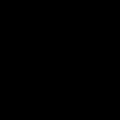

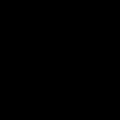

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



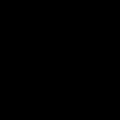

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (3261.61334646195, 1735.1298618823596)
Ship left upper corner current coordinates: (3201.61334646195, 1675.1298618823596)
Ship right lower current coordinates: (3321.61334646195, 1795.1298618823596)
Cropped image size: (120, 120)


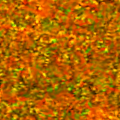

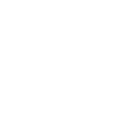

[[1 1 1 ... 1 1 1]
 [1 1 1 ... 1 1 1]
 [1 1 1 ... 1 1 1]
 ...
 [1 1 1 ... 1 1 1]
 [1 1 1 ... 1 1 1]
 [1 1 1 ... 1 1 1]]
black pixels cordinates: []
array shape: (0, 2)


,R,G,B
0,139,110,0
1,152,117,0
2,166,137,0
3,206,176,4
4,188,176,4
...,...,...,...
14395,197,104,0
14396,219,117,1
14397,239,135,4
14398,240,152,6


mean_pixel_value_from_image: [175, 99, 1]



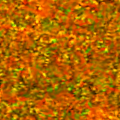

Ship center current coordinates: (60.0, 60.0)
RGB = (213, 126, 3)
Ship Length: (nan m), Width: (nan m)
50 50


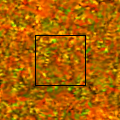

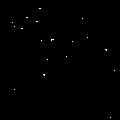

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
Maximum x-axis pixel: 2
Cumulated axis=0 sum px < THRESHOLD (2 < 5) - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (5415.063473592849, 2370.3907680291804)
Ship left upper corner current coordinates: (5355.063473592849, 2310.3907680291804)
Ship right lower current coordinates: (5475.063473592849, 2430.3907680291804)
Cropped image size: (120, 120)


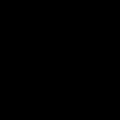

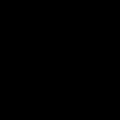

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



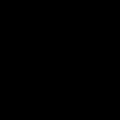

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (1597.4439132607117, 1103.07745285169)
Ship left upper corner current coordinates: (1537.4439132607117, 1043.07745285169)
Ship right lower current coordinates: (1657.4439132607117, 1163.07745285169)
Cropped image size: (120, 120)


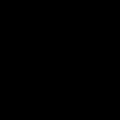

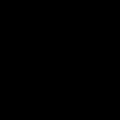

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



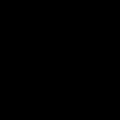

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (1563.9013266940237, 968.1822273262483)
Ship left upper corner current coordinates: (1503.9013266940237, 908.1822273262483)
Ship right lower current coordinates: (1623.9013266940237, 1028.1822273262483)
Cropped image size: (120, 120)


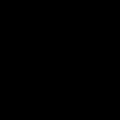

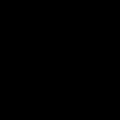

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



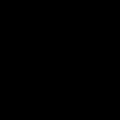

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (2373.0852100427414, 1002.564770050877)
Ship left upper corner current coordinates: (2313.0852100427414, 942.564770050877)
Ship right lower current coordinates: (2433.0852100427414, 1062.564770050877)
Cropped image size: (120, 120)


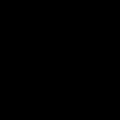

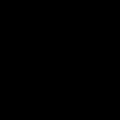

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



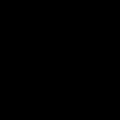

Ship center current coordinates: (60.0, 60.00000000000006)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (2254.216764996823, 687.1905806612432)
Ship left upper corner current coordinates: (2194.216764996823, 627.1905806612432)
Ship right lower current coordinates: (2314.216764996823, 747.1905806612432)
Cropped image size: (120, 120)


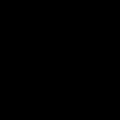

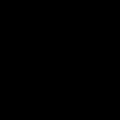

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



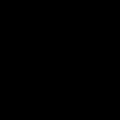

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (5448.645301532431, 2448.151962279985)
Ship left upper corner current coordinates: (5388.645301532431, 2388.151962279985)
Ship right lower current coordinates: (5508.645301532431, 2508.151962279985)
Cropped image size: (120, 120)


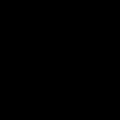

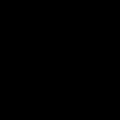

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



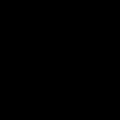

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (2353.6265104225913, 1102.0137497585506)
Ship left upper corner current coordinates: (2293.6265104225913, 1042.0137497585506)
Ship right lower current coordinates: (2413.6265104225913, 1162.0137497585506)
Cropped image size: (120, 120)


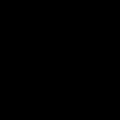

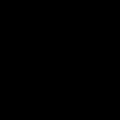

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



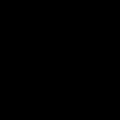

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (3527.723883616085, 1085.7224536641509)
Ship left upper corner current coordinates: (3467.723883616085, 1025.7224536641509)
Ship right lower current coordinates: (3587.723883616085, 1145.7224536641509)
Cropped image size: (120, 120)


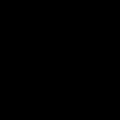

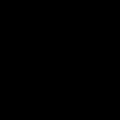

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



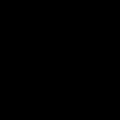

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (1483.0386461827575, 1301.6490723549598)
Ship left upper corner current coordinates: (1423.0386461827575, 1241.6490723549598)
Ship right lower current coordinates: (1543.0386461827575, 1361.6490723549598)
Cropped image size: (120, 120)


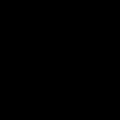

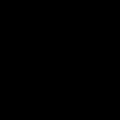

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



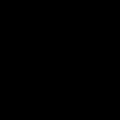

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (1500.0393588166858, 1276.6073818360373)
Ship left upper corner current coordinates: (1440.0393588166858, 1216.6073818360373)
Ship right lower current coordinates: (1560.0393588166858, 1336.6073818360373)
Cropped image size: (120, 120)


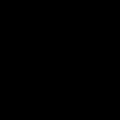

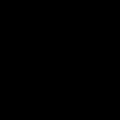

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



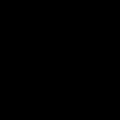

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (1613.4859544745095, 1209.4956688959887)
Ship left upper corner current coordinates: (1553.4859544745095, 1149.4956688959887)
Ship right lower current coordinates: (1673.4859544745095, 1269.4956688959887)
Cropped image size: (120, 120)


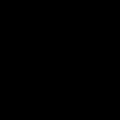

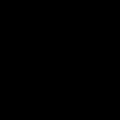

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



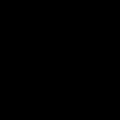

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (1581.5703556009553, 978.2580088043272)
Ship left upper corner current coordinates: (1521.5703556009553, 918.2580088043272)
Ship right lower current coordinates: (1641.5703556009553, 1038.2580088043273)
Cropped image size: (120, 120)


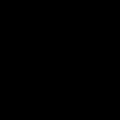

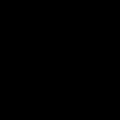

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



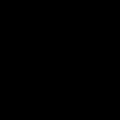

Ship center current coordinates: (60.0, 60.00000000000006)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (5461.220893709695, 2477.648117057581)
Ship left upper corner current coordinates: (5401.220893709695, 2417.648117057581)
Ship right lower current coordinates: (5521.220893709695, 2537.648117057581)
Cropped image size: (120, 120)


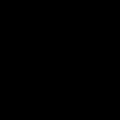

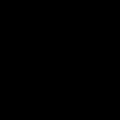

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



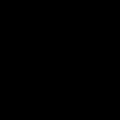

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (3314.630548365051, 865.4191573935356)
Ship left upper corner current coordinates: (3254.630548365051, 805.4191573935356)
Ship right lower current coordinates: (3374.630548365051, 925.4191573935356)
Cropped image size: (120, 120)


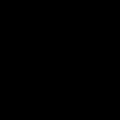

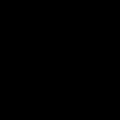

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



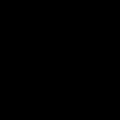

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (5780.077115384372, 2493.5186593409144)
Ship left upper corner current coordinates: (5720.077115384372, 2433.5186593409144)
Ship right lower current coordinates: (5840.077115384372, 2553.5186593409144)
Cropped image size: (120, 120)


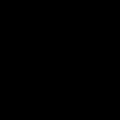

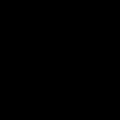

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



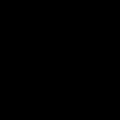

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (3598.857038233102, 1141.3212412220034)
Ship left upper corner current coordinates: (3538.857038233102, 1081.3212412220034)
Ship right lower current coordinates: (3658.857038233102, 1201.3212412220034)
Cropped image size: (120, 120)


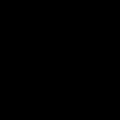

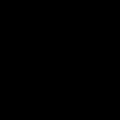

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



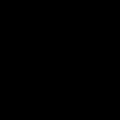

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (3377.861874460451, 897.3938257990869)
Ship left upper corner current coordinates: (3317.861874460451, 837.3938257990869)
Ship right lower current coordinates: (3437.861874460451, 957.3938257990869)
Cropped image size: (120, 120)


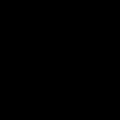

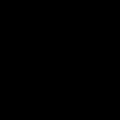

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



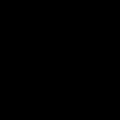

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (1669.2626195929965, 1131.7130141417817)
Ship left upper corner current coordinates: (1609.2626195929965, 1071.7130141417817)
Ship right lower current coordinates: (1729.2626195929965, 1191.7130141417817)
Cropped image size: (120, 120)


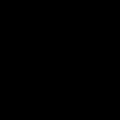

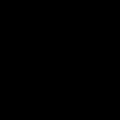

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



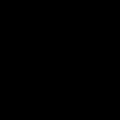

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (5670.599302629808, 2533.566505687807)
Ship left upper corner current coordinates: (5610.599302629808, 2473.566505687807)
Ship right lower current coordinates: (5730.599302629808, 2593.566505687807)
Cropped image size: (120, 120)


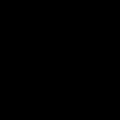

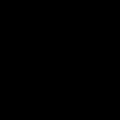

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



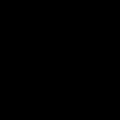

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (1488.4500721623606, 1226.428266036099)
Ship left upper corner current coordinates: (1428.4500721623606, 1166.428266036099)
Ship right lower current coordinates: (1548.4500721623606, 1286.428266036099)
Cropped image size: (120, 120)


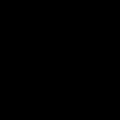

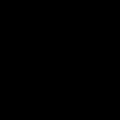

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



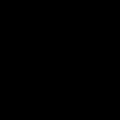

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (1495.8297694571177, 1224.940010074574)
Ship left upper corner current coordinates: (1435.8297694571177, 1164.940010074574)
Ship right lower current coordinates: (1555.8297694571177, 1284.940010074574)
Cropped image size: (120, 120)


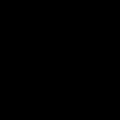

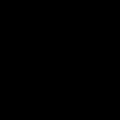

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



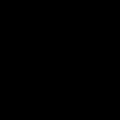

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (5524.572909465926, 2483.670595055351)
Ship left upper corner current coordinates: (5464.572909465926, 2423.670595055351)
Ship right lower current coordinates: (5584.572909465926, 2543.670595055351)
Cropped image size: (120, 120)


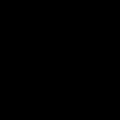

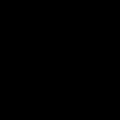

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



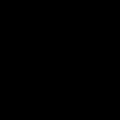

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (3369.0078932277406, 910.3666281911113)
Ship left upper corner current coordinates: (3309.0078932277406, 850.3666281911113)
Ship right lower current coordinates: (3429.0078932277406, 970.3666281911113)
Cropped image size: (120, 120)


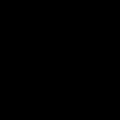

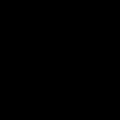

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



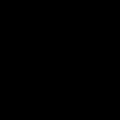

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (3960.3360794911005, 1321.272472192016)
Ship left upper corner current coordinates: (3900.3360794911005, 1261.272472192016)
Ship right lower current coordinates: (4020.3360794911005, 1381.272472192016)
Cropped image size: (120, 120)


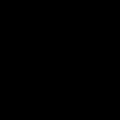

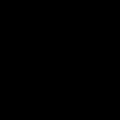

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



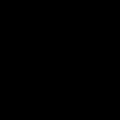

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (2180.2240073276207, 808.1121793989128)
Ship left upper corner current coordinates: (2120.2240073276207, 748.1121793989128)
Ship right lower current coordinates: (2240.2240073276207, 868.1121793989128)
Cropped image size: (120, 120)


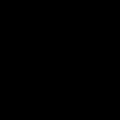

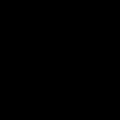

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



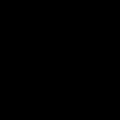

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (1765.4910618540312, 758.5524462320047)
Ship left upper corner current coordinates: (1705.4910618540312, 698.5524462320047)
Ship right lower current coordinates: (1825.4910618540312, 818.5524462320047)
Cropped image size: (120, 120)


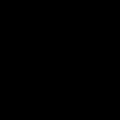

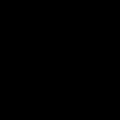

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



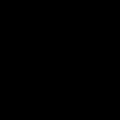

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (3014.980352126673, 1608.8985811244431)
Ship left upper corner current coordinates: (2954.980352126673, 1548.8985811244431)
Ship right lower current coordinates: (3074.980352126673, 1668.8985811244431)
Cropped image size: (120, 120)


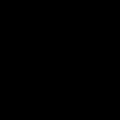

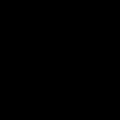

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



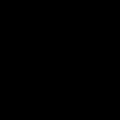

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (2470.5226795524845, 802.5236450953047)
Ship left upper corner current coordinates: (2410.5226795524845, 742.5236450953047)
Ship right lower current coordinates: (2530.5226795524845, 862.5236450953047)
Cropped image size: (120, 120)


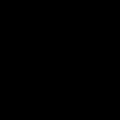

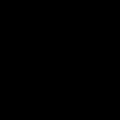

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



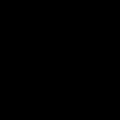

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (2249.6834875854056, 698.903876933732)
Ship left upper corner current coordinates: (2189.6834875854056, 638.903876933732)
Ship right lower current coordinates: (2309.6834875854056, 758.903876933732)
Cropped image size: (120, 120)


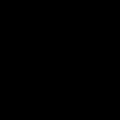

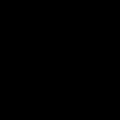

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



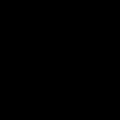

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (1593.8816895554617, 1097.0750177343082)
Ship left upper corner current coordinates: (1533.8816895554617, 1037.0750177343082)
Ship right lower current coordinates: (1653.8816895554617, 1157.0750177343082)
Cropped image size: (120, 120)


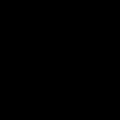

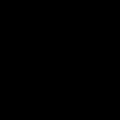

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



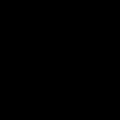

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (3922.35147847821, 1189.13623662038)
Ship left upper corner current coordinates: (3862.35147847821, 1129.13623662038)
Ship right lower current coordinates: (3982.35147847821, 1249.13623662038)
Cropped image size: (120, 120)


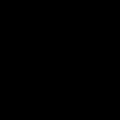

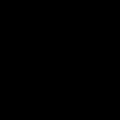

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



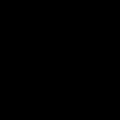

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (3762.58544942602, 1197.1075997584337)
Ship left upper corner current coordinates: (3702.58544942602, 1137.1075997584337)
Ship right lower current coordinates: (3822.58544942602, 1257.1075997584337)
Cropped image size: (120, 120)


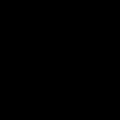

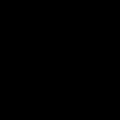

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



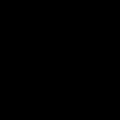

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (2151.481018938939, 760.2222385938802)
Ship left upper corner current coordinates: (2091.481018938939, 700.2222385938802)
Ship right lower current coordinates: (2211.481018938939, 820.2222385938802)
Cropped image size: (120, 120)


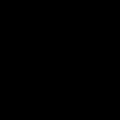

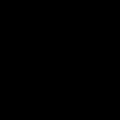

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



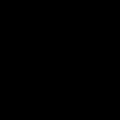

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (4189.924422091964, 2605.80763258229)
Ship left upper corner current coordinates: (4129.924422091964, 2545.80763258229)
Ship right lower current coordinates: (4249.924422091964, 2665.80763258229)
Cropped image size: (120, 120)


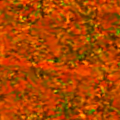

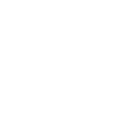

[[1 1 1 ... 1 1 1]
 [1 1 1 ... 1 1 1]
 [1 1 1 ... 1 1 1]
 ...
 [1 1 1 ... 1 1 1]
 [1 1 1 ... 1 1 1]
 [1 1 1 ... 1 1 1]]
black pixels cordinates: []
array shape: (0, 2)


,R,G,B
0,129,32,0
1,148,42,0
2,167,56,0
3,173,65,0
4,167,68,0
...,...,...,...
14395,221,74,1
14396,213,69,1
14397,195,61,0
14398,171,58,0


mean_pixel_value_from_image: [172, 69, 1]



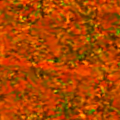

Ship center current coordinates: (60.0, 60.0)
RGB = (155, 92, 1)
Ship Length: (294.0 m), Width: (32.0 m)
50 50


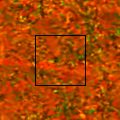

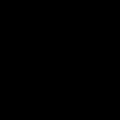

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
Maximum x-axis pixel: 0
Cumulated axis=0 sum px < THRESHOLD (0 < 5) - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (3949.4021147410194, 3671.560881310369)
Ship left upper corner current coordinates: (3889.4021147410194, 3611.560881310369)
Ship right lower current coordinates: (4009.4021147410194, 3731.560881310369)
Cropped image size: (120, 120)


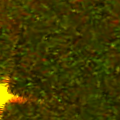

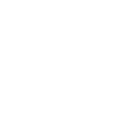

[[1 1 1 ... 1 1 1]
 [1 1 1 ... 1 1 1]
 [1 1 1 ... 1 1 1]
 ...
 [1 1 1 ... 1 1 1]
 [1 1 1 ... 1 1 1]
 [1 1 1 ... 1 1 1]]
black pixels cordinates: []
array shape: (0, 2)


,R,G,B
0,78,59,0
1,81,59,0
2,90,62,0
3,92,60,0
4,82,49,0
...,...,...,...
14395,61,67,1
14396,45,49,0
14397,37,42,0
14398,36,38,0


mean_pixel_value_from_image: [64, 59, 0]



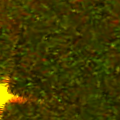

Ship center current coordinates: (60.0, 60.0)
RGB = (82, 75, 2)
Ship Length: (22.0 m), Width: (6.0 m)
50 50


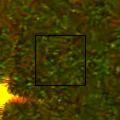

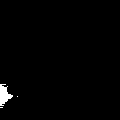

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
Maximum x-axis pixel: 23


0      23
1      23
2      21
3      20
4      18
       ..
115     0
116     0
117     0
118     0
119     0
Length: 120, dtype: int32

Maximum y-axis sum: 23
Maximum x-axis pixel: from 0 to 17
Maximum x-axis pixel: 0
Center x-axis pixel: 8
Maximum y-axis pixel: 0
Maximum y-axis pixel: 14


0      0
1      0
2      0
3      0
4      0
      ..
115    0
116    0
117    0
118    0
119    0
Length: 120, dtype: int32

Maximum x-axis sum: 14
Maximum x-axis pixel: from 84 to 107
Maximum x-axis pixel: 96
Center x-axis pixel: 96
Ship center current coordinates: (96, 8)


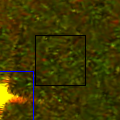

Ship center current coordinates: (8, 96)
tagging_length = 17, tagging_width = 23
tagging_length = 17, tagging_width = 23
x0,y0 = (-2.5, 82.5), x1,y1 = (18.5, 109.5)


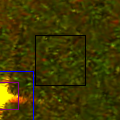

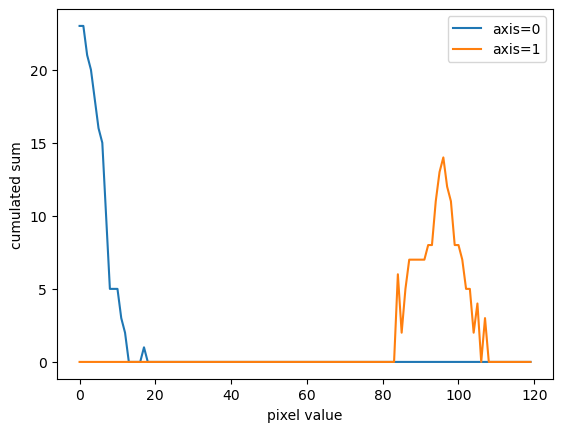

---------------------
NEW PICTURE
Ship center current coordinates: (4094.133644698269, 3661.8740616205637)
Ship left upper corner current coordinates: (4034.133644698269, 3601.8740616205637)
Ship right lower current coordinates: (4154.13364469827, 3721.8740616205637)
Cropped image size: (120, 120)


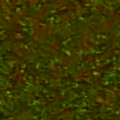

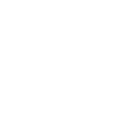

[[1 1 1 ... 1 1 1]
 [1 1 1 ... 1 1 1]
 [1 1 1 ... 1 1 1]
 ...
 [1 1 1 ... 1 1 1]
 [1 1 1 ... 1 1 1]
 [1 1 1 ... 1 1 1]]
black pixels cordinates: []
array shape: (0, 2)


,R,G,B
0,76,43,0
1,81,57,0
2,80,63,0
3,83,57,0
4,78,46,0
...,...,...,...
14395,43,44,0
14396,44,52,0
14397,52,54,0
14398,54,46,0


mean_pixel_value_from_image: [58, 55, 0]



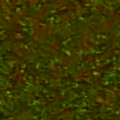

Ship center current coordinates: (60.00000000000023, 60.0)
RGB = (60, 70, 0)
Ship Length: (nan m), Width: (nan m)
50 50


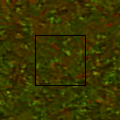

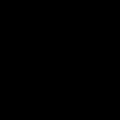

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
Maximum x-axis pixel: 0
Cumulated axis=0 sum px < THRESHOLD (0 < 5) - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (3760.3713731180483, 1199.5900224991549)
Ship left upper corner current coordinates: (3700.3713731180483, 1139.5900224991549)
Ship right lower current coordinates: (3820.3713731180483, 1259.5900224991549)
Cropped image size: (120, 120)


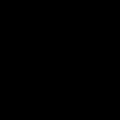

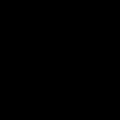

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



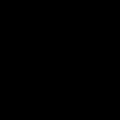

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (1542.325334893725, 1156.615514884245)
Ship left upper corner current coordinates: (1482.325334893725, 1096.615514884245)
Ship right lower current coordinates: (1602.325334893725, 1216.615514884245)
Cropped image size: (120, 120)


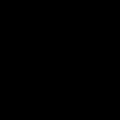

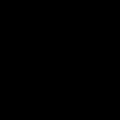

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



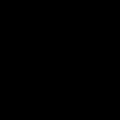

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (5437.187109193153, 2481.110246767084)
Ship left upper corner current coordinates: (5377.187109193153, 2421.110246767084)
Ship right lower current coordinates: (5497.187109193153, 2541.110246767084)
Cropped image size: (120, 120)


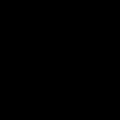

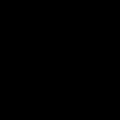

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



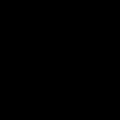

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (1498.8148444178876, 1274.6296055496205)
Ship left upper corner current coordinates: (1438.8148444178876, 1214.6296055496205)
Ship right lower current coordinates: (1558.8148444178876, 1334.6296055496205)
Cropped image size: (120, 120)


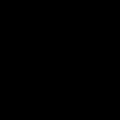

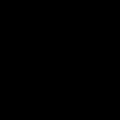

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



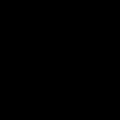

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (2219.3137010856326, 1001.538825554655)
Ship left upper corner current coordinates: (2159.3137010856326, 941.538825554655)
Ship right lower current coordinates: (2279.3137010856326, 1061.538825554655)
Cropped image size: (120, 120)


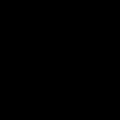

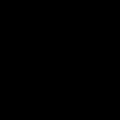

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



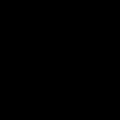

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (5769.049310234699, 2489.013930613384)
Ship left upper corner current coordinates: (5709.049310234699, 2429.013930613384)
Ship right lower current coordinates: (5829.049310234699, 2549.013930613384)
Cropped image size: (120, 120)


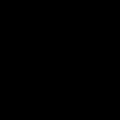

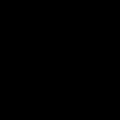

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



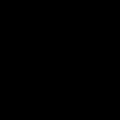

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (1653.4254731854503, 789.2705537186467)
Ship left upper corner current coordinates: (1593.4254731854503, 729.2705537186467)
Ship right lower current coordinates: (1713.4254731854503, 849.2705537186467)
Cropped image size: (120, 120)


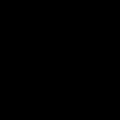

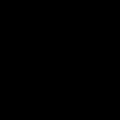

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



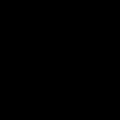

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (1587.9524086775764, 928.8631711827044)
Ship left upper corner current coordinates: (1527.9524086775764, 868.8631711827044)
Ship right lower current coordinates: (1647.9524086775764, 988.8631711827044)
Cropped image size: (120, 120)


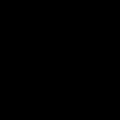

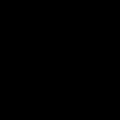

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



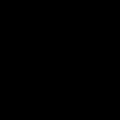

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (2333.6057231464124, 996.881458750588)
Ship left upper corner current coordinates: (2273.6057231464124, 936.881458750588)
Ship right lower current coordinates: (2393.6057231464124, 1056.881458750588)
Cropped image size: (120, 120)


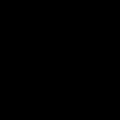

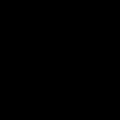

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



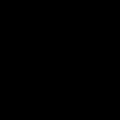

Ship center current coordinates: (60.0, 60.00000000000006)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (5462.456633603179, 2476.99142560777)
Ship left upper corner current coordinates: (5402.456633603179, 2416.99142560777)
Ship right lower current coordinates: (5522.456633603179, 2536.99142560777)
Cropped image size: (120, 120)


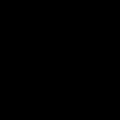

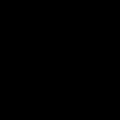

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



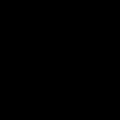

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (3170.9396858491755, 1417.219413706293)
Ship left upper corner current coordinates: (3110.9396858491755, 1357.219413706293)
Ship right lower current coordinates: (3230.9396858491755, 1477.219413706293)
Cropped image size: (120, 120)


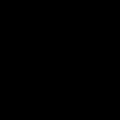

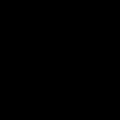

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



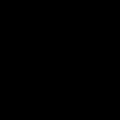

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (2223.4055709438976, 840.3844329177829)
Ship left upper corner current coordinates: (2163.4055709438976, 780.3844329177829)
Ship right lower current coordinates: (2283.4055709438976, 900.3844329177829)
Cropped image size: (120, 120)


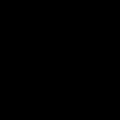

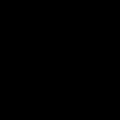

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



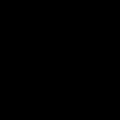

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (2249.4525954045325, 655.3749151182432)
Ship left upper corner current coordinates: (2189.4525954045325, 595.3749151182432)
Ship right lower current coordinates: (2309.4525954045325, 715.3749151182432)
Cropped image size: (120, 120)


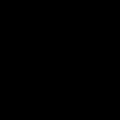

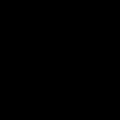

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



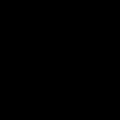

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (3341.050123460409, 943.6767594212104)
Ship left upper corner current coordinates: (3281.050123460409, 883.6767594212104)
Ship right lower current coordinates: (3401.050123460409, 1003.6767594212104)
Cropped image size: (120, 120)


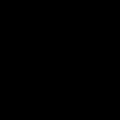

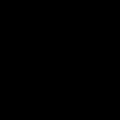

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



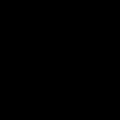

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (2040.0931934084356, 901.4029072491355)
Ship left upper corner current coordinates: (1980.0931934084356, 841.4029072491355)
Ship right lower current coordinates: (2100.0931934084356, 961.4029072491355)
Cropped image size: (120, 120)


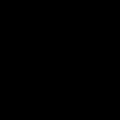

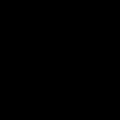

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



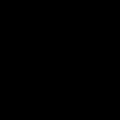

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (5565.204523605396, 2436.817375529061)
Ship left upper corner current coordinates: (5505.204523605396, 2376.817375529061)
Ship right lower current coordinates: (5625.204523605396, 2496.817375529061)
Cropped image size: (120, 120)


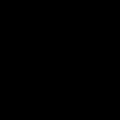

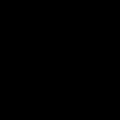

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



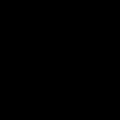

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (1496.4771351112777, 1267.2252797529284)
Ship left upper corner current coordinates: (1436.4771351112777, 1207.2252797529284)
Ship right lower current coordinates: (1556.4771351112777, 1327.2252797529284)
Cropped image size: (120, 120)


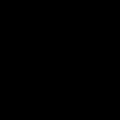

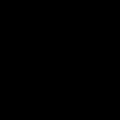

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



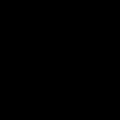

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (1754.4419981839446, 820.0886693633495)
Ship left upper corner current coordinates: (1694.4419981839446, 760.0886693633495)
Ship right lower current coordinates: (1814.4419981839446, 880.0886693633495)
Cropped image size: (120, 120)


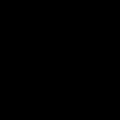

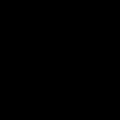

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



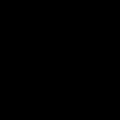

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (3167.3871152093757, 858.9582036364924)
Ship left upper corner current coordinates: (3107.3871152093757, 798.9582036364924)
Ship right lower current coordinates: (3227.3871152093757, 918.9582036364924)
Cropped image size: (120, 120)


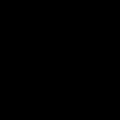

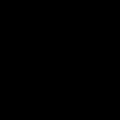

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



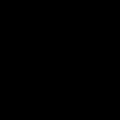

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (1705.0898608578054, 1140.4794991899332)
Ship left upper corner current coordinates: (1645.0898608578054, 1080.4794991899332)
Ship right lower current coordinates: (1765.0898608578054, 1200.4794991899332)
Cropped image size: (120, 120)


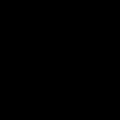

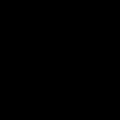

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



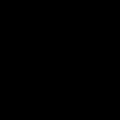

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (1536.8861102692488, 1278.076786704315)
Ship left upper corner current coordinates: (1476.8861102692488, 1218.076786704315)
Ship right lower current coordinates: (1596.8861102692488, 1338.076786704315)
Cropped image size: (120, 120)


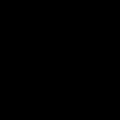

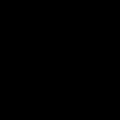

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



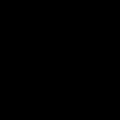

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (1804.793315979004, 795.5401342875305)
Ship left upper corner current coordinates: (1744.793315979004, 735.5401342875305)
Ship right lower current coordinates: (1864.793315979004, 855.5401342875305)
Cropped image size: (120, 120)


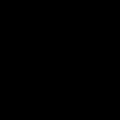

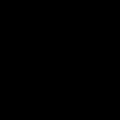

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



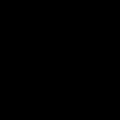

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (2227.895170199049, 854.9907474960431)
Ship left upper corner current coordinates: (2167.895170199049, 794.9907474960431)
Ship right lower current coordinates: (2287.895170199049, 914.9907474960431)
Cropped image size: (120, 120)


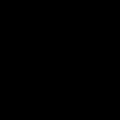

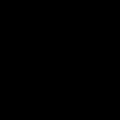

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



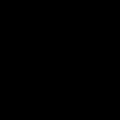

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (1591.3434045898439, 1249.1153788354463)
Ship left upper corner current coordinates: (1531.3434045898439, 1189.1153788354463)
Ship right lower current coordinates: (1651.3434045898439, 1309.1153788354463)
Cropped image size: (120, 120)


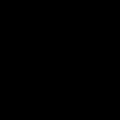

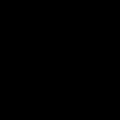

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



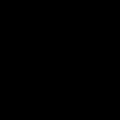

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (5713.5397859446375, 2495.8621201545498)
Ship left upper corner current coordinates: (5653.5397859446375, 2435.8621201545498)
Ship right lower current coordinates: (5773.5397859446375, 2555.8621201545498)
Cropped image size: (120, 120)


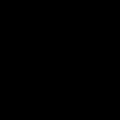

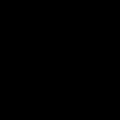

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



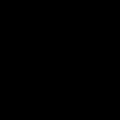

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (2413.2050158729953, 1033.5872857450968)
Ship left upper corner current coordinates: (2353.2050158729953, 973.5872857450968)
Ship right lower current coordinates: (2473.2050158729953, 1093.5872857450968)
Cropped image size: (120, 120)


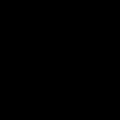

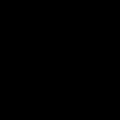

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



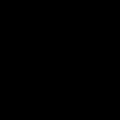

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (1565.1259913891558, 934.9938391393474)
Ship left upper corner current coordinates: (1505.1259913891558, 874.9938391393474)
Ship right lower current coordinates: (1625.1259913891558, 994.9938391393474)
Cropped image size: (120, 120)


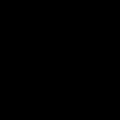

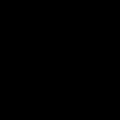

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



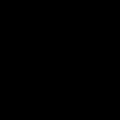

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (3341.703828235027, 903.6004461692414)
Ship left upper corner current coordinates: (3281.703828235027, 843.6004461692414)
Ship right lower current coordinates: (3401.703828235027, 963.6004461692414)
Cropped image size: (120, 120)


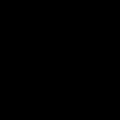

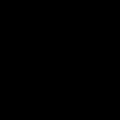

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



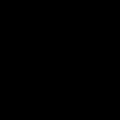

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (2123.2058682773313, 1085.285611259724)
Ship left upper corner current coordinates: (2063.2058682773313, 1025.285611259724)
Ship right lower current coordinates: (2183.2058682773313, 1145.285611259724)
Cropped image size: (120, 120)


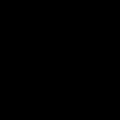

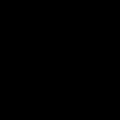

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



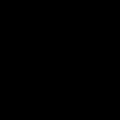

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (2223.318194119074, 861.3364398528432)
Ship left upper corner current coordinates: (2163.318194119074, 801.3364398528432)
Ship right lower current coordinates: (2283.318194119074, 921.3364398528432)
Cropped image size: (120, 120)


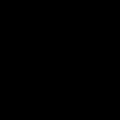

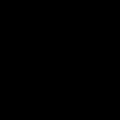

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



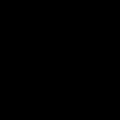

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (2059.753758525274, 713.3567329699065)
Ship left upper corner current coordinates: (1999.753758525274, 653.3567329699065)
Ship right lower current coordinates: (2119.753758525274, 773.3567329699065)
Cropped image size: (120, 120)


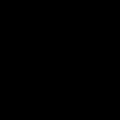

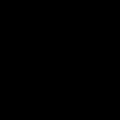

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



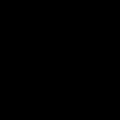

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (3923.8918619321275, 1912.2286869917182)
Ship left upper corner current coordinates: (3863.8918619321275, 1852.2286869917182)
Ship right lower current coordinates: (3983.8918619321275, 1972.2286869917182)
Cropped image size: (120, 120)


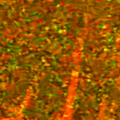

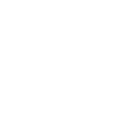

[[1 1 1 ... 1 1 1]
 [1 1 1 ... 1 1 1]
 [1 1 1 ... 1 1 1]
 ...
 [1 1 1 ... 1 1 1]
 [1 1 1 ... 1 1 1]
 [1 1 1 ... 1 1 1]]
black pixels cordinates: []
array shape: (0, 2)


,R,G,B
0,199,101,2
1,219,101,2
2,214,94,2
3,190,103,2
4,155,118,1
...,...,...,...
14395,142,81,0
14396,115,55,0
14397,122,58,0
14398,127,68,0


mean_pixel_value_from_image: [147, 85, 1]



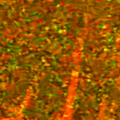

Ship center current coordinates: (60.0, 60.0)
RGB = (179, 73, 0)
Ship Length: (27.0 m), Width: (5.0 m)
50 50


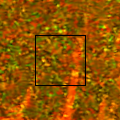

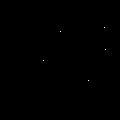

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
Maximum x-axis pixel: 1
Cumulated axis=0 sum px < THRESHOLD (1 < 5) - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (3763.330192063448, 1185.99215791378)
Ship left upper corner current coordinates: (3703.330192063448, 1125.99215791378)
Ship right lower current coordinates: (3823.330192063448, 1245.99215791378)
Cropped image size: (120, 120)


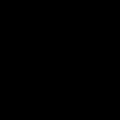

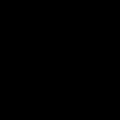

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



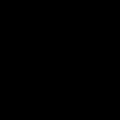

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (1759.7686721276796, 806.9896508051826)
Ship left upper corner current coordinates: (1699.7686721276796, 746.9896508051826)
Ship right lower current coordinates: (1819.7686721276796, 866.9896508051826)
Cropped image size: (120, 120)


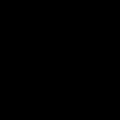

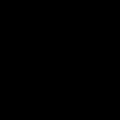

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



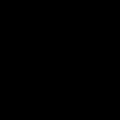

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (2210.030056704724, 957.2577372979503)
Ship left upper corner current coordinates: (2150.030056704724, 897.2577372979503)
Ship right lower current coordinates: (2270.030056704724, 1017.2577372979503)
Cropped image size: (120, 120)


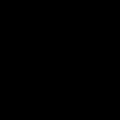

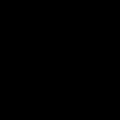

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



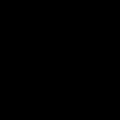

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (5479.658003801008, 2398.1224026706795)
Ship left upper corner current coordinates: (5419.658003801008, 2338.1224026706795)
Ship right lower current coordinates: (5539.658003801008, 2458.1224026706795)
Cropped image size: (120, 120)


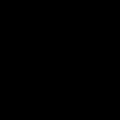

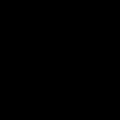

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



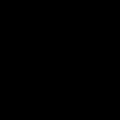

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (2228.4061155666986, 818.6664505892304)
Ship left upper corner current coordinates: (2168.4061155666986, 758.6664505892304)
Ship right lower current coordinates: (2288.4061155666986, 878.6664505892304)
Cropped image size: (120, 120)


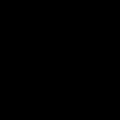

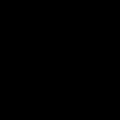

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



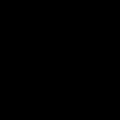

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (2575.4969593704827, 798.1821849544127)
Ship left upper corner current coordinates: (2515.4969593704827, 738.1821849544127)
Ship right lower current coordinates: (2635.4969593704827, 858.1821849544127)
Cropped image size: (120, 120)


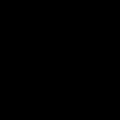

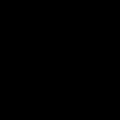

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



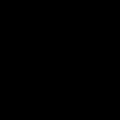

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (2283.0610268887804, 1199.1561002883614)
Ship left upper corner current coordinates: (2223.0610268887804, 1139.1561002883614)
Ship right lower current coordinates: (2343.0610268887804, 1259.1561002883614)
Cropped image size: (120, 120)


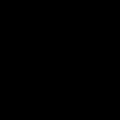

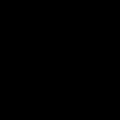

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



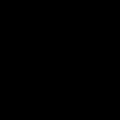

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (3337.812832322752, 940.1149055479925)
Ship left upper corner current coordinates: (3277.812832322752, 880.1149055479925)
Ship right lower current coordinates: (3397.812832322752, 1000.1149055479925)
Cropped image size: (120, 120)


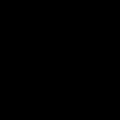

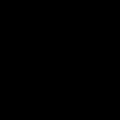

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



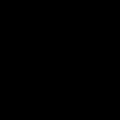

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (2181.982184603067, 859.296210586758)
Ship left upper corner current coordinates: (2121.982184603067, 799.296210586758)
Ship right lower current coordinates: (2241.982184603067, 919.296210586758)
Cropped image size: (120, 120)


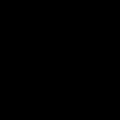

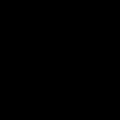

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



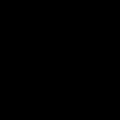

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (1529.3141585054343, 827.6833342745022)
Ship left upper corner current coordinates: (1469.3141585054343, 767.6833342745022)
Ship right lower current coordinates: (1589.3141585054343, 887.6833342745022)
Cropped image size: (120, 120)


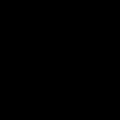

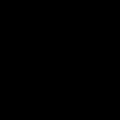

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



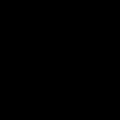

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (5675.522138981586, 2443.3729393882086)
Ship left upper corner current coordinates: (5615.522138981586, 2383.3729393882086)
Ship right lower current coordinates: (5735.522138981586, 2503.3729393882086)
Cropped image size: (120, 120)


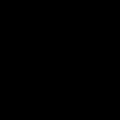

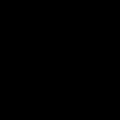

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



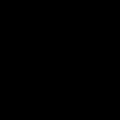

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (1499.3706997420306, 1224.869793164973)
Ship left upper corner current coordinates: (1439.3706997420306, 1164.869793164973)
Ship right lower current coordinates: (1559.3706997420306, 1284.869793164973)
Cropped image size: (120, 120)


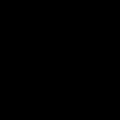

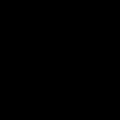

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



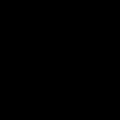

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (1838.5663830985939, 1133.2516258522949)
Ship left upper corner current coordinates: (1778.5663830985939, 1073.2516258522949)
Ship right lower current coordinates: (1898.5663830985939, 1193.2516258522949)
Cropped image size: (120, 120)


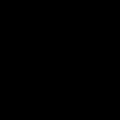

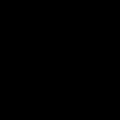

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



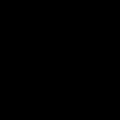

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (2192.9960400465384, 737.9654893933815)
Ship left upper corner current coordinates: (2132.9960400465384, 677.9654893933815)
Ship right lower current coordinates: (2252.9960400465384, 797.9654893933815)
Cropped image size: (120, 120)


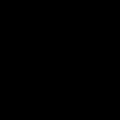

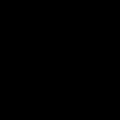

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



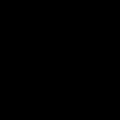

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (5591.809881905049, 2450.4973867989456)
Ship left upper corner current coordinates: (5531.809881905049, 2390.4973867989456)
Ship right lower current coordinates: (5651.809881905049, 2510.4973867989456)
Cropped image size: (120, 120)


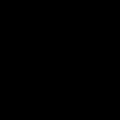

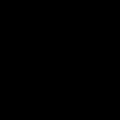

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



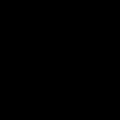

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (1501.041234233827, 1245.4638989617797)
Ship left upper corner current coordinates: (1441.041234233827, 1185.4638989617797)
Ship right lower current coordinates: (1561.041234233827, 1305.4638989617797)
Cropped image size: (120, 120)


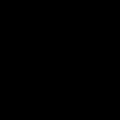

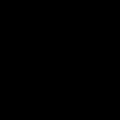

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



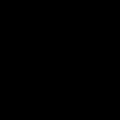

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (3909.1010970758784, 1298.4530972454015)
Ship left upper corner current coordinates: (3849.1010970758784, 1238.4530972454015)
Ship right lower current coordinates: (3969.1010970758784, 1358.4530972454015)
Cropped image size: (120, 120)


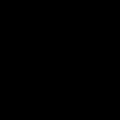

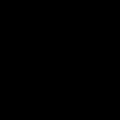

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



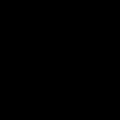

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (5453.109135961266, 2455.6169701804797)
Ship left upper corner current coordinates: (5393.109135961266, 2395.6169701804797)
Ship right lower current coordinates: (5513.109135961266, 2515.6169701804797)
Cropped image size: (120, 120)


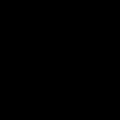

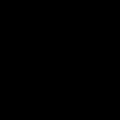

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



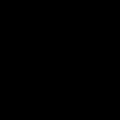

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (2239.195266818154, 694.7608671415755)
Ship left upper corner current coordinates: (2179.195266818154, 634.7608671415755)
Ship right lower current coordinates: (2299.195266818154, 754.7608671415755)
Cropped image size: (120, 120)


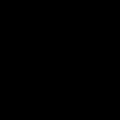

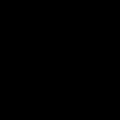

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



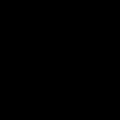

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (5441.644688670184, 2485.1273481263493)
Ship left upper corner current coordinates: (5381.644688670184, 2425.1273481263493)
Ship right lower current coordinates: (5501.644688670184, 2545.1273481263493)
Cropped image size: (120, 120)


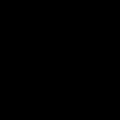

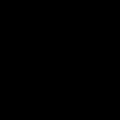

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



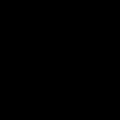

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (3405.3948951834122, 1735.151659791953)
Ship left upper corner current coordinates: (3345.3948951834122, 1675.151659791953)
Ship right lower current coordinates: (3465.3948951834122, 1795.151659791953)
Cropped image size: (120, 120)


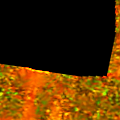

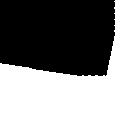

[[0 0 0 ... 1 1 1]
 [0 0 0 ... 1 1 1]
 [0 0 0 ... 1 1 1]
 ...
 [1 1 1 ... 1 1 1]
 [1 1 1 ... 1 1 1]
 [1 1 1 ... 1 1 1]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [ 75 101]
 [ 75 102]
 [ 75 105]]
array shape: (8035, 2)


,R,G,B
0,67,59,2
1,105,110,0
2,117,107,0
3,105,78,0
4,112,83,0
...,...,...,...
6410,184,107,1
6411,181,100,1
6412,178,79,0
6413,187,69,0


mean_pixel_value_from_image: [174, 97, 1]



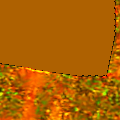

Ship center current coordinates: (60.0, 60.0)
RGB = (174, 97, 1)
Ship Length: (299.0 m), Width: (42.0 m)
50 50


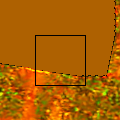

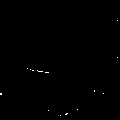

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
Maximum x-axis pixel: 2
Cumulated axis=0 sum px < THRESHOLD (2 < 5) - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (5448.773897418921, 2448.948475111129)
Ship left upper corner current coordinates: (5388.773897418921, 2388.948475111129)
Ship right lower current coordinates: (5508.773897418921, 2508.948475111129)
Cropped image size: (120, 120)


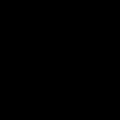

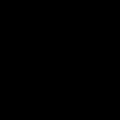

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



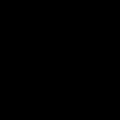

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (5453.773713321395, 2459.0689875900594)
Ship left upper corner current coordinates: (5393.773713321395, 2399.0689875900594)
Ship right lower current coordinates: (5513.773713321395, 2519.0689875900594)
Cropped image size: (120, 120)


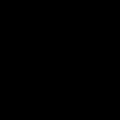

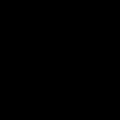

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



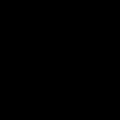

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (3914.113836159582, 1329.0648365474874)
Ship left upper corner current coordinates: (3854.113836159582, 1269.0648365474874)
Ship right lower current coordinates: (3974.113836159582, 1389.0648365474874)
Cropped image size: (120, 120)


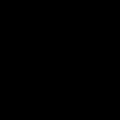

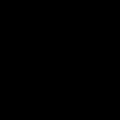

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



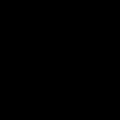

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (5476.119583104959, 2397.064031218141)
Ship left upper corner current coordinates: (5416.119583104959, 2337.064031218141)
Ship right lower current coordinates: (5536.119583104959, 2457.064031218141)
Cropped image size: (120, 120)


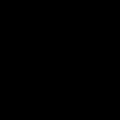

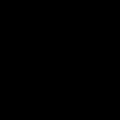

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



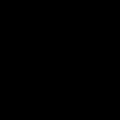

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (5422.944211381478, 2443.706897860536)
Ship left upper corner current coordinates: (5362.944211381478, 2383.706897860536)
Ship right lower current coordinates: (5482.944211381478, 2503.706897860536)
Cropped image size: (120, 120)


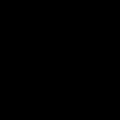

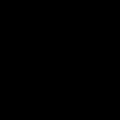

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



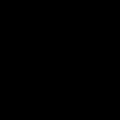

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (3367.3158481368487, 921.9795109782185)
Ship left upper corner current coordinates: (3307.3158481368487, 861.9795109782185)
Ship right lower current coordinates: (3427.3158481368487, 981.9795109782185)
Cropped image size: (120, 120)


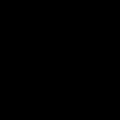

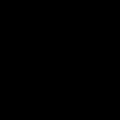

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



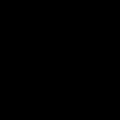

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (1616.3682266955636, 1215.0736779752194)
Ship left upper corner current coordinates: (1556.3682266955636, 1155.0736779752194)
Ship right lower current coordinates: (1676.3682266955636, 1275.0736779752194)
Cropped image size: (120, 120)


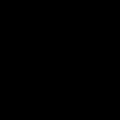

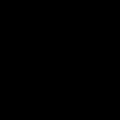

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



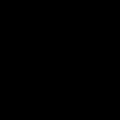

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (5426.0592692225255, 2472.884931774556)
Ship left upper corner current coordinates: (5366.0592692225255, 2412.884931774556)
Ship right lower current coordinates: (5486.0592692225255, 2532.884931774556)
Cropped image size: (120, 120)


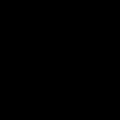

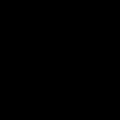

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



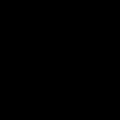

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (3089.690563317447, 1507.2873413075342)
Ship left upper corner current coordinates: (3029.690563317447, 1447.2873413075342)
Ship right lower current coordinates: (3149.690563317447, 1567.2873413075342)
Cropped image size: (120, 120)


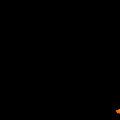

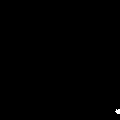

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14381, 2)


,R,G,B
0,25,10,1
1,1,0,0
2,86,40,1
3,246,123,9
4,235,96,7
5,227,122,1
6,250,122,0
7,254,141,0
8,19,13,1
9,154,110,3


mean_pixel_value_from_image: [159, 76, 2]



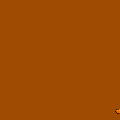

Ship center current coordinates: (60.0, 60.0)
RGB = (159, 76, 2)
Ship Length: (259.0 m), Width: (32.0 m)
50 50


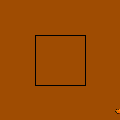

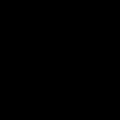

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
Maximum x-axis pixel: 0
Cumulated axis=0 sum px < THRESHOLD (0 < 5) - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (3343.044848390115, 945.1239128015077)
Ship left upper corner current coordinates: (3283.044848390115, 885.1239128015077)
Ship right lower current coordinates: (3403.044848390115, 1005.1239128015077)
Cropped image size: (120, 120)


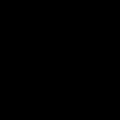

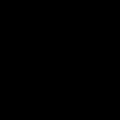

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



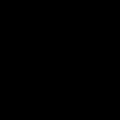

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (5419.821268629427, 2468.520719739823)
Ship left upper corner current coordinates: (5359.821268629427, 2408.520719739823)
Ship right lower current coordinates: (5479.821268629427, 2528.520719739823)
Cropped image size: (120, 120)


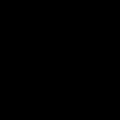

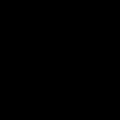

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



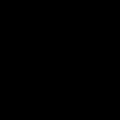

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (2242.0245821006433, 701.8871147685146)
Ship left upper corner current coordinates: (2182.0245821006433, 641.8871147685146)
Ship right lower current coordinates: (2302.0245821006433, 761.8871147685146)
Cropped image size: (120, 120)


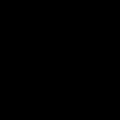

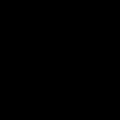

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



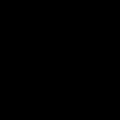

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (5419.153351684614, 2400.4036159419707)
Ship left upper corner current coordinates: (5359.153351684614, 2340.4036159419707)
Ship right lower current coordinates: (5479.153351684614, 2460.4036159419707)
Cropped image size: (120, 120)


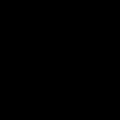

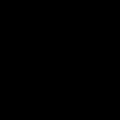

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



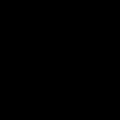

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (5584.122570711254, 2446.7125241119597)
Ship left upper corner current coordinates: (5524.122570711254, 2386.7125241119597)
Ship right lower current coordinates: (5644.122570711254, 2506.7125241119597)
Cropped image size: (120, 120)


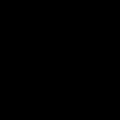

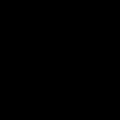

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



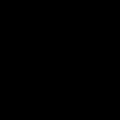

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (5422.597989570199, 2371.4730809936163)
Ship left upper corner current coordinates: (5362.597989570199, 2311.4730809936163)
Ship right lower current coordinates: (5482.597989570199, 2431.4730809936163)
Cropped image size: (120, 120)


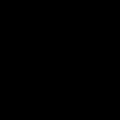

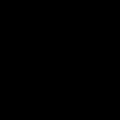

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



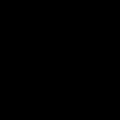

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (2950.0807377852607, 1744.9481460467066)
Ship left upper corner current coordinates: (2890.0807377852607, 1684.9481460467066)
Ship right lower current coordinates: (3010.0807377852607, 1804.9481460467066)
Cropped image size: (120, 120)


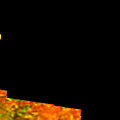

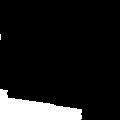

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [1 1 1 ... 0 0 0]
 [1 1 1 ... 0 0 0]
 [1 1 1 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (12916, 2)


,R,G,B
0,245,148,4
1,254,254,1
2,254,254,0
3,254,240,8
4,254,182,12
...,...,...,...
1498,254,187,14
1499,254,175,4
1500,221,112,0
1501,148,54,1


mean_pixel_value_from_image: [193, 103, 1]



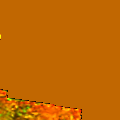

Ship center current coordinates: (60.0, 60.0)
RGB = (193, 103, 1)
Ship Length: (nan m), Width: (nan m)
50 50


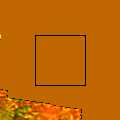

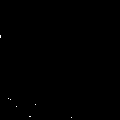

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
Maximum x-axis pixel: 3
Cumulated axis=0 sum px < THRESHOLD (3 < 5) - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (5413.364738163425, 2475.6555917182222)
Ship left upper corner current coordinates: (5353.364738163425, 2415.6555917182222)
Ship right lower current coordinates: (5473.364738163425, 2535.6555917182222)
Cropped image size: (120, 120)


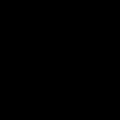

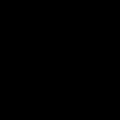

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



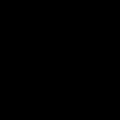

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (5712.2575709433195, 2472.305978211442)
Ship left upper corner current coordinates: (5652.2575709433195, 2412.305978211442)
Ship right lower current coordinates: (5772.2575709433195, 2532.305978211442)
Cropped image size: (120, 120)


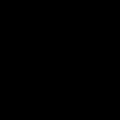

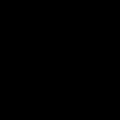

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



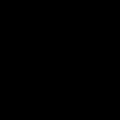

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (3985.0317979147117, 1343.5512625901586)
Ship left upper corner current coordinates: (3925.0317979147117, 1283.5512625901586)
Ship right lower current coordinates: (4045.0317979147117, 1403.5512625901586)
Cropped image size: (120, 120)


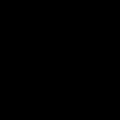

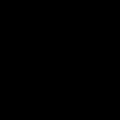

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



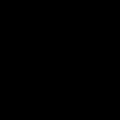

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (3241.113178042875, 1851.0419288772002)
Ship left upper corner current coordinates: (3181.113178042875, 1791.0419288772002)
Ship right lower current coordinates: (3301.113178042875, 1911.0419288772002)
Cropped image size: (120, 120)


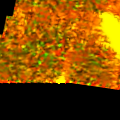

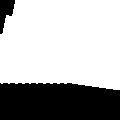

[[0 0 0 ... 1 1 1]
 [0 0 0 ... 1 1 1]
 [0 0 0 ... 1 1 1]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (4509, 2)


,R,G,B
0,25,11,1
1,129,55,1
2,98,67,0
3,79,91,0
4,110,123,0
...,...,...,...
9918,137,33,2
9919,152,31,0
9920,207,44,1
9921,203,75,2


mean_pixel_value_from_image: [185, 110, 1]



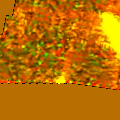

Ship center current coordinates: (60.0, 60.0)
RGB = (189, 72, 0)
Ship Length: (349.0 m), Width: (45.0 m)
50 50


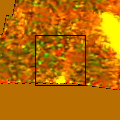

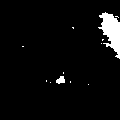

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
Maximum x-axis pixel: 38


0       0
1       0
2       0
3       0
4       0
       ..
115    36
116    37
117    38
118    37
119    37
Length: 120, dtype: int32

Maximum y-axis sum: 38
Maximum x-axis pixel: from 22 to 119
Maximum x-axis pixel: 117
Center x-axis pixel: 70
Maximum y-axis pixel: 117
Maximum y-axis pixel: 24


0      0
1      0
2      0
3      0
4      0
      ..
115    0
116    0
117    0
118    0
119    0
Length: 120, dtype: int32

Maximum x-axis sum: 24
Maximum x-axis pixel: from 12 to 84
Maximum x-axis pixel: 27
Center x-axis pixel: 48
Ship center current coordinates: (48, 70)


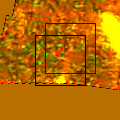

Ship center current coordinates: (70, 48)
tagging_length = 97, tagging_width = 72
More than 1 ship on the picture - TEMPORARILY not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (5460.889314149972, 2436.5559107036356)
Ship left upper corner current coordinates: (5400.889314149972, 2376.5559107036356)
Ship right lower current coordinates: (5520.889314149972, 2496.5559107036356)
Cropped image size: (120, 120)


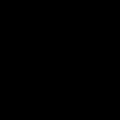

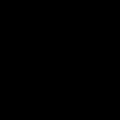

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



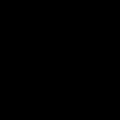

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (1510.109419974838, 1245.5839239701124)
Ship left upper corner current coordinates: (1450.109419974838, 1185.5839239701124)
Ship right lower current coordinates: (1570.109419974838, 1305.5839239701124)
Cropped image size: (120, 120)


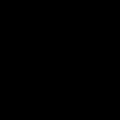

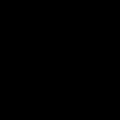

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



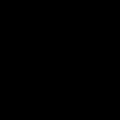

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (1561.2650787529622, 945.4222490368398)
Ship left upper corner current coordinates: (1501.2650787529622, 885.4222490368398)
Ship right lower current coordinates: (1621.2650787529622, 1005.4222490368398)
Cropped image size: (120, 120)


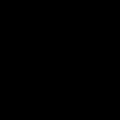

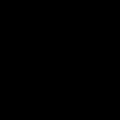

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



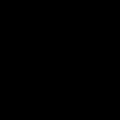

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (4176.519479442187, 2458.9320646163656)
Ship left upper corner current coordinates: (4116.519479442187, 2398.9320646163656)
Ship right lower current coordinates: (4236.519479442187, 2518.9320646163656)
Cropped image size: (120, 120)


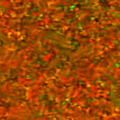

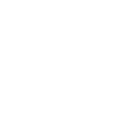

[[1 1 1 ... 1 1 1]
 [1 1 1 ... 1 1 1]
 [1 1 1 ... 1 1 1]
 ...
 [1 1 1 ... 1 1 1]
 [1 1 1 ... 1 1 1]
 [1 1 1 ... 1 1 1]]
black pixels cordinates: []
array shape: (0, 2)


,R,G,B
0,146,67,0
1,147,66,0
2,152,64,0
3,168,63,0
4,178,60,0
...,...,...,...
14395,155,45,0
14396,163,50,0
14397,167,53,0
14398,171,57,0


mean_pixel_value_from_image: [154, 71, 1]



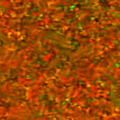

Ship center current coordinates: (60.0, 60.0)
RGB = (118, 61, 0)
Ship Length: (nan m), Width: (nan m)
50 50


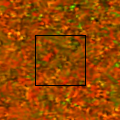

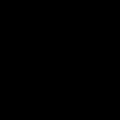

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
Maximum x-axis pixel: 0
Cumulated axis=0 sum px < THRESHOLD (0 < 5) - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (3788.5632616633548, 1189.1451421796685)
Ship left upper corner current coordinates: (3728.5632616633548, 1129.1451421796685)
Ship right lower current coordinates: (3848.5632616633548, 1249.1451421796685)
Cropped image size: (120, 120)


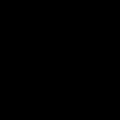

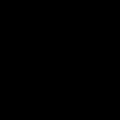

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



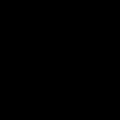

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (3364.622276355644, 900.6888827264747)
Ship left upper corner current coordinates: (3304.622276355644, 840.6888827264747)
Ship right lower current coordinates: (3424.622276355644, 960.6888827264747)
Cropped image size: (120, 120)


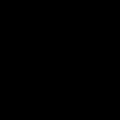

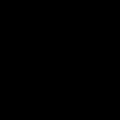

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



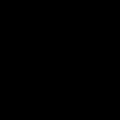

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (5655.7103687152785, 2424.0002488951855)
Ship left upper corner current coordinates: (5595.7103687152785, 2364.0002488951855)
Ship right lower current coordinates: (5715.7103687152785, 2484.0002488951855)
Cropped image size: (120, 120)


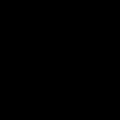

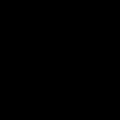

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



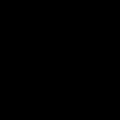

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (5567.876191384492, 2437.381724393702)
Ship left upper corner current coordinates: (5507.876191384492, 2377.381724393702)
Ship right lower current coordinates: (5627.876191384492, 2497.381724393702)
Cropped image size: (120, 120)


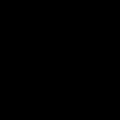

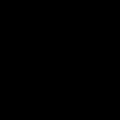

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



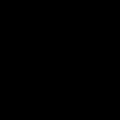

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (1497.5903300192474, 1221.7528474228004)
Ship left upper corner current coordinates: (1437.5903300192474, 1161.7528474228004)
Ship right lower current coordinates: (1557.5903300192474, 1281.7528474228004)
Cropped image size: (120, 120)


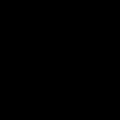

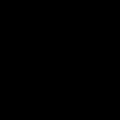

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



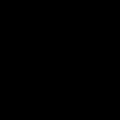

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (2253.4393172040304, 698.0049985419462)
Ship left upper corner current coordinates: (2193.4393172040304, 638.0049985419462)
Ship right lower current coordinates: (2313.4393172040304, 758.0049985419462)
Cropped image size: (120, 120)


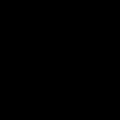

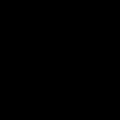

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



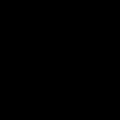

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (2553.4452406439277, 839.0155189766367)
Ship left upper corner current coordinates: (2493.4452406439277, 779.0155189766367)
Ship right lower current coordinates: (2613.4452406439277, 899.0155189766367)
Cropped image size: (120, 120)


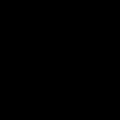

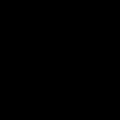

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



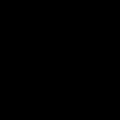

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (2189.7073102555833, 711.8098403142843)
Ship left upper corner current coordinates: (2129.7073102555833, 651.8098403142843)
Ship right lower current coordinates: (2249.7073102555833, 771.8098403142843)
Cropped image size: (120, 120)


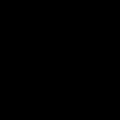

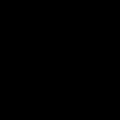

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



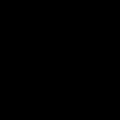

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (1470.7851864084316, 1271.1016623496375)
Ship left upper corner current coordinates: (1410.7851864084316, 1211.1016623496375)
Ship right lower current coordinates: (1530.7851864084316, 1331.1016623496375)
Cropped image size: (120, 120)


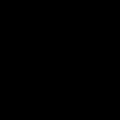

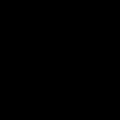

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



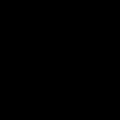

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (2453.1151407177945, 1002.5230717800708)
Ship left upper corner current coordinates: (2393.1151407177945, 942.5230717800708)
Ship right lower current coordinates: (2513.1151407177945, 1062.523071780071)
Cropped image size: (120, 120)


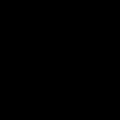

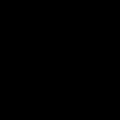

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



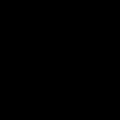

Ship center current coordinates: (60.0, 60.00000000000006)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (2372.139332662541, 1651.135206383759)
Ship left upper corner current coordinates: (2312.139332662541, 1591.135206383759)
Ship right lower current coordinates: (2432.139332662541, 1711.135206383759)
Cropped image size: (120, 120)


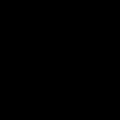

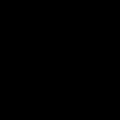

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



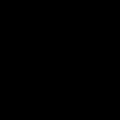

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (5701.854969296934, 2546.1707183929157)
Ship left upper corner current coordinates: (5641.854969296934, 2486.1707183929157)
Ship right lower current coordinates: (5761.854969296934, 2606.1707183929157)
Cropped image size: (120, 120)


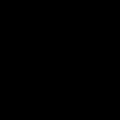

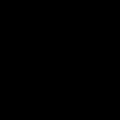

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



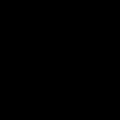

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (3912.5967528882343, 1309.8764945312796)
Ship left upper corner current coordinates: (3852.5967528882343, 1249.8764945312796)
Ship right lower current coordinates: (3972.5967528882343, 1369.8764945312796)
Cropped image size: (120, 120)


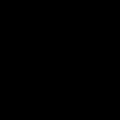

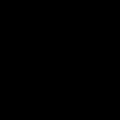

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



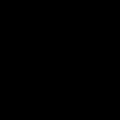

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (5455.220866701693, 2481.6167319585866)
Ship left upper corner current coordinates: (5395.220866701693, 2421.6167319585866)
Ship right lower current coordinates: (5515.220866701693, 2541.6167319585866)
Cropped image size: (120, 120)


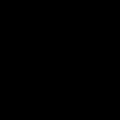

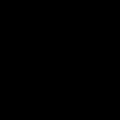

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



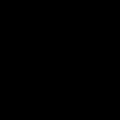

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (3825.924309163381, 2278.4597929473557)
Ship left upper corner current coordinates: (3765.924309163381, 2218.4597929473557)
Ship right lower current coordinates: (3885.924309163381, 2338.4597929473557)
Cropped image size: (120, 120)


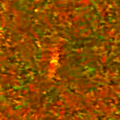

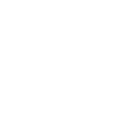

[[1 1 1 ... 1 1 1]
 [1 1 1 ... 1 1 1]
 [1 1 1 ... 1 1 1]
 ...
 [1 1 1 ... 1 1 1]
 [1 1 1 ... 1 1 1]
 [1 1 1 ... 1 1 1]]
black pixels cordinates: []
array shape: (0, 2)


,R,G,B
0,130,44,0
1,126,39,0
2,126,53,0
3,126,72,0
4,129,78,0
...,...,...,...
14395,126,91,0
14396,123,83,0
14397,129,74,0
14398,146,76,1


mean_pixel_value_from_image: [139, 75, 1]



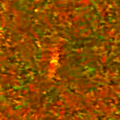

Ship center current coordinates: (60.0, 60.0)
RGB = (118, 43, 0)
Ship Length: (294.0 m), Width: (32.0 m)
50 50


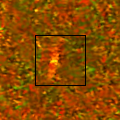

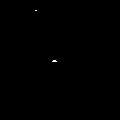

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
Maximum x-axis pixel: 2
Cumulated axis=0 sum px < THRESHOLD (2 < 5) - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (3245.5165230261996, 742.95526609208)
Ship left upper corner current coordinates: (3185.5165230261996, 682.95526609208)
Ship right lower current coordinates: (3305.5165230261996, 802.95526609208)
Cropped image size: (120, 120)


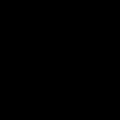

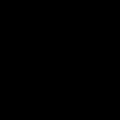

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



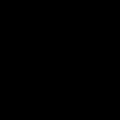

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (1592.002245485743, 1092.4589695161076)
Ship left upper corner current coordinates: (1532.002245485743, 1032.4589695161076)
Ship right lower current coordinates: (1652.002245485743, 1152.4589695161076)
Cropped image size: (120, 120)


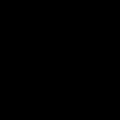

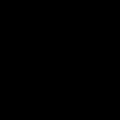

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



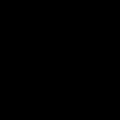

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (1522.4279348050104, 1257.9183235917358)
Ship left upper corner current coordinates: (1462.4279348050104, 1197.9183235917358)
Ship right lower current coordinates: (1582.4279348050104, 1317.9183235917358)
Cropped image size: (120, 120)


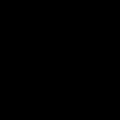

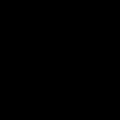

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



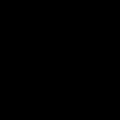

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (1812.082065731, 741.9658421037626)
Ship left upper corner current coordinates: (1752.082065731, 681.9658421037626)
Ship right lower current coordinates: (1872.082065731, 801.9658421037626)
Cropped image size: (120, 120)


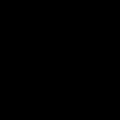

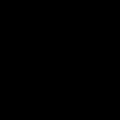

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



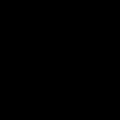

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (5563.771793680675, 2437.235943938958)
Ship left upper corner current coordinates: (5503.771793680675, 2377.235943938958)
Ship right lower current coordinates: (5623.771793680675, 2497.235943938958)
Cropped image size: (120, 120)


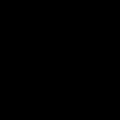

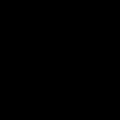

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



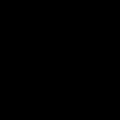

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (3969.884901046997, 1271.5126598073687)
Ship left upper corner current coordinates: (3909.884901046997, 1211.5126598073687)
Ship right lower current coordinates: (4029.884901046997, 1331.5126598073687)
Cropped image size: (120, 120)


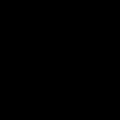

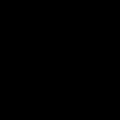

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



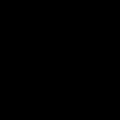

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (1566.163136347839, 1006.7236962119279)
Ship left upper corner current coordinates: (1506.163136347839, 946.7236962119279)
Ship right lower current coordinates: (1626.163136347839, 1066.7236962119277)
Cropped image size: (120, 120)


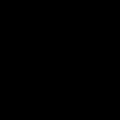

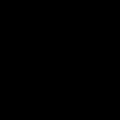

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



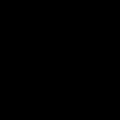

Ship center current coordinates: (60.0, 59.99999999999994)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (1552.6934779618487, 1248.8344467226555)
Ship left upper corner current coordinates: (1492.6934779618487, 1188.8344467226555)
Ship right lower current coordinates: (1612.6934779618487, 1308.8344467226555)
Cropped image size: (120, 120)


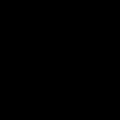

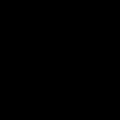

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



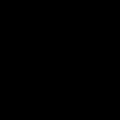

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (3123.171042954801, 1920.4741216747134)
Ship left upper corner current coordinates: (3063.171042954801, 1860.4741216747134)
Ship right lower current coordinates: (3183.171042954801, 1980.4741216747134)
Cropped image size: (120, 120)


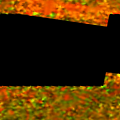

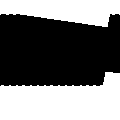

[[1 1 1 ... 1 1 1]
 [1 1 1 ... 1 1 1]
 [1 1 1 ... 1 1 1]
 ...
 [1 1 1 ... 1 1 1]
 [1 1 1 ... 1 1 1]
 [1 1 1 ... 1 1 1]]
black pixels cordinates: [[14  1]
 [14  2]
 [14  3]
 ...
 [85 97]
 [85 98]
 [85 99]]
array shape: (7756, 2)


,R,G,B
0,99,99,0
1,97,79,0
2,103,57,0
3,108,45,0
4,111,45,0
...,...,...,...
6693,219,101,3
6694,213,101,2
6695,183,101,2
6696,150,93,0


mean_pixel_value_from_image: [152, 90, 1]



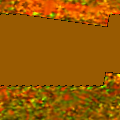

Ship center current coordinates: (60.0, 60.0)
RGB = (152, 90, 1)
Ship Length: (294.0 m), Width: (32.0 m)
50 50


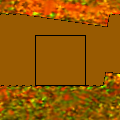

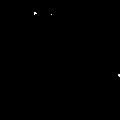

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
Maximum x-axis pixel: 3
Cumulated axis=0 sum px < THRESHOLD (3 < 5) - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (2249.553490327778, 690.9815153204751)
Ship left upper corner current coordinates: (2189.553490327778, 630.9815153204751)
Ship right lower current coordinates: (2309.553490327778, 750.9815153204751)
Cropped image size: (120, 120)


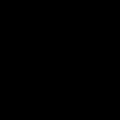

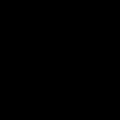

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



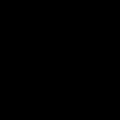

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (5769.26794351714, 2489.347889085791)
Ship left upper corner current coordinates: (5709.26794351714, 2429.347889085791)
Ship right lower current coordinates: (5829.26794351714, 2549.347889085791)
Cropped image size: (120, 120)


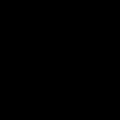

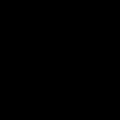

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



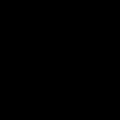

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (2153.117746105421, 680.0391400274374)
Ship left upper corner current coordinates: (2093.117746105421, 620.0391400274374)
Ship right lower current coordinates: (2213.117746105421, 740.0391400274374)
Cropped image size: (120, 120)


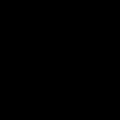

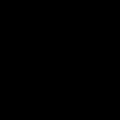

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



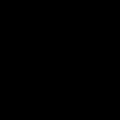

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (1942.0890567567692, 906.6073689870694)
Ship left upper corner current coordinates: (1882.0890567567692, 846.6073689870694)
Ship right lower current coordinates: (2002.0890567567692, 966.6073689870694)
Cropped image size: (120, 120)


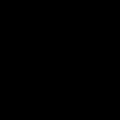

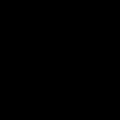

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



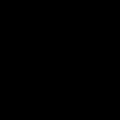

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (1503.845767211429, 1289.0005927158413)
Ship left upper corner current coordinates: (1443.845767211429, 1229.0005927158413)
Ship right lower current coordinates: (1563.845767211429, 1349.0005927158413)
Cropped image size: (120, 120)


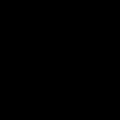

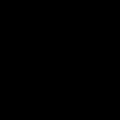

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



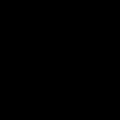

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (5768.640893030134, 2483.203053194013)
Ship left upper corner current coordinates: (5708.640893030134, 2423.203053194013)
Ship right lower current coordinates: (5828.640893030134, 2543.203053194013)
Cropped image size: (120, 120)


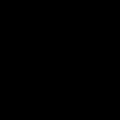

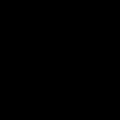

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



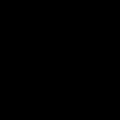

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (2194.895620348333, 1459.7198941768543)
Ship left upper corner current coordinates: (2134.895620348333, 1399.7198941768543)
Ship right lower current coordinates: (2254.895620348333, 1519.7198941768543)
Cropped image size: (120, 120)


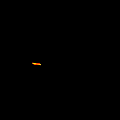

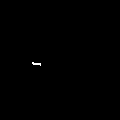

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14380, 2)


,R,G,B
0,79,16,6
1,48,5,1
2,204,91,20
3,254,234,3
4,254,253,0
5,254,208,3
6,246,107,0
7,247,74,0
8,251,57,1
9,233,40,4


mean_pixel_value_from_image: [180, 92, 4]



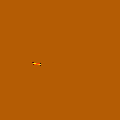

Ship center current coordinates: (60.0, 60.0)
RGB = (180, 92, 4)
Ship Length: (nan m), Width: (nan m)
50 50


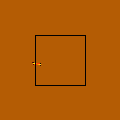

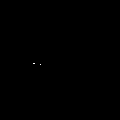

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
Maximum x-axis pixel: 1
Cumulated axis=0 sum px < THRESHOLD (1 < 5) - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (1483.9752141652748, 1219.7490965885181)
Ship left upper corner current coordinates: (1423.9752141652748, 1159.7490965885181)
Ship right lower current coordinates: (1543.9752141652748, 1279.7490965885181)
Cropped image size: (120, 120)


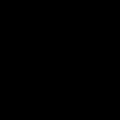

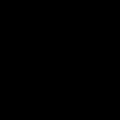

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



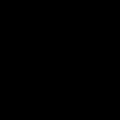

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (1515.6585965697825, 1282.1570295170718)
Ship left upper corner current coordinates: (1455.6585965697825, 1222.1570295170718)
Ship right lower current coordinates: (1575.6585965697825, 1342.1570295170718)
Cropped image size: (120, 120)


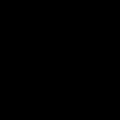

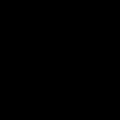

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



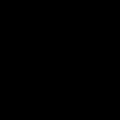

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (5762.124336508944, 2492.0195568648073)
Ship left upper corner current coordinates: (5702.124336508944, 2432.0195568648073)
Ship right lower current coordinates: (5822.124336508944, 2552.0195568648073)
Cropped image size: (120, 120)


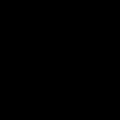

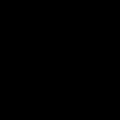

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



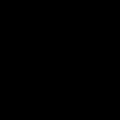

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (2694.604361739443, 1161.5646251407397)
Ship left upper corner current coordinates: (2634.604361739443, 1101.5646251407397)
Ship right lower current coordinates: (2754.604361739443, 1221.5646251407397)
Cropped image size: (120, 120)


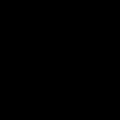

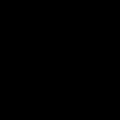

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



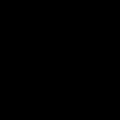

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (5572.533427814451, 2440.6081343017822)
Ship left upper corner current coordinates: (5512.533427814451, 2380.6081343017822)
Ship right lower current coordinates: (5632.533427814451, 2500.6081343017822)
Cropped image size: (120, 120)


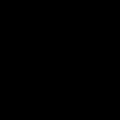

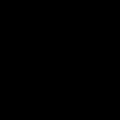

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



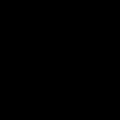

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (1475.1037928789874, 1213.6265245949223)
Ship left upper corner current coordinates: (1415.1037928789874, 1153.6265245949223)
Ship right lower current coordinates: (1535.1037928789874, 1273.6265245949223)
Cropped image size: (120, 120)


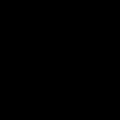

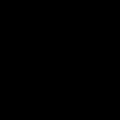

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



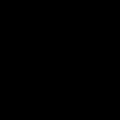

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (3383.899101511242, 915.5129282505106)
Ship left upper corner current coordinates: (3323.899101511242, 855.5129282505106)
Ship right lower current coordinates: (3443.899101511242, 975.5129282505106)
Cropped image size: (120, 120)


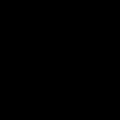

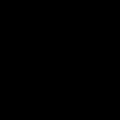

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



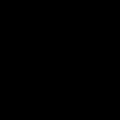

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (2527.0265436855093, 850.502345627248)
Ship left upper corner current coordinates: (2467.0265436855093, 790.502345627248)
Ship right lower current coordinates: (2587.0265436855093, 910.502345627248)
Cropped image size: (120, 120)


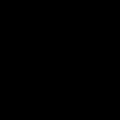

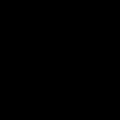

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



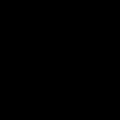

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (3015.209687668495, 1420.27211289455)
Ship left upper corner current coordinates: (2955.209687668495, 1360.27211289455)
Ship right lower current coordinates: (3075.209687668495, 1480.27211289455)
Cropped image size: (120, 120)


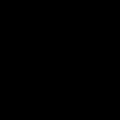

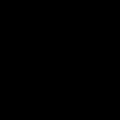

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



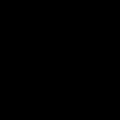

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (3908.659181110721, 1226.0943075637715)
Ship left upper corner current coordinates: (3848.659181110721, 1166.0943075637715)
Ship right lower current coordinates: (3968.659181110721, 1286.0943075637715)
Cropped image size: (120, 120)


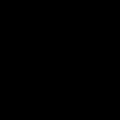

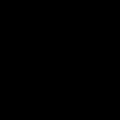

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



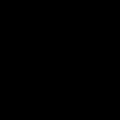

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (5771.293636495652, 2484.672470472492)
Ship left upper corner current coordinates: (5711.293636495652, 2424.672470472492)
Ship right lower current coordinates: (5831.293636495652, 2544.672470472492)
Cropped image size: (120, 120)


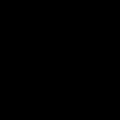

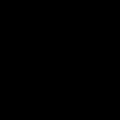

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



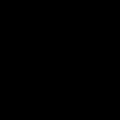

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (3118.142370490835, 1697.4210315824453)
Ship left upper corner current coordinates: (3058.142370490835, 1637.4210315824453)
Ship right lower current coordinates: (3178.142370490835, 1757.4210315824453)
Cropped image size: (120, 120)


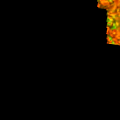

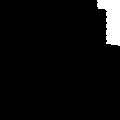

[[0 0 0 ... 1 1 1]
 [0 0 0 ... 1 1 1]
 [0 0 0 ... 1 1 1]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (13704, 2)


,R,G,B
0,91,90,5
1,122,117,1
2,144,97,0
3,254,126,2
4,248,113,1
...,...,...,...
703,199,105,1
704,209,86,0
705,2,0,0
706,27,10,0


mean_pixel_value_from_image: [177, 102, 1]



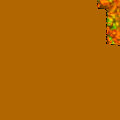

Ship center current coordinates: (60.0, 60.0)
RGB = (177, 102, 1)
Ship Length: (222.0 m), Width: (30.0 m)
50 50


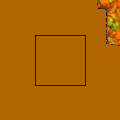

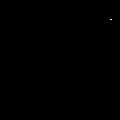

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
Maximum x-axis pixel: 1
Cumulated axis=0 sum px < THRESHOLD (1 < 5) - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (3339.296220570911, 942.6722691166669)
Ship left upper corner current coordinates: (3279.296220570911, 882.6722691166669)
Ship right lower current coordinates: (3399.296220570911, 1002.6722691166669)
Cropped image size: (120, 120)


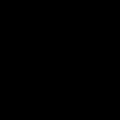

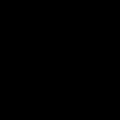

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



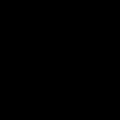

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (3300.854761379519, 901.2257221756397)
Ship left upper corner current coordinates: (3240.854761379519, 841.2257221756397)
Ship right lower current coordinates: (3360.854761379519, 961.2257221756397)
Cropped image size: (120, 120)


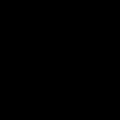

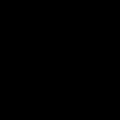

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



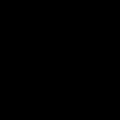

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (2207.7340972215056, 1075.4389615037603)
Ship left upper corner current coordinates: (2147.7340972215056, 1015.4389615037603)
Ship right lower current coordinates: (2267.7340972215056, 1135.4389615037603)
Cropped image size: (120, 120)


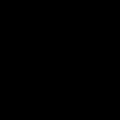

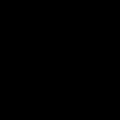

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



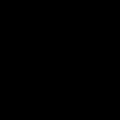

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (2047.693905286502, 877.0703556937431)
Ship left upper corner current coordinates: (1987.693905286502, 817.0703556937431)
Ship right lower current coordinates: (2107.693905286502, 937.0703556937431)
Cropped image size: (120, 120)


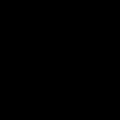

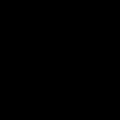

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



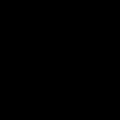

Ship center current coordinates: (59.999999999999886, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (5770.960172570689, 2487.6408667444766)
Ship left upper corner current coordinates: (5710.960172570689, 2427.6408667444766)
Ship right lower current coordinates: (5830.960172570689, 2547.6408667444766)
Cropped image size: (120, 120)


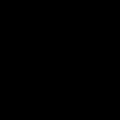

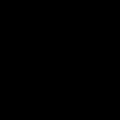

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



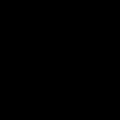

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (2429.185795416518, 1191.919223890225)
Ship left upper corner current coordinates: (2369.185795416518, 1131.919223890225)
Ship right lower current coordinates: (2489.185795416518, 1251.919223890225)
Cropped image size: (120, 120)


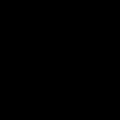

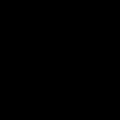

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



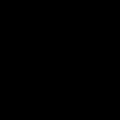

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (5447.317182855392, 2383.4217720235256)
Ship left upper corner current coordinates: (5387.317182855392, 2323.4217720235256)
Ship right lower current coordinates: (5507.317182855392, 2443.4217720235256)
Cropped image size: (120, 120)


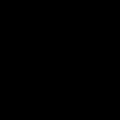

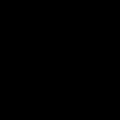

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



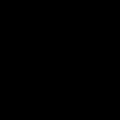

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (1514.3632692683877, 1256.9298065134878)
Ship left upper corner current coordinates: (1454.3632692683877, 1196.9298065134878)
Ship right lower current coordinates: (1574.3632692683877, 1316.9298065134878)
Cropped image size: (120, 120)


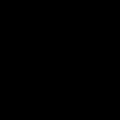

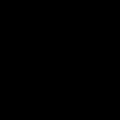

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



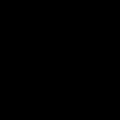

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (1929.320711162746, 761.0793986729599)
Ship left upper corner current coordinates: (1869.320711162746, 701.0793986729599)
Ship right lower current coordinates: (1989.320711162746, 821.0793986729599)
Cropped image size: (120, 120)


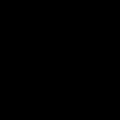

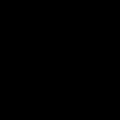

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



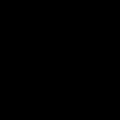

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (5629.625373541508, 2538.885062488781)
Ship left upper corner current coordinates: (5569.625373541508, 2478.885062488781)
Ship right lower current coordinates: (5689.625373541508, 2598.885062488781)
Cropped image size: (120, 120)


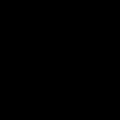

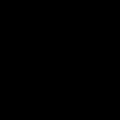

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



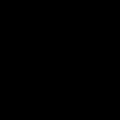

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (3347.3863085310068, 938.536276822264)
Ship left upper corner current coordinates: (3287.3863085310068, 878.536276822264)
Ship right lower current coordinates: (3407.3863085310068, 998.536276822264)
Cropped image size: (120, 120)


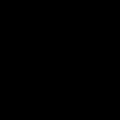

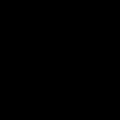

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



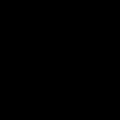

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (5416.1892847097115, 2397.509309181376)
Ship left upper corner current coordinates: (5356.1892847097115, 2337.509309181376)
Ship right lower current coordinates: (5476.1892847097115, 2457.509309181376)
Cropped image size: (120, 120)


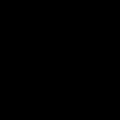

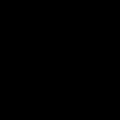

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



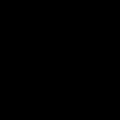

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (2883.2953514138194, 1824.4770166592266)
Ship left upper corner current coordinates: (2823.2953514138194, 1764.4770166592266)
Ship right lower current coordinates: (2943.2953514138194, 1884.4770166592266)
Cropped image size: (120, 120)


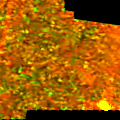

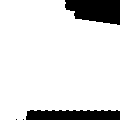

[[1 1 1 ... 0 0 0]
 [1 1 1 ... 0 0 0]
 [1 1 1 ... 0 0 0]
 ...
 [1 1 1 ... 0 0 0]
 [1 1 1 ... 0 0 0]
 [1 1 1 ... 0 0 0]]
black pixels cordinates: [[  0  65]
 [  0  66]
 [  0  67]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (1965, 2)


,R,G,B
0,191,108,0
1,213,103,0
2,220,99,1
3,243,117,2
4,254,135,5
...,...,...,...
12463,40,50,1
12464,50,54,3
12465,55,55,6
12466,2,3,0


mean_pixel_value_from_image: [178, 104, 1]



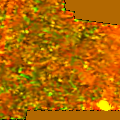

Ship center current coordinates: (60.0, 60.0)
RGB = (176, 121, 0)
Ship Length: (nan m), Width: (nan m)
50 50


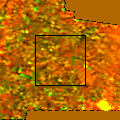

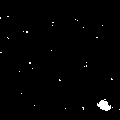

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
Maximum x-axis pixel: 11


0      3
1      1
2      0
3      0
4      0
      ..
115    0
116    0
117    0
118    0
119    1
Length: 120, dtype: int32

Maximum y-axis sum: 11
Maximum x-axis pixel: from 0 to 119
Maximum x-axis pixel: 102
Center x-axis pixel: 60
Maximum y-axis pixel: 102
Maximum y-axis pixel: 14


0      0
1      0
2      0
3      0
4      0
      ..
115    0
116    0
117    0
118    0
119    0
Length: 120, dtype: int32

Maximum x-axis sum: 14
Maximum x-axis pixel: from 16 to 110
Maximum x-axis pixel: 105
Center x-axis pixel: 63
Ship center current coordinates: (63, 60)


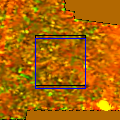

Ship center current coordinates: (60, 63)
tagging_length = 119, tagging_width = 94
More than 1 ship on the picture - TEMPORARILY not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (2107.8734637453576, 704.5216760506147)
Ship left upper corner current coordinates: (2047.8734637453576, 644.5216760506147)
Ship right lower current coordinates: (2167.8734637453576, 764.5216760506147)
Cropped image size: (120, 120)


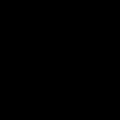

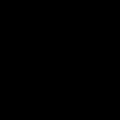

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



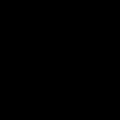

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (2244.57501463926, 700.8889500010573)
Ship left upper corner current coordinates: (2184.57501463926, 640.8889500010573)
Ship right lower current coordinates: (2304.57501463926, 760.8889500010573)
Cropped image size: (120, 120)


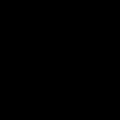

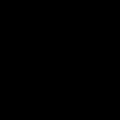

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



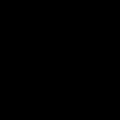

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (3373.2819116877236, 893.9445901316212)
Ship left upper corner current coordinates: (3313.2819116877236, 833.9445901316212)
Ship right lower current coordinates: (3433.2819116877236, 953.9445901316212)
Cropped image size: (120, 120)


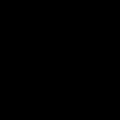

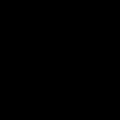

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



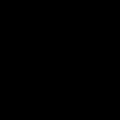

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (2555.014173064505, 836.8100482596795)
Ship left upper corner current coordinates: (2495.014173064505, 776.8100482596795)
Ship right lower current coordinates: (2615.014173064505, 896.8100482596795)
Cropped image size: (120, 120)


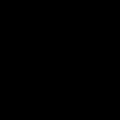

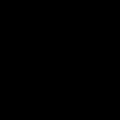

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



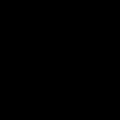

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (2511.5583834435897, 826.457335615862)
Ship left upper corner current coordinates: (2451.5583834435897, 766.457335615862)
Ship right lower current coordinates: (2571.5583834435897, 886.457335615862)
Cropped image size: (120, 120)


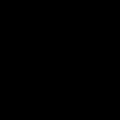

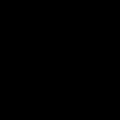

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



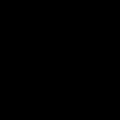

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (5776.231897338414, 2484.4154506798864)
Ship left upper corner current coordinates: (5716.231897338414, 2424.4154506798864)
Ship right lower current coordinates: (5836.231897338414, 2544.4154506798864)
Cropped image size: (120, 120)


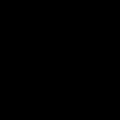

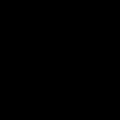

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



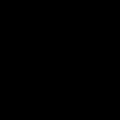

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (2353.4999201810074, 1165.9817825353857)
Ship left upper corner current coordinates: (2293.4999201810074, 1105.9817825353857)
Ship right lower current coordinates: (2413.4999201810074, 1225.9817825353857)
Cropped image size: (120, 120)


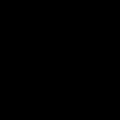

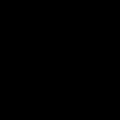

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



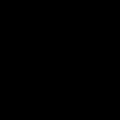

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (2531.4144410162753, 929.3165451088286)
Ship left upper corner current coordinates: (2471.4144410162753, 869.3165451088286)
Ship right lower current coordinates: (2591.4144410162753, 989.3165451088286)
Cropped image size: (120, 120)


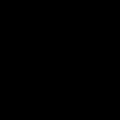

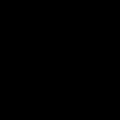

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



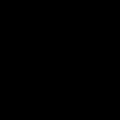

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (2509.7071403116574, 1077.0090323124466)
Ship left upper corner current coordinates: (2449.7071403116574, 1017.0090323124466)
Ship right lower current coordinates: (2569.7071403116574, 1137.0090323124466)
Cropped image size: (120, 120)


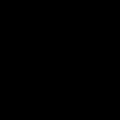

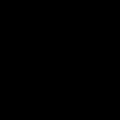

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



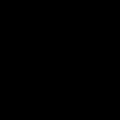

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (3273.3588471535536, 1504.2169944218788)
Ship left upper corner current coordinates: (3213.3588471535536, 1444.2169944218788)
Ship right lower current coordinates: (3333.3588471535536, 1564.2169944218788)
Cropped image size: (120, 120)


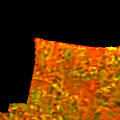

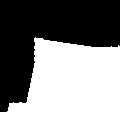

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [1 1 1 ... 1 1 1]
 [1 1 1 ... 1 1 1]
 [1 1 1 ... 1 1 1]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [111   4]
 [111   5]
 [111   6]]
array shape: (7204, 2)


,R,G,B
0,1,0,0
1,117,4,5
2,94,3,3
3,252,26,4
4,253,34,3
...,...,...,...
7237,209,98,0
7238,198,83,0
7239,186,75,0
7240,181,79,0


mean_pixel_value_from_image: [190, 98, 1]



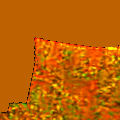

Ship center current coordinates: (60.0, 60.0)
RGB = (254, 114, 2)
Ship Length: (nan m), Width: (nan m)
50 50


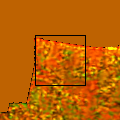

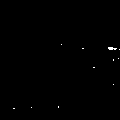

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
Maximum x-axis pixel: 4
Cumulated axis=0 sum px < THRESHOLD (4 < 5) - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (2946.662116222993, 1100.6205435160603)
Ship left upper corner current coordinates: (2886.662116222993, 1040.6205435160603)
Ship right lower current coordinates: (3006.662116222993, 1160.6205435160603)
Cropped image size: (120, 120)


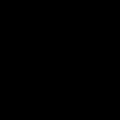

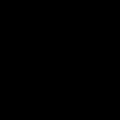

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



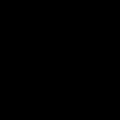

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (49.128729954509495, 65.15628220754863)
Ship left upper corner current coordinates: (-10.871270045490505, 5.156282207548628)
Ship right lower current coordinates: (109.1287299545095, 125.15628220754863)
Cropped image size: (120, 120)


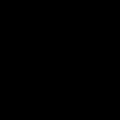

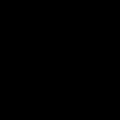

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



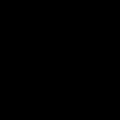

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (1470.2057352841107, 1218.3686611811177)
Ship left upper corner current coordinates: (1410.2057352841107, 1158.3686611811177)
Ship right lower current coordinates: (1530.2057352841107, 1278.3686611811177)
Cropped image size: (120, 120)


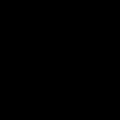

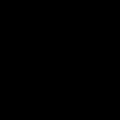

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



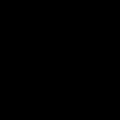

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (5597.06149907865, 2450.8313452713523)
Ship left upper corner current coordinates: (5537.06149907865, 2390.8313452713523)
Ship right lower current coordinates: (5657.06149907865, 2510.8313452713523)
Cropped image size: (120, 120)


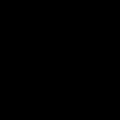

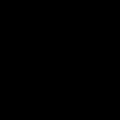

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



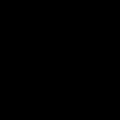

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (2937.9532213934226, 1516.8797418292074)
Ship left upper corner current coordinates: (2877.9532213934226, 1456.8797418292074)
Ship right lower current coordinates: (2997.9532213934226, 1576.8797418292074)
Cropped image size: (120, 120)


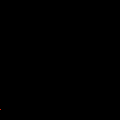

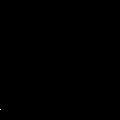

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14399, 2)


,R,G,B
0,197,35,11


mean_pixel_value_from_image: [197, 35, 11]



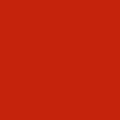

Ship center current coordinates: (60.0, 60.0)
RGB = (197, 35, 11)
Ship Length: (334.0 m), Width: (45.0 m)
50 50


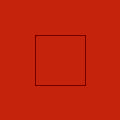

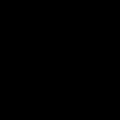

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
Maximum x-axis pixel: 0
Cumulated axis=0 sum px < THRESHOLD (0 < 5) - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (1493.0940546924935, 1260.6468454045996)
Ship left upper corner current coordinates: (1433.0940546924935, 1200.6468454045996)
Ship right lower current coordinates: (1553.0940546924935, 1320.6468454045996)
Cropped image size: (120, 120)


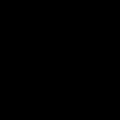

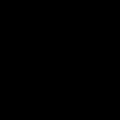

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



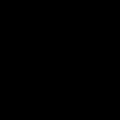

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (1477.2188632040982, 1216.8994665466219)
Ship left upper corner current coordinates: (1417.2188632040982, 1156.8994665466219)
Ship right lower current coordinates: (1537.2188632040982, 1276.8994665466219)
Cropped image size: (120, 120)


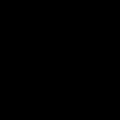

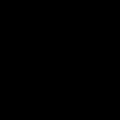

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



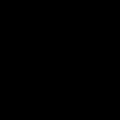

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (5424.673946398474, 2470.967763111751)
Ship left upper corner current coordinates: (5364.673946398474, 2410.967763111751)
Ship right lower current coordinates: (5484.673946398474, 2530.967763111751)
Cropped image size: (120, 120)


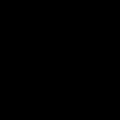

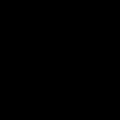

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



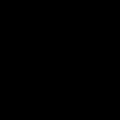

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (2519.30844639254, 829.2681527584143)
Ship left upper corner current coordinates: (2459.30844639254, 769.2681527584143)
Ship right lower current coordinates: (2579.30844639254, 889.2681527584143)
Cropped image size: (120, 120)


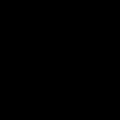

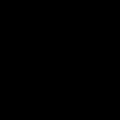

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



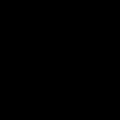

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (3343.693597740182, 941.227730623772)
Ship left upper corner current coordinates: (3283.693597740182, 881.227730623772)
Ship right lower current coordinates: (3403.693597740182, 1001.227730623772)
Cropped image size: (120, 120)


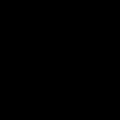

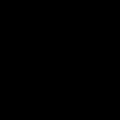

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



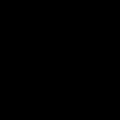

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (2248.7265455391275, 691.2518626552203)
Ship left upper corner current coordinates: (2188.7265455391275, 631.2518626552203)
Ship right lower current coordinates: (2308.7265455391275, 751.2518626552203)
Cropped image size: (120, 120)


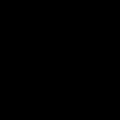

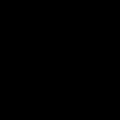

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



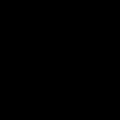

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (2210.3690295686056, 962.4416751797974)
Ship left upper corner current coordinates: (2150.3690295686056, 902.4416751797974)
Ship right lower current coordinates: (2270.3690295686056, 1022.4416751797974)
Cropped image size: (120, 120)


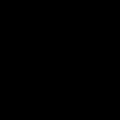

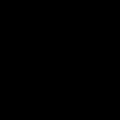

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



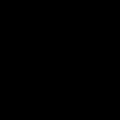

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (5677.191931343382, 2432.2409903088283)
Ship left upper corner current coordinates: (5617.191931343382, 2372.2409903088283)
Ship right lower current coordinates: (5737.191931343382, 2492.2409903088283)
Cropped image size: (120, 120)


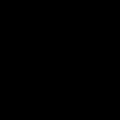

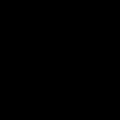

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



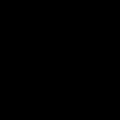

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (5573.727724618006, 2441.098149793765)
Ship left upper corner current coordinates: (5513.727724618006, 2381.098149793765)
Ship right lower current coordinates: (5633.727724618006, 2501.098149793765)
Cropped image size: (120, 120)


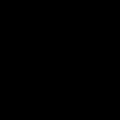

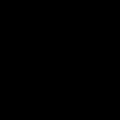

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



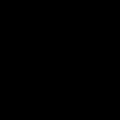

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (2932.5319621917147, 1949.8453982555557)
Ship left upper corner current coordinates: (2872.5319621917147, 1889.8453982555557)
Ship right lower current coordinates: (2992.5319621917147, 2009.8453982555557)
Cropped image size: (120, 120)


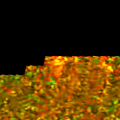

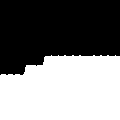

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [1 1 1 ... 1 1 1]
 [1 1 1 ... 1 1 1]
 [1 1 1 ... 1 1 1]]
black pixels cordinates: [[ 0  0]
 [ 0  1]
 [ 0  2]
 ...
 [74 20]
 [74 21]
 [74 22]]
array shape: (7333, 2)


,R,G,B
0,1,0,0
1,4,2,1
2,1,0,0
3,6,4,1
4,1,0,0
...,...,...,...
7092,132,108,0
7093,203,169,8
7094,239,206,15
7095,218,192,12


mean_pixel_value_from_image: [151, 96, 1]



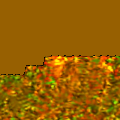

Ship center current coordinates: (60.0, 60.0)
RGB = (223, 102, 0)
Ship Length: (nan m), Width: (nan m)
50 50


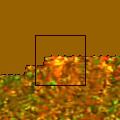

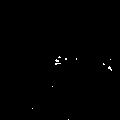

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
Maximum x-axis pixel: 5


0      0
1      0
2      0
3      0
4      0
      ..
115    0
116    0
117    0
118    0
119    0
Length: 120, dtype: int32

Maximum y-axis sum: 5
Maximum x-axis pixel: from 32 to 111
Maximum x-axis pixel: 56
Center x-axis pixel: 72
Maximum y-axis pixel: 56
Maximum y-axis pixel: 7


0      0
1      0
2      0
3      0
4      0
      ..
115    0
116    0
117    0
118    0
119    1
Length: 120, dtype: int32

Maximum x-axis sum: 7
Maximum x-axis pixel: from 56 to 119
Maximum x-axis pixel: 63
Center x-axis pixel: 88
Ship center current coordinates: (88, 72)


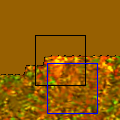

Ship center current coordinates: (72, 88)
tagging_length = 79, tagging_width = 63
More than 1 ship on the picture - TEMPORARILY not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (1482.1970708324918, 1246.879882884607)
Ship left upper corner current coordinates: (1422.1970708324918, 1186.879882884607)
Ship right lower current coordinates: (1542.1970708324918, 1306.879882884607)
Cropped image size: (120, 120)


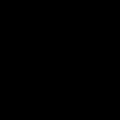

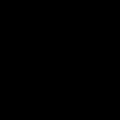

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



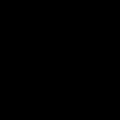

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (3179.7250549273836, 2015.4263077366961)
Ship left upper corner current coordinates: (3119.7250549273836, 1955.4263077366961)
Ship right lower current coordinates: (3239.7250549273836, 2075.426307736696)
Cropped image size: (120, 120)


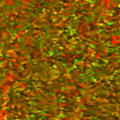

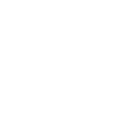

[[1 1 1 ... 1 1 1]
 [1 1 1 ... 1 1 1]
 [1 1 1 ... 1 1 1]
 ...
 [1 1 1 ... 1 1 1]
 [1 1 1 ... 1 1 1]
 [1 1 1 ... 1 1 1]]
black pixels cordinates: []
array shape: (0, 2)


,R,G,B
0,135,79,0
1,111,83,0
2,108,89,0
3,128,100,0
4,138,103,0
...,...,...,...
14395,76,48,0
14396,53,33,0
14397,81,49,0
14398,134,73,0


mean_pixel_value_from_image: [129, 88, 1]



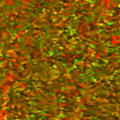

Ship center current coordinates: (60.0, 59.999999999999886)
RGB = (60, 48, 0)
Ship Length: (366.0 m), Width: (52.0 m)
50 50


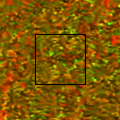

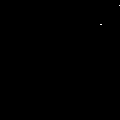

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
Maximum x-axis pixel: 1
Cumulated axis=0 sum px < THRESHOLD (1 < 5) - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (2870.008256992807, 1441.3862027579592)
Ship left upper corner current coordinates: (2810.008256992807, 1381.3862027579592)
Ship right lower current coordinates: (2930.008256992807, 1501.3862027579592)
Cropped image size: (120, 120)


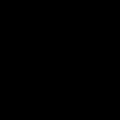

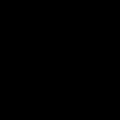

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



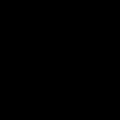

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (2887.4631531491013, 1168.9517865497342)
Ship left upper corner current coordinates: (2827.4631531491013, 1108.9517865497342)
Ship right lower current coordinates: (2947.4631531491013, 1228.9517865497342)
Cropped image size: (120, 120)


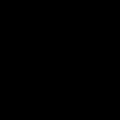

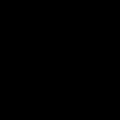

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



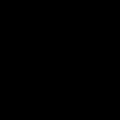

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (3983.02060096066, 1341.6685112024534)
Ship left upper corner current coordinates: (3923.02060096066, 1281.6685112024534)
Ship right lower current coordinates: (4043.02060096066, 1401.6685112024534)
Cropped image size: (120, 120)


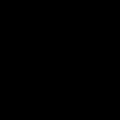

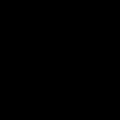

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



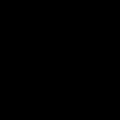

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (3341.463292547607, 1612.2500796399206)
Ship left upper corner current coordinates: (3281.463292547607, 1552.2500796399206)
Ship right lower current coordinates: (3401.463292547607, 1672.2500796399206)
Cropped image size: (120, 120)


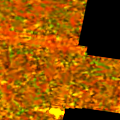

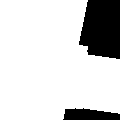

[[1 1 1 ... 0 0 0]
 [1 1 1 ... 0 0 0]
 [1 1 1 ... 0 0 0]
 ...
 [1 1 1 ... 0 0 0]
 [1 1 1 ... 0 0 0]
 [1 1 1 ... 0 0 0]]
black pixels cordinates: [[  0  88]
 [  0  89]
 [  0  90]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (2569, 2)


,R,G,B
0,150,86,0
1,135,98,0
2,153,113,0
3,180,107,0
4,145,107,0
...,...,...,...
11854,149,70,0
11855,108,66,0
11856,117,60,0
11857,99,42,1


mean_pixel_value_from_image: [180, 99, 1]



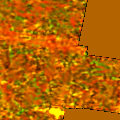

Ship center current coordinates: (60.0, 60.0)
RGB = (145, 80, 0)
Ship Length: (336.0 m), Width: (45.0 m)
50 50


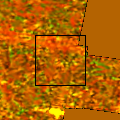

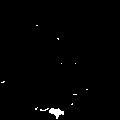

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
Maximum x-axis pixel: 11


0      0
1      1
2      1
3      2
4      1
      ..
115    0
116    0
117    0
118    0
119    0
Length: 120, dtype: int32

Maximum y-axis sum: 11
Maximum x-axis pixel: from 1 to 87
Maximum x-axis pixel: 57
Center x-axis pixel: 44
Maximum y-axis pixel: 57
Maximum y-axis pixel: 18


0      0
1      0
2      0
3      0
4      0
      ..
115    4
116    3
117    2
118    2
119    0
Length: 120, dtype: int32

Maximum x-axis sum: 18
Maximum x-axis pixel: from 25 to 118
Maximum x-axis pixel: 110
Center x-axis pixel: 72
Ship center current coordinates: (72, 44)


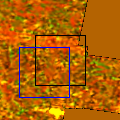

Ship center current coordinates: (44, 72)
tagging_length = 86, tagging_width = 93
More than 1 ship on the picture - TEMPORARILY not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (1743.9712955156904, 1132.1097249632853)
Ship left upper corner current coordinates: (1683.9712955156904, 1072.1097249632853)
Ship right lower current coordinates: (1803.9712955156904, 1192.1097249632853)
Cropped image size: (120, 120)


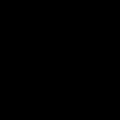

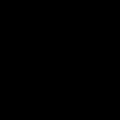

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



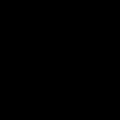

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (1692.956036361442, 871.207770914804)
Ship left upper corner current coordinates: (1632.956036361442, 811.207770914804)
Ship right lower current coordinates: (1752.956036361442, 931.207770914804)
Cropped image size: (120, 120)


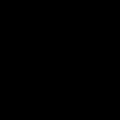

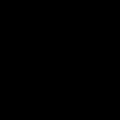

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



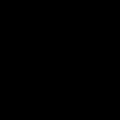

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (5756.228769806698, 2363.222906017001)
Ship left upper corner current coordinates: (5696.228769806698, 2303.222906017001)
Ship right lower current coordinates: (5816.228769806698, 2423.222906017001)
Cropped image size: (120, 120)


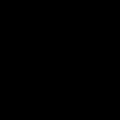

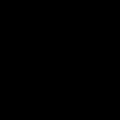

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



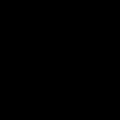

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (5432.794442086372, 2478.549898478817)
Ship left upper corner current coordinates: (5372.794442086372, 2418.549898478817)
Ship right lower current coordinates: (5492.794442086372, 2538.549898478817)
Cropped image size: (120, 120)


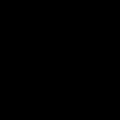

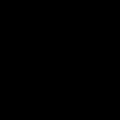

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



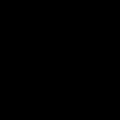

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (2250.5553657449195, 689.7570009217559)
Ship left upper corner current coordinates: (2190.5553657449195, 629.7570009217559)
Ship right lower current coordinates: (2310.5553657449195, 749.7570009217559)
Cropped image size: (120, 120)


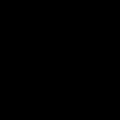

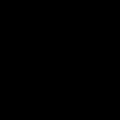

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



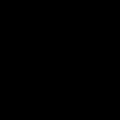

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (5431.484211679848, 2465.0802400929056)
Ship left upper corner current coordinates: (5371.484211679848, 2405.0802400929056)
Ship right lower current coordinates: (5491.484211679848, 2525.0802400929056)
Cropped image size: (120, 120)


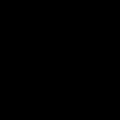

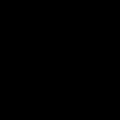

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



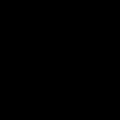

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (1880.3747264381802, 1119.0049574205834)
Ship left upper corner current coordinates: (1820.3747264381802, 1059.0049574205834)
Ship right lower current coordinates: (1940.3747264381802, 1179.0049574205834)
Cropped image size: (120, 120)


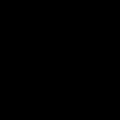

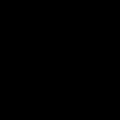

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



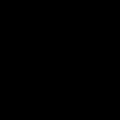

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (5451.881281977941, 2453.434808954969)
Ship left upper corner current coordinates: (5391.881281977941, 2393.434808954969)
Ship right lower current coordinates: (5511.881281977941, 2513.434808954969)
Cropped image size: (120, 120)


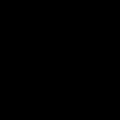

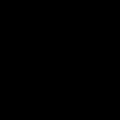

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



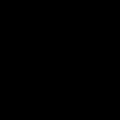

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (1461.1428955413553, 1242.323972725364)
Ship left upper corner current coordinates: (1401.1428955413553, 1182.323972725364)
Ship right lower current coordinates: (1521.1428955413553, 1302.323972725364)
Cropped image size: (120, 120)


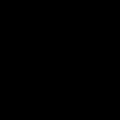

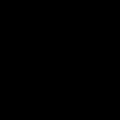

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



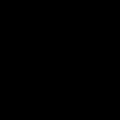

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (3374.08876216442, 919.7146205863583)
Ship left upper corner current coordinates: (3314.08876216442, 859.7146205863583)
Ship right lower current coordinates: (3434.08876216442, 979.7146205863583)
Cropped image size: (120, 120)


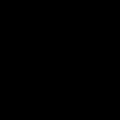

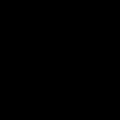

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



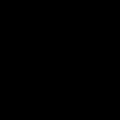

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (5430.995288285808, 2476.392757576943)
Ship left upper corner current coordinates: (5370.995288285808, 2416.392757576943)
Ship right lower current coordinates: (5490.995288285808, 2536.392757576943)
Cropped image size: (120, 120)


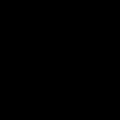

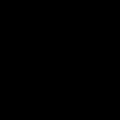

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



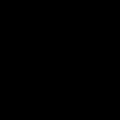

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (1480.1131699646928, 1225.2037516373798)
Ship left upper corner current coordinates: (1420.1131699646928, 1165.2037516373798)
Ship right lower current coordinates: (1540.1131699646928, 1285.2037516373798)
Cropped image size: (120, 120)


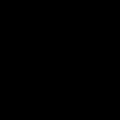

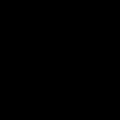

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



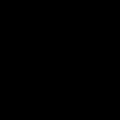

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (5740.67929226791, 2385.82076264809)
Ship left upper corner current coordinates: (5680.67929226791, 2325.82076264809)
Ship right lower current coordinates: (5800.67929226791, 2445.82076264809)
Cropped image size: (120, 120)


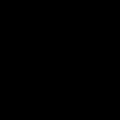

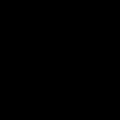

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



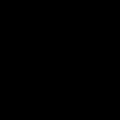

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (3186.7522833162643, 817.6630958432495)
Ship left upper corner current coordinates: (3126.7522833162643, 757.6630958432495)
Ship right lower current coordinates: (3246.7522833162643, 877.6630958432495)
Cropped image size: (120, 120)


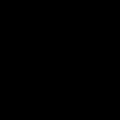

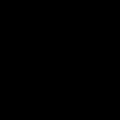

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



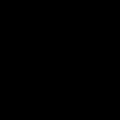

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (3944.5451482331946, 1170.8798401302624)
Ship left upper corner current coordinates: (3884.5451482331946, 1110.8798401302624)
Ship right lower current coordinates: (4004.5451482331946, 1230.8798401302624)
Cropped image size: (120, 120)


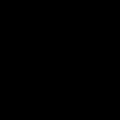

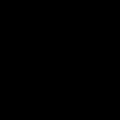

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



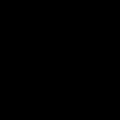

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (2245.171617170391, 707.4163869413933)
Ship left upper corner current coordinates: (2185.171617170391, 647.4163869413933)
Ship right lower current coordinates: (2305.171617170391, 767.4163869413933)
Cropped image size: (120, 120)


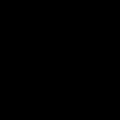

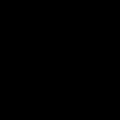

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



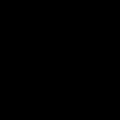

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (2572.2686941374027, 794.8426002305827)
Ship left upper corner current coordinates: (2512.2686941374027, 734.8426002305827)
Ship right lower current coordinates: (2632.2686941374027, 854.8426002305827)
Cropped image size: (120, 120)


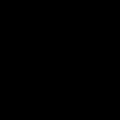

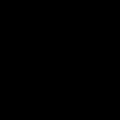

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



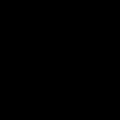

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (1512.832909526021, 1136.7364024657381)
Ship left upper corner current coordinates: (1452.832909526021, 1076.7364024657381)
Ship right lower current coordinates: (1572.832909526021, 1196.7364024657381)
Cropped image size: (120, 120)


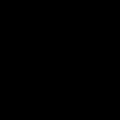

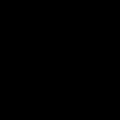

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



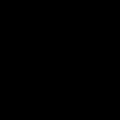

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (5448.758379340064, 2414.07245803228)
Ship left upper corner current coordinates: (5388.758379340064, 2354.07245803228)
Ship right lower current coordinates: (5508.758379340064, 2474.07245803228)
Cropped image size: (120, 120)


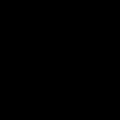

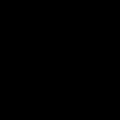

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



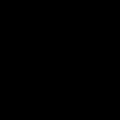

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (2790.169918195904, 1167.4601053730737)
Ship left upper corner current coordinates: (2730.169918195904, 1107.4601053730737)
Ship right lower current coordinates: (2850.169918195904, 1227.4601053730737)
Cropped image size: (120, 120)


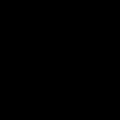

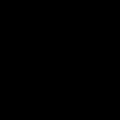

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



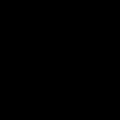

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (1470.7885838304524, 1271.957937770525)
Ship left upper corner current coordinates: (1410.7885838304524, 1211.957937770525)
Ship right lower current coordinates: (1530.7885838304524, 1331.957937770525)
Cropped image size: (120, 120)


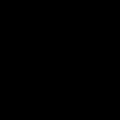

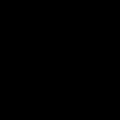

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



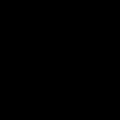

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (1493.4410815325427, 1263.9733617609452)
Ship left upper corner current coordinates: (1433.4410815325427, 1203.9733617609452)
Ship right lower current coordinates: (1553.4410815325427, 1323.9733617609452)
Cropped image size: (120, 120)


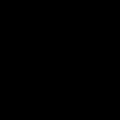

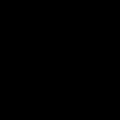

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



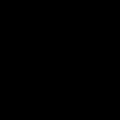

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (3758.2665490490463, 1205.3888822762156)
Ship left upper corner current coordinates: (3698.2665490490463, 1145.3888822762156)
Ship right lower current coordinates: (3818.2665490490463, 1265.3888822762156)
Cropped image size: (120, 120)


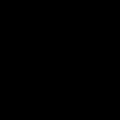

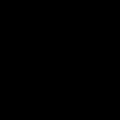

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



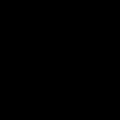

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (2577.278071223108, 795.437046311405)
Ship left upper corner current coordinates: (2517.278071223108, 735.437046311405)
Ship right lower current coordinates: (2637.278071223108, 855.437046311405)
Cropped image size: (120, 120)


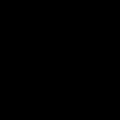

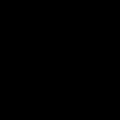

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



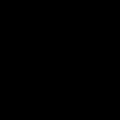

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (3024.893375095117, 2032.7521986103386)
Ship left upper corner current coordinates: (2964.893375095117, 1972.7521986103386)
Ship right lower current coordinates: (3084.893375095117, 2092.7521986103384)
Cropped image size: (120, 120)


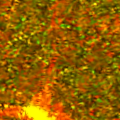

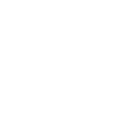

[[1 1 1 ... 1 1 1]
 [1 1 1 ... 1 1 1]
 [1 1 1 ... 1 1 1]
 ...
 [1 1 1 ... 1 1 1]
 [1 1 1 ... 1 1 1]
 [1 1 1 ... 1 1 1]]
black pixels cordinates: []
array shape: (0, 2)


,R,G,B
0,122,77,0
1,129,78,0
2,138,77,0
3,157,82,0
4,175,89,0
...,...,...,...
14395,225,63,0
14396,218,46,0
14397,215,50,0
14398,211,62,0


mean_pixel_value_from_image: [146, 95, 1]



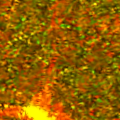

Ship center current coordinates: (60.0, 59.999999999999886)
RGB = (129, 68, 0)
Ship Length: (nan m), Width: (nan m)
50 50


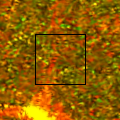

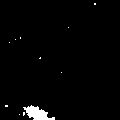

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
Maximum x-axis pixel: 14


0      0
1      0
2      0
3      0
4      0
      ..
115    0
116    0
117    0
118    0
119    0
Length: 120, dtype: int32

Maximum y-axis sum: 14
Maximum x-axis pixel: from 5 to 95
Maximum x-axis pixel: 37
Center x-axis pixel: 50
Maximum y-axis pixel: 37
Maximum y-axis pixel: 24


0       0
1       0
2       0
3       2
4       2
       ..
115    20
116    18
117    20
118    21
119    22
Length: 120, dtype: int32

Maximum x-axis sum: 24
Maximum x-axis pixel: from 3 to 119
Maximum x-axis pixel: 112
Center x-axis pixel: 61
Ship center current coordinates: (61, 50)


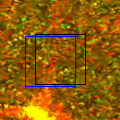

Ship center current coordinates: (50, 61)
tagging_length = 90, tagging_width = 116
More than 1 ship on the picture - TEMPORARILY not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (5691.774784637342, 2428.2334886402637)
Ship left upper corner current coordinates: (5631.774784637342, 2368.2334886402637)
Ship right lower current coordinates: (5751.774784637342, 2488.2334886402637)
Cropped image size: (120, 120)


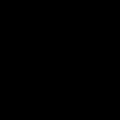

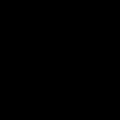

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



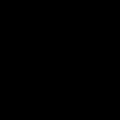

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (1567.5761517508245, 811.2065653771676)
Ship left upper corner current coordinates: (1507.5761517508245, 751.2065653771676)
Ship right lower current coordinates: (1627.5761517508245, 871.2065653771676)
Cropped image size: (120, 120)


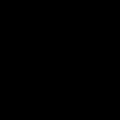

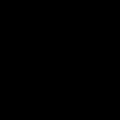

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



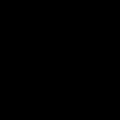

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (1620.0796185186377, 1101.045783970956)
Ship left upper corner current coordinates: (1560.0796185186377, 1041.045783970956)
Ship right lower current coordinates: (1680.0796185186377, 1161.045783970956)
Cropped image size: (120, 120)


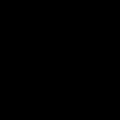

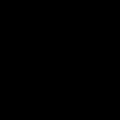

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



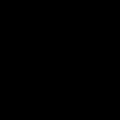

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (2989.3088597006426, 1170.8794702980722)
Ship left upper corner current coordinates: (2929.3088597006426, 1110.8794702980722)
Ship right lower current coordinates: (3049.3088597006426, 1230.8794702980722)
Cropped image size: (120, 120)


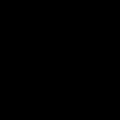

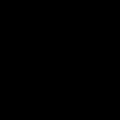

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



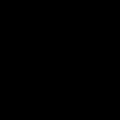

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (5770.62364537718, 2488.3095184814374)
Ship left upper corner current coordinates: (5710.62364537718, 2428.3095184814374)
Ship right lower current coordinates: (5830.62364537718, 2548.3095184814374)
Cropped image size: (120, 120)


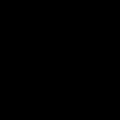

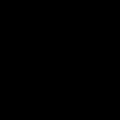

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



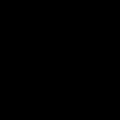

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (3382.6385938106064, 916.105519006491)
Ship left upper corner current coordinates: (3322.6385938106064, 856.105519006491)
Ship right lower current coordinates: (3442.6385938106064, 976.105519006491)
Cropped image size: (120, 120)


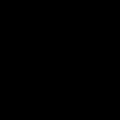

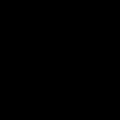

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



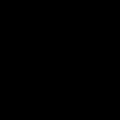

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (5769.774960342575, 2493.4667102451835)
Ship left upper corner current coordinates: (5709.774960342575, 2433.4667102451835)
Ship right lower current coordinates: (5829.774960342575, 2553.4667102451835)
Cropped image size: (120, 120)


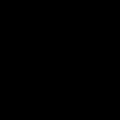

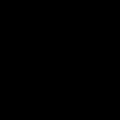

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



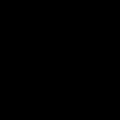

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (5428.949466874526, 2489.9993211142755)
Ship left upper corner current coordinates: (5368.949466874526, 2429.9993211142755)
Ship right lower current coordinates: (5488.949466874526, 2549.9993211142755)
Cropped image size: (120, 120)


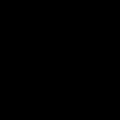

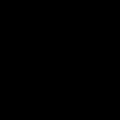

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



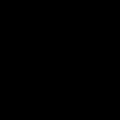

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (1727.210527938268, 1182.4570671727993)
Ship left upper corner current coordinates: (1667.210527938268, 1122.4570671727993)
Ship right lower current coordinates: (1787.210527938268, 1242.4570671727993)
Cropped image size: (120, 120)


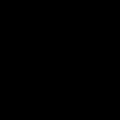

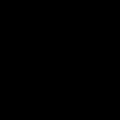

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



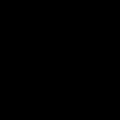

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (5410.8043898751575, 2468.523377831333)
Ship left upper corner current coordinates: (5350.8043898751575, 2408.523377831333)
Ship right lower current coordinates: (5470.8043898751575, 2528.523377831333)
Cropped image size: (120, 120)


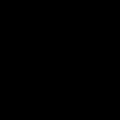

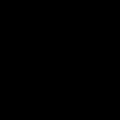

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



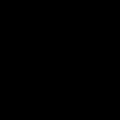

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (5622.200102891609, 2538.7280356574383)
Ship left upper corner current coordinates: (5562.200102891609, 2478.7280356574383)
Ship right lower current coordinates: (5682.200102891609, 2598.7280356574383)
Cropped image size: (120, 120)


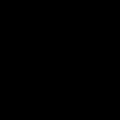

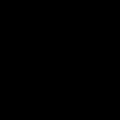

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



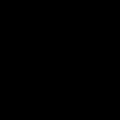

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (3952.8530189555986, 1175.2213002712335)
Ship left upper corner current coordinates: (3892.8530189555986, 1115.2213002712335)
Ship right lower current coordinates: (4012.8530189555986, 1235.2213002712335)
Cropped image size: (120, 120)


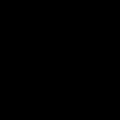

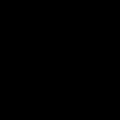

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



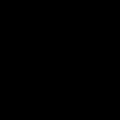

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (2903.995210726929, 1320.8271942287806)
Ship left upper corner current coordinates: (2843.995210726929, 1260.8271942287806)
Ship right lower current coordinates: (2963.995210726929, 1380.8271942287806)
Cropped image size: (120, 120)


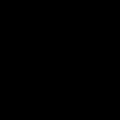

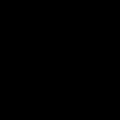

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



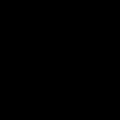

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (5436.0753936139445, 2480.777767623517)
Ship left upper corner current coordinates: (5376.0753936139445, 2420.777767623517)
Ship right lower current coordinates: (5496.0753936139445, 2540.777767623517)
Cropped image size: (120, 120)


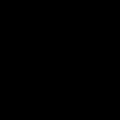

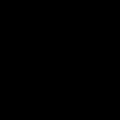

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



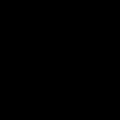

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (1504.826096920734, 1236.893040300587)
Ship left upper corner current coordinates: (1444.826096920734, 1176.893040300587)
Ship right lower current coordinates: (1564.826096920734, 1296.893040300587)
Cropped image size: (120, 120)


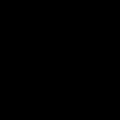

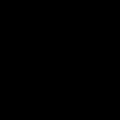

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



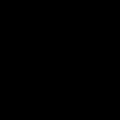

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (1520.4115652962155, 1272.1802069199919)
Ship left upper corner current coordinates: (1460.4115652962155, 1212.1802069199919)
Ship right lower current coordinates: (1580.4115652962155, 1332.1802069199919)
Cropped image size: (120, 120)


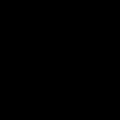

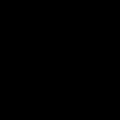

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



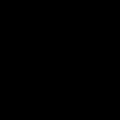

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (5779.383223891614, 2491.352742093266)
Ship left upper corner current coordinates: (5719.383223891614, 2431.352742093266)
Ship right lower current coordinates: (5839.383223891614, 2551.352742093266)
Cropped image size: (120, 120)


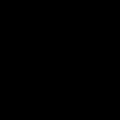

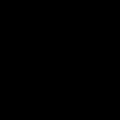

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



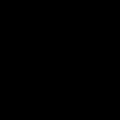

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (3125.0915950499325, 2145.9169503554303)
Ship left upper corner current coordinates: (3065.0915950499325, 2085.9169503554303)
Ship right lower current coordinates: (3185.0915950499325, 2205.9169503554303)
Cropped image size: (120, 120)


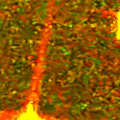

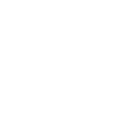

[[1 1 1 ... 1 1 1]
 [1 1 1 ... 1 1 1]
 [1 1 1 ... 1 1 1]
 ...
 [1 1 1 ... 1 1 1]
 [1 1 1 ... 1 1 1]
 [1 1 1 ... 1 1 1]]
black pixels cordinates: []
array shape: (0, 2)


,R,G,B
0,145,113,0
1,142,97,0
2,146,91,0
3,157,95,0
4,160,100,0
...,...,...,...
14395,127,50,0
14396,110,39,0
14397,120,54,0
14398,124,72,0


mean_pixel_value_from_image: [141, 87, 1]



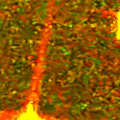

Ship center current coordinates: (60.0, 60.0)
RGB = (133, 80, 0)
Ship Length: (293.0 m), Width: (32.0 m)
50 50


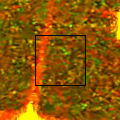

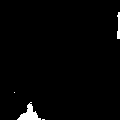

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
Maximum x-axis pixel: 27


0       0
1       0
2       0
3       0
4       0
       ..
115     0
116     0
117    10
118    27
119    27
Length: 120, dtype: int32

Maximum y-axis sum: 27
Maximum x-axis pixel: from 14 to 119
Maximum x-axis pixel: 118
Center x-axis pixel: 66
Maximum y-axis pixel: 118
Maximum y-axis pixel: 27


0       0
1       0
2       0
3       0
4       0
       ..
115    18
116    18
117    19
118    23
119    27
Length: 120, dtype: int32

Maximum x-axis sum: 27
Maximum x-axis pixel: from 12 to 119
Maximum x-axis pixel: 119
Center x-axis pixel: 66
Ship center current coordinates: (66, 66)


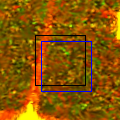

Ship center current coordinates: (66, 66)
tagging_length = 105, tagging_width = 107
More than 1 ship on the picture - TEMPORARILY not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (5626.321521506003, 2488.0120551962427)
Ship left upper corner current coordinates: (5566.321521506003, 2428.0120551962427)
Ship right lower current coordinates: (5686.321521506003, 2548.0120551962427)
Cropped image size: (120, 120)


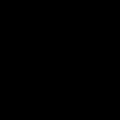

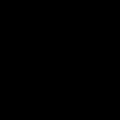

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



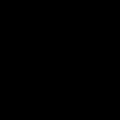

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (5404.901850721046, 2374.6888135687095)
Ship left upper corner current coordinates: (5344.901850721046, 2314.6888135687095)
Ship right lower current coordinates: (5464.901850721046, 2434.6888135687095)
Cropped image size: (120, 120)


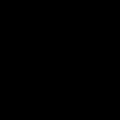

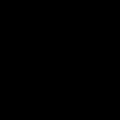

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



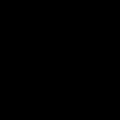

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (1611.5753243201284, 1202.2719365339635)
Ship left upper corner current coordinates: (1551.5753243201284, 1142.2719365339635)
Ship right lower current coordinates: (1671.5753243201284, 1262.2719365339635)
Cropped image size: (120, 120)


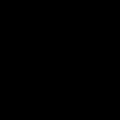

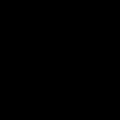

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



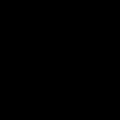

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (5773.957511910381, 2491.5937598125697)
Ship left upper corner current coordinates: (5713.957511910381, 2431.5937598125697)
Ship right lower current coordinates: (5833.957511910381, 2551.5937598125697)
Cropped image size: (120, 120)


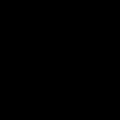

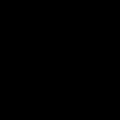

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



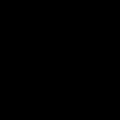

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (3350.3598090233213, 932.5448103419089)
Ship left upper corner current coordinates: (3290.3598090233213, 872.5448103419089)
Ship right lower current coordinates: (3410.3598090233213, 992.5448103419089)
Cropped image size: (120, 120)


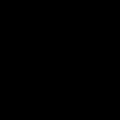

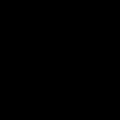

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



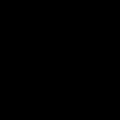

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (3845.0957518676764, 1233.4413939560866)
Ship left upper corner current coordinates: (3785.0957518676764, 1173.4413939560866)
Ship right lower current coordinates: (3905.0957518676764, 1293.4413939560866)
Cropped image size: (120, 120)


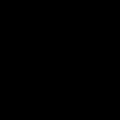

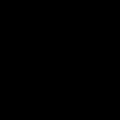

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



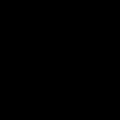

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (5600.158843714506, 2452.8152771612836)
Ship left upper corner current coordinates: (5540.158843714506, 2392.8152771612836)
Ship right lower current coordinates: (5660.158843714506, 2512.8152771612836)
Cropped image size: (120, 120)


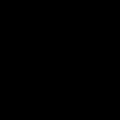

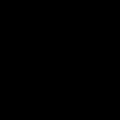

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



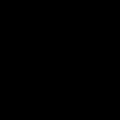

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (5784.9491984313045, 2485.826482527062)
Ship left upper corner current coordinates: (5724.9491984313045, 2425.826482527062)
Ship right lower current coordinates: (5844.9491984313045, 2545.826482527062)
Cropped image size: (120, 120)


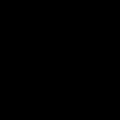

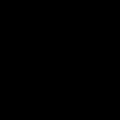

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



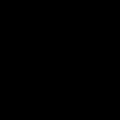

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (3942.52316490521, 1192.9668164939067)
Ship left upper corner current coordinates: (3882.52316490521, 1132.9668164939067)
Ship right lower current coordinates: (4002.52316490521, 1252.9668164939067)
Cropped image size: (120, 120)


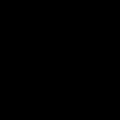

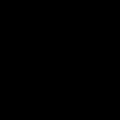

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



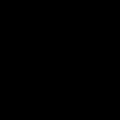

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (5691.708886477363, 2538.9304838195512)
Ship left upper corner current coordinates: (5631.708886477363, 2478.9304838195512)
Ship right lower current coordinates: (5751.708886477363, 2598.9304838195512)
Cropped image size: (120, 120)


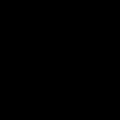

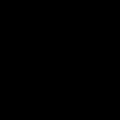

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



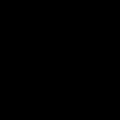

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (3910.909133552025, 1216.5850255951405)
Ship left upper corner current coordinates: (3850.909133552025, 1156.5850255951405)
Ship right lower current coordinates: (3970.909133552025, 1276.5850255951405)
Cropped image size: (120, 120)


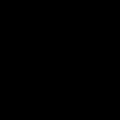

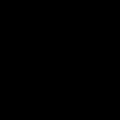

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



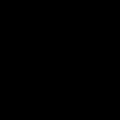

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (5677.080611852712, 2470.3122561601895)
Ship left upper corner current coordinates: (5617.080611852712, 2410.3122561601895)
Ship right lower current coordinates: (5737.080611852712, 2530.3122561601895)
Cropped image size: (120, 120)


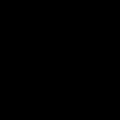

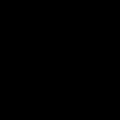

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



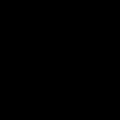

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (3308.6471257349904, 964.6048236903446)
Ship left upper corner current coordinates: (3248.6471257349904, 904.6048236903446)
Ship right lower current coordinates: (3368.6471257349904, 1024.6048236903446)
Cropped image size: (120, 120)


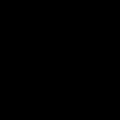

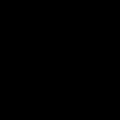

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



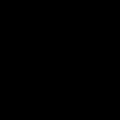

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (5723.988560359563, 2561.901763357795)
Ship left upper corner current coordinates: (5663.988560359563, 2501.901763357795)
Ship right lower current coordinates: (5783.988560359563, 2621.901763357795)
Cropped image size: (120, 120)


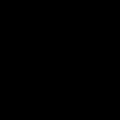

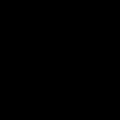

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



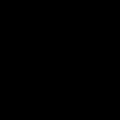

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (5418.312062154654, 2371.9313996954274)
Ship left upper corner current coordinates: (5358.312062154654, 2311.9313996954274)
Ship right lower current coordinates: (5478.312062154654, 2431.9313996954274)
Cropped image size: (120, 120)


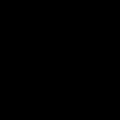

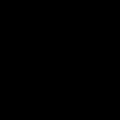

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



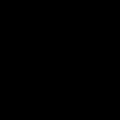

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (1507.8317231721574, 1265.6863234022264)
Ship left upper corner current coordinates: (1447.8317231721574, 1205.6863234022264)
Ship right lower current coordinates: (1567.8317231721574, 1325.6863234022264)
Cropped image size: (120, 120)


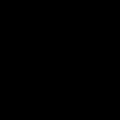

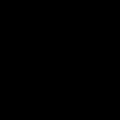

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



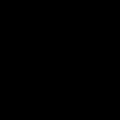

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (5558.869298099357, 2520.6286659987422)
Ship left upper corner current coordinates: (5498.869298099357, 2460.6286659987422)
Ship right lower current coordinates: (5618.869298099357, 2580.6286659987422)
Cropped image size: (120, 120)


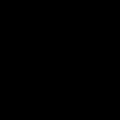

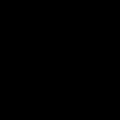

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



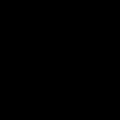

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (2516.1354698398736, 841.4023483198567)
Ship left upper corner current coordinates: (2456.1354698398736, 781.4023483198567)
Ship right lower current coordinates: (2576.1354698398736, 901.4023483198567)
Cropped image size: (120, 120)


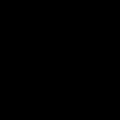

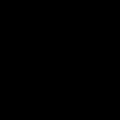

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



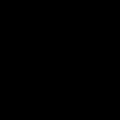

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (3365.9543995952704, 893.079824465823)
Ship left upper corner current coordinates: (3305.9543995952704, 833.079824465823)
Ship right lower current coordinates: (3425.9543995952704, 953.079824465823)
Cropped image size: (120, 120)


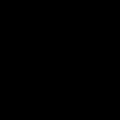

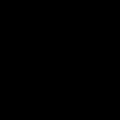

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



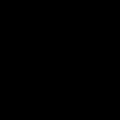

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (3360.5290822584034, 915.8468867229174)
Ship left upper corner current coordinates: (3300.5290822584034, 855.8468867229174)
Ship right lower current coordinates: (3420.5290822584034, 975.8468867229174)
Cropped image size: (120, 120)


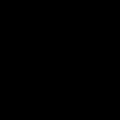

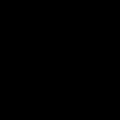

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



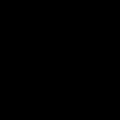

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (3797.1947160970963, 1210.020290858249)
Ship left upper corner current coordinates: (3737.1947160970963, 1150.020290858249)
Ship right lower current coordinates: (3857.1947160970963, 1270.020290858249)
Cropped image size: (120, 120)


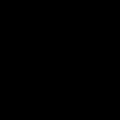

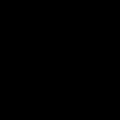

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



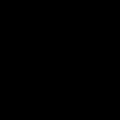

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (5478.3753207866075, 2419.8845268308073)
Ship left upper corner current coordinates: (5418.3753207866075, 2359.8845268308073)
Ship right lower current coordinates: (5538.3753207866075, 2479.8845268308073)
Cropped image size: (120, 120)


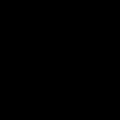

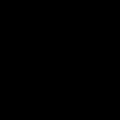

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



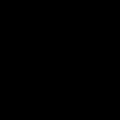

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (1511.4452393309768, 1273.0369377097118)
Ship left upper corner current coordinates: (1451.4452393309768, 1213.0369377097118)
Ship right lower current coordinates: (1571.4452393309768, 1333.0369377097118)
Cropped image size: (120, 120)


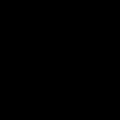

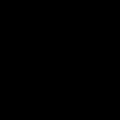

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



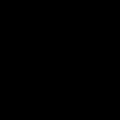

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (5442.832757214571, 2486.4535823251963)
Ship left upper corner current coordinates: (5382.832757214571, 2426.4535823251963)
Ship right lower current coordinates: (5502.832757214571, 2546.4535823251963)
Cropped image size: (120, 120)


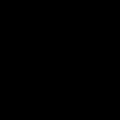

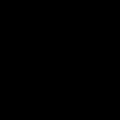

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



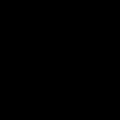

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (3830.387131628572, 1245.352579470951)
Ship left upper corner current coordinates: (3770.387131628572, 1185.352579470951)
Ship right lower current coordinates: (3890.387131628572, 1305.352579470951)
Cropped image size: (120, 120)


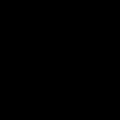

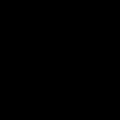

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



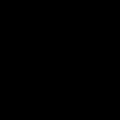

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (5424.669603518257, 2372.734785440316)
Ship left upper corner current coordinates: (5364.669603518257, 2312.734785440316)
Ship right lower current coordinates: (5484.669603518257, 2432.734785440316)
Cropped image size: (120, 120)


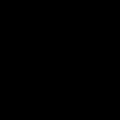

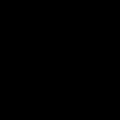

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



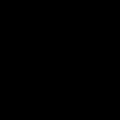

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging

---------------------
NEW PICTURE
Ship center current coordinates: (1162.296023749787, 337.76477103338306)
Ship left upper corner current coordinates: (1102.296023749787, 277.76477103338306)
Ship right lower current coordinates: (1222.296023749787, 397.76477103338306)
Cropped image size: (120, 120)


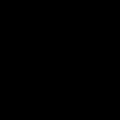

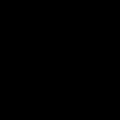

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
black pixels cordinates: [[  0   0]
 [  0   1]
 [  0   2]
 ...
 [119 117]
 [119 118]
 [119 119]]
array shape: (14400, 2)


,R,G,B


mean_pixel_value_from_image: [0, 0, 0]



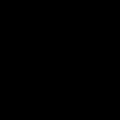

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Black mask - not tagging



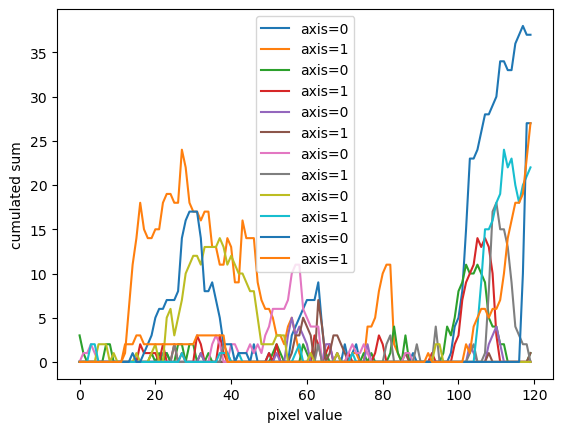

In [97]:
CHOSEN_SLICING_SIZE_PX = 60
SHIP_HEIGHT_PX = 50
SHIP_WIDTH_PX = 50
NEW_IMAGE_LENGTH_RATIO_SCALER = np.longdouble(image_height / (2*CHOSEN_SLICING_SIZE_PX))
NEW_IMAGE_WIDTH_RATIO_SCALER = np.longdouble(image_width / (2*CHOSEN_SLICING_SIZE_PX))
print(image_width, image_height)
print(NEW_IMAGE_LENGTH_RATIO_SCALER, NEW_IMAGE_WIDTH_RATIO_SCALER)
print()
CROP_MARGIN_PX = 0 #-20
FINAL_RECTANGLE_MARGIN_PX = 2
for index, row in im_data.iterrows():
    print("---------------------")
    print("NEW PICTURE")
    lon_x_px = row['LONpx_X2']
    lat_y_px = row['LATpx_Y2']
    print(f"Ship center current coordinates: {lon_x_px, lat_y_px}")
    left, upper = lon_x_px-CHOSEN_SLICING_SIZE_PX, lat_y_px-CHOSEN_SLICING_SIZE_PX
    right, lower = lon_x_px+CHOSEN_SLICING_SIZE_PX, lat_y_px+CHOSEN_SLICING_SIZE_PX
    print(f"Ship left upper corner current coordinates: {left, upper}")
    print(f"Ship right lower current coordinates: {right, lower}")
    im_cropped = im.crop((left, upper, right, lower))
    print(f"Cropped image size: {im_cropped.size}")
    display(im_cropped) #.show()
    #####################################
    # CHANGE BLACK PIXELS INTO MEAN PIXEL VALUE FROM THE PICTURE
    #####################################
    # Threshold just for pixels change
    threshold_level = 1 #black is 0,0,0
    im_gray = im_cropped.convert('L')
    im_gray = im_gray.point( lambda p: 255 if p > threshold_level else 0 )
    im_gray = im_gray.convert('1')
    display(im_gray)
    array = np.array(im_gray).astype(int)
    print(array)
    coords_black = np.column_stack(np.where(array < threshold_level))
    print(f"black pixels cordinates: {coords_black}")
    print(f"array shape: {coords_black.shape}")
    
    # coords_no_black = np.column_stack(np.where(array >= threshold_level))
    # mean_pixel_value_from_image = np.mean(im_cropped)
    #print(coords_no_black)
    # print(f"not black pixels cordinates: {coords_no_black}")
    # print("numpy array before")
#     arr = np.asarray(im_cropped)
#     print(arr)
#     print(arr.shape)
    pixels = list(im_cropped.getdata())
    #print("pixels")
    #print(pixels)
    filtered_pixels = filter(lambda pixel: pixel != (0,0,0), pixels)
    # print(list(filtered_pixels))
    no_black_pixels_df = pd.DataFrame(filtered_pixels, columns=['R', 'G', 'B']).astype({'R':int, 'G':int, 'B':int})
    display(no_black_pixels_df)
    if no_black_pixels_df.empty:
        mean_r, mean_g, mean_b = 0, 0, 0
    else:
        mean_r = no_black_pixels_df['R'].mean()
        mean_g = no_black_pixels_df['G'].mean()
        mean_b = no_black_pixels_df['B'].mean()
    #     mean_pixel_value_from_image = [mean_r, mean_g, mean_b]
    #     print(f"mean_pixel_value_from_image: {mean_pixel_value_from_image}")
        mean_r, mean_g, mean_b = round(mean_r), round(mean_g), round(mean_b)
    mean_pixel_value_from_image = [mean_r, mean_g, mean_b]
    print(f"mean_pixel_value_from_image: {mean_pixel_value_from_image}")
    
#     print(coords_no_black.shape[0])
#     for a in range(coords_no_black.shape[0]):
#         # print(coords[a])
#         x = coords_no_black[a][0]
#         y = coords_no_black[a][1]
#         #print(f"x: {x}")
#         #print(f"y: {y}")
#         im_cropped.putpixel((y, x), (mean_r, mean_g, mean_b))
#     for x in range(arr.shape[0]):
#         print(arr[x])
#         print(arr[x][arr[x] != [0, 0, 0]])
#         break
    # arr2 = np.delete(arr, np.argwhere(arr == [0,0,0]))
    #arr2 = arr[arr != [0, 0, 0]]
    #(data<3).any(axis=2)
#     print(arr2.shape)
#     print("numpy array after")
#     print(arr2)
#     print(arr2[0:3])
#     mean_pixel_value_from_image = np.average(im_cropped, axis = (0,1))
#     mean_r, mean_g, mean_b = round(mean_pixel_value_from_image[0]), round(mean_pixel_value_from_image[1]), round(mean_pixel_value_from_image[2])
#     print(f"mean_pixel_value_from_image: {mean_pixel_value_from_image}")
    
    for a in range(coords_black.shape[0]):
        # print(coords[a])
        x = coords_black[a][0]
        y = coords_black[a][1]
        #print(f"x: {x}")
        #print(f"y: {y}")
        im_cropped.putpixel((y, x), (mean_r, mean_g, mean_b))
    print()
    display(im_cropped)
    #####################################
    # GETTING IMAGE CENTER
    #####################################
    center_x  = (right-left) / 2
    center_y  = (lower-upper) / 2
    print(f"Ship center current coordinates: {center_x, center_y}")
    r, g, b = im_cropped.getpixel((center_x, center_y))
    print(f"RGB = {r, g, b}")
    if (r, g, b) == (0, 0, 0):
        print("Black mask - not tagging")
        print()
        continue
    elif math.isnan(row['Length']): #  or math.isnan(row['Width'])
        print("Missing data about Length - not tagging") #  or Width
        print()
        continue
    elif row['Length'] < 20:
        print(f"Ship is too small to be seen ({row['Length']} m) - not tagging")
        print()
        continue
    print(f"Ship Length: ({row['Length']} m), Width: ({row['Width']} m)")
    
#     pixels = np.array(im_cropped)
#     width, height, channels = pixels.shape
#     print(width, height, channels)

#     actual_width = row['Length']
#     actual_units = 'meters'

#     (x1, y1) = ...
#     (x2, y2) = ...

#     pixel_distance = sqrt((x1 - x2) ** 2 + (y1 - y2) ** 2)

#     actual_distance = (pixel_distance / width) * actual_width

#     print(f"The distance between the two points is about {actual_distance:.3f} {actual_units}")
    
#     crop_size_x = row['Length_px'] * NEW_IMAGE_LENGTH_RATIO_SCALER 
#     crop_size_y = row['Width_px'] * NEW_IMAGE_WIDTH_RATIO_SCALER
    crop_size_x, crop_size_y = 50, 50
    print(crop_size_x, crop_size_y)
    
    left, upper = center_x - (crop_size_x/2) + CROP_MARGIN_PX, center_y - (crop_size_y/2) + CROP_MARGIN_PX
    right, lower = center_x + (crop_size_x/2) + CROP_MARGIN_PX, center_y + (crop_size_y/2) + CROP_MARGIN_PX
    dr = ImageDraw.Draw(im_cropped)
    dr.rectangle(((left, upper), (right, lower)), outline="black")
    #display(im_cropped)
    display(im_cropped)
    ############################
    #### TURN TO GRAYSCALE
    ############################
    threshold = 200 #200 is the best
    im_gray = im_cropped.convert('L')
    # Threshold
    im_gray = im_gray.point( lambda p: 255 if p > threshold else 0 )
    # To mono
    im_gray = im_gray.convert('1')
    #im_gray = im_cropped.convert('L')
    display(im_gray)
    #r, g, b = im_cropped.split()
    #print(r.histogram())
#     hst = im_gray.histogram()
#     print(hst)
    array = np.array(im_gray).astype(int)
    print(array)
    
    width_series = pd.Series(np.sum(array, axis=0))
    width_max = width_series.max()
    print(f"Maximum x-axis pixel: {width_max}")
    LENGTH_SUM_THRESHOLD = 5
    if width_max < LENGTH_SUM_THRESHOLD:
        print(f"Cumulated axis=0 sum px < THRESHOLD ({width_max} < {LENGTH_SUM_THRESHOLD}) - not tagging")
        print()
        continue
    display(width_series)
    print(f"Maximum y-axis sum: {width_max}")
    width_max_pixel = width_series[width_series == width_max].index[0]
    width_max_pixel_first = width_series[width_series > 0].index[0]
    width_max_pixel_last = width_series[width_series > 0].index[-1]
    width_center_pixel = round((width_max_pixel_first + width_max_pixel_last) / 2)
    print(f"Maximum x-axis pixel: from {width_max_pixel_first} to {width_max_pixel_last}")
    print(f"Maximum x-axis pixel: {width_max_pixel}")
    print(f"Center x-axis pixel: {width_center_pixel}")
    print(f"Maximum y-axis pixel: {width_max_pixel}")
    
    length_series = pd.Series(np.sum(array, axis=1))
    length_max = length_series.max()
    print(f"Maximum y-axis pixel: {length_max}")
    if length_max < LENGTH_SUM_THRESHOLD:
        print(f"Cumulated axis=1 sum px < THRESHOLD ({length_max} < {LENGTH_SUM_THRESHOLD}) - not tagging")
        print()
        continue
    width_series.plot(label='axis=0')
    length_series.plot(label='axis=1', xlabel='pixel value', ylabel='cumulated sum')
    display(length_series)
    print(f"Maximum x-axis sum: {length_max}")
    length_max_pixel = length_series[length_series == length_max].index[0]
    length_max_pixel_first = length_series[length_series > 0].index[0]
    length_max_pixel_last = length_series[length_series > 0].index[-1]
    length_center_pixel = round((length_max_pixel_first + length_max_pixel_last) / 2)
    print(f"Maximum x-axis pixel: from {length_max_pixel_first} to {length_max_pixel_last}")
    print(f"Maximum x-axis pixel: {length_max_pixel}")
    print(f"Center x-axis pixel: {length_center_pixel}")
    plt.legend()
    
    print(f"Ship center current coordinates: {length_center_pixel, width_center_pixel}")
    left, upper = width_center_pixel - (crop_size_x/2) + CROP_MARGIN_PX, length_center_pixel - (crop_size_y/2) + CROP_MARGIN_PX
    right, lower = width_center_pixel + (crop_size_x/2) + CROP_MARGIN_PX, length_center_pixel + (crop_size_y/2) + CROP_MARGIN_PX
    dr = ImageDraw.Draw(im_cropped)
    dr.rectangle(((left, upper), (right, lower)), outline="blue")
    #display(im_cropped)
    display(im_cropped)
    
    print(f"Ship center current coordinates: {width_center_pixel, length_center_pixel}")
    tagging_length = length_max_pixel_last - length_max_pixel_first
    tagging_width = width_max_pixel_last - width_max_pixel_first
    print(f"tagging_length = {tagging_width}, tagging_width = {tagging_length}")
    # IF THERE IS MORE THAN 1 SHIP IN THE PICTURE
    if tagging_length > SHIP_HEIGHT_PX or tagging_width > SHIP_WIDTH_PX:
        print(f"More than 1 ship on the picture - TEMPORARILY not tagging")
        print()
        # TODO later: find a way to tag more than 1 ship
#         tagging_length = SHIP_HEIGHT_PX
#         tagging_width = SHIP_WIDTH_PX
        continue
    print(f"tagging_length = {tagging_width}, tagging_width = {tagging_length}")
    left, upper = width_center_pixel - (tagging_width/2) - FINAL_RECTANGLE_MARGIN_PX, length_center_pixel - (tagging_length/2) - FINAL_RECTANGLE_MARGIN_PX
    right, lower = width_center_pixel + (tagging_width/2) + FINAL_RECTANGLE_MARGIN_PX, length_center_pixel + (tagging_length/2) + FINAL_RECTANGLE_MARGIN_PX
    print(f"x0,y0 = {left, upper}, x1,y1 = {right, lower}")
    dr = ImageDraw.Draw(im_cropped)
    dr.rectangle(((left, upper), (right, lower)), outline="purple")
    display(im_cropped)
    
    plt.show()
    
#     hst = im_gray.histogram()
#     print(hst)
#     pd.Series(hst).plot()
    
#     # Otsu's thresholding
#     ret2, th2 = cv.threshold(im_gray, 0, 255, cv.THRESH_BINARY + cv.THRESH_OTSU)
#     plt.imshow(ret2, 'gray')

    if index > 100:
        break


In [281]:
length_series[length_series > 0].index

Int64Index([58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69], dtype='int64')

0      0
1      0
2      0
3      0
4      0
      ..
115    0
116    0
117    0
118    0
119    0
Length: 120, dtype: int32

Maximum x-axis sum: 37
Maximum x-axis pixel: 65


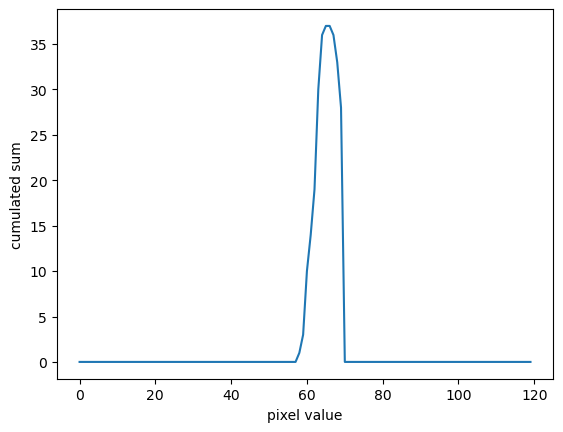

In [278]:
length_series = pd.Series(np.sum(array, axis=1))
length_series.plot(label='axis=1', xlabel='pixel value', ylabel='cumulated sum')
length_max = length_series.max()
display(length_series)
print(f"Maximum x-axis sum: {length_max}")
length_max_pixel = length_series[length_series == length_max].index[0]
print(f"Maximum x-axis pixel: {length_max_pixel}")

In [268]:
array[:1]

array([[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1,
        1, 1, 0, 0, 0, 0, 0, 0, 0, 0]])

In [231]:
array.shape

(120, 120)

In [236]:
array[:][0:3]

array([[  0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0,   0,   0,   0,   0,   0,   0,   8,  42,  47,  49,
         53,  61,  67,  63,  52,  61,  70,  71,  88,  77,  51,  52,  58,
         51,  46,  75,  92, 113, 114, 115, 105,  92,  90,  87,  80,  67,
         49,  42,  48],
       [  0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0,   0,

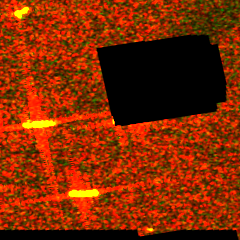

In [48]:
im_cropped

In [197]:
array

array([[  0,   0,   0, ...,  49,  42,  48],
       [  0,   0,   0, ...,  51,  32,  38],
       [  0,   0,   0, ...,  95,  66,  51],
       ...,
       [ 91,  92,  70, ...,  92,  50,  44],
       [101, 107,  56, ...,  90,  67,  53],
       [103, 105,  83, ...,  76,  64,  59]])

In [251]:
length_series[length_series == length_max].index[-1]

66

0      0.0
1      0.0
2      0.0
3      0.0
4      0.0
      ... 
115    0.0
116    0.0
117    0.0
118    0.0
119    0.0
Length: 120, dtype: float64

Maximum x-axis sum: 0.5
Maximum x-axis pixel: from 69 to 69


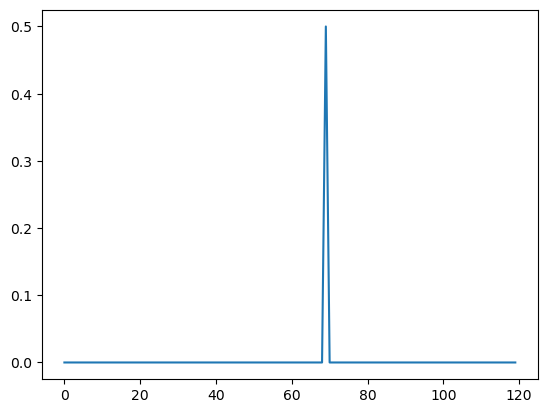

In [273]:
length_series = pd.Series(np.median(array, axis=1))
length_series.plot()
length_max = length_series.max()
display(length_series)
print(f"Maximum x-axis sum: {length_max}")
length_max_pixel_first = length_series[length_series == length_max].index[0]
length_max_pixel_last = length_series[length_series == length_max].index[-1]
print(f"Maximum x-axis pixel: from {length_max_pixel_first} to {length_max_pixel_last}")

0       2236
1       2210
2       2022
3       1833
4       1796
       ...  
115    10238
116    10111
117    10271
118    10365
119    10159
Length: 120, dtype: int32

Maximum x-axis sum: 15967
Maximum x-axis pixel: 65


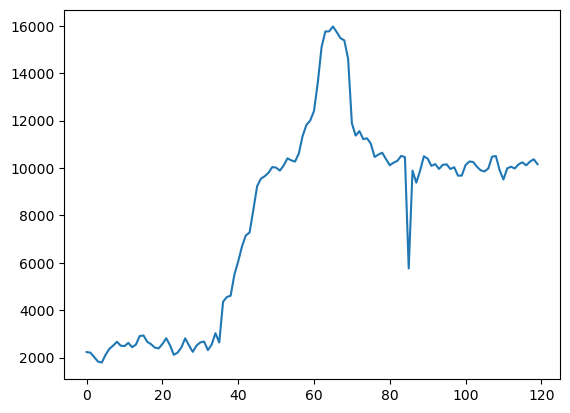

In [217]:
length_series = pd.Series(array.sum(axis=1))
length_series.plot()
length_max = length_series.max()
display(length_series)
print(f"Maximum x-axis sum: {length_max}")
length_max_pixel = length_series[length_series == length_max].index[0]
print(f"Maximum x-axis pixel: {length_max_pixel}")

0       6605
1       6671
2       6488
3       6705
4       6639
       ...  
115    10016
116    10273
117    10438
118    10292
119     9957
Length: 120, dtype: int32

Maximum y-axis sum: 10438
Maximum y-axis pixel: 117


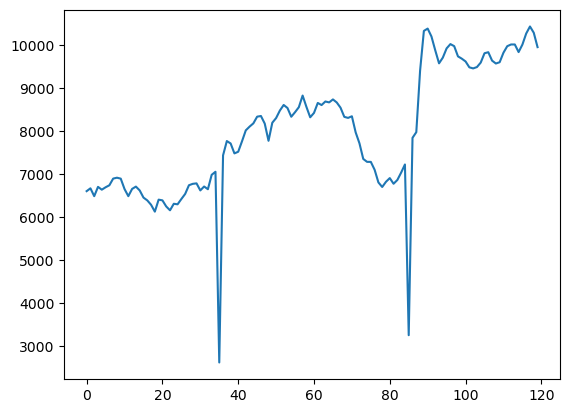

In [219]:
width_series = pd.Series(array.sum(axis=0))
width_series.plot()
width_max = width_series.max()
display(width_series)
print(f"Maximum y-axis sum: {width_max}")
width_max_pixel = width_series[width_series == width_max].index[0]
print(f"Maximum y-axis pixel: {width_max_pixel}")

<AxesSubplot:>

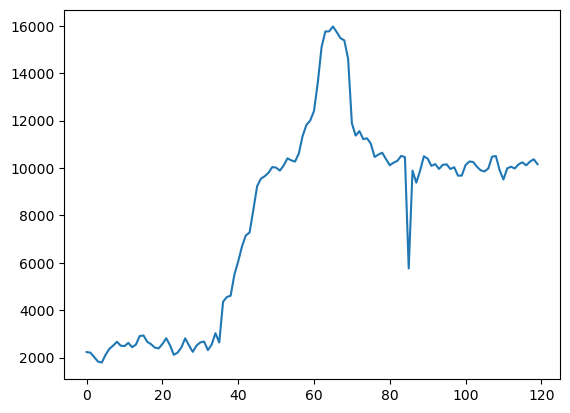

In [198]:
pd.Series(array.sum(axis=1)).plot()

<AxesSubplot:>

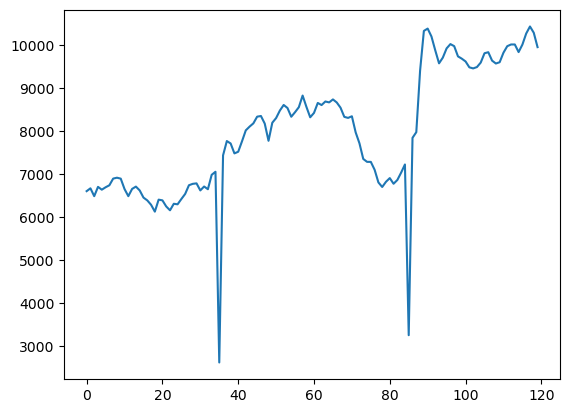

In [200]:
pd.Series(array.sum(axis=0)).plot()

<AxesSubplot:>

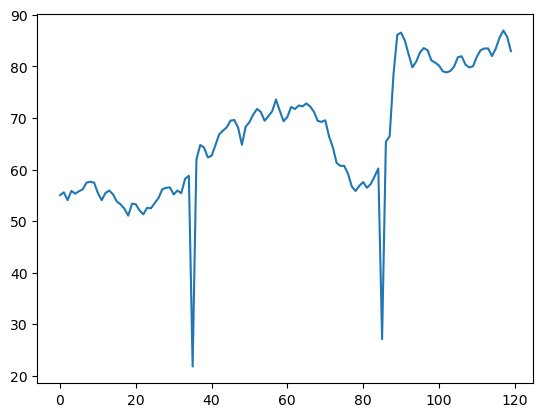

In [202]:
pd.Series(array.mean(axis=0)).plot()

In [ ]:
    
    Red=hst[0:256] # indicates Red
    Green=hst[256:512] # indicated Green
    Blue=hst[512:768] # indicates Blue
    
    plt.figure(0) # plots a figure to display RED Histogram
    for i in range(0, 256):
        plt.bar(i, Red[i], color = getRed(i),alpha=0.3)
    
    plt.figure(1) # plots a figure to display GREEN Histogram
    for i in range(0, 256):
        plt.bar(i, Green[i], color = getGreen(i),alpha=0.3)
    
    plt.figure(2) # plots a figure to display BLUE Histogram
    for i in range(0, 256):
        plt.bar(i, Blue[i], color = getBlue(i),alpha=0.3)
    
    plt.show()

## Dorobek solution

In [32]:
with open('subset89.txt', 'r') as f:
    lines = f.read().strip().split('\n')

In [33]:
print(lines)

['1 0.31875 0.496875 0.15625 0.15625', '3 0.63125 0.228125 0.15625 0.15625']


In [7]:
for l in lines:

    break

In [11]:
from PIL import Image
from PIL import ImageDraw

In [34]:
x = int(float(lines[0].split(' ')[1])*320)
y = int(float(lines[0].split(' ')[2])*320)
im = Image.open("subset89.png")
# im = im.convert('1')
CROP_SIZE = 15
dr = ImageDraw.Draw(im)
dr.rectangle(((x-CROP_SIZE, y-CROP_SIZE), (x+CROP_SIZE, y+CROP_SIZE)), outline="black")
im_cropped = im.crop((x-CROP_SIZE, y-CROP_SIZE, x+CROP_SIZE, y+CROP_SIZE))
im_cropped

In [35]:
x, y

(102, 159)

In [36]:
dr

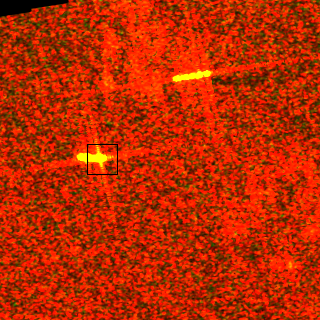

In [18]:
im

In [17]:
array = np.array(im_cropped).astype(int)
array

array([[[  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0],
        ...,
        [  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0]],

       [[  0,   0,   0],
        [145,  59,   0],
        [255,  60,   0],
        ...,
        [207,  59,   0],
        [162,  42,   0],
        [140,  31,   0]],

       [[  0,   0,   0],
        [132,  55,   0],
        [255,  30,   1],
        ...,
        [166,  44,   0],
        [120,  28,   0],
        [ 85,  21,   0]],

       ...,

       [[  0,   0,   0],
        [255,  36,   0],
        [255,  49,   1],
        ...,
        [170,  69,   0],
        [127,  61,   0],
        [122,  51,   0]],

       [[  0,   0,   0],
        [223,  31,   0],
        [255,  39,   0],
        ...,
        [ 85,  62,   0],
        [ 70,  54,   0],
        [154,  60,   0]],

       [[  0,   0,   0],
        [255,  40,   0],
        [255,  64,   0],
        ...,
        [104,  70,   0],
        [125,  60,   0],
        [230,  48,   0]]

In [13]:
import numpy as np

im_cropped_gray = im_cropped.convert('1')
im_cropped_gray
array = np.array(im_cropped_gray).astype(int)
array

array([[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0],
       [0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0,
        1, 0, 1, 0, 0, 1, 0, 0],
       [0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0,
        0, 1, 0, 0, 1, 0, 0, 0],
       [0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1,
        0, 0, 0, 1, 0, 0, 1, 0],
       [0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0,
        0, 1, 0, 0, 0, 1, 0, 0],
       [0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0,
        0, 0, 0, 1, 0, 0, 1, 0],
       [0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0,
        1, 0, 0, 0, 1, 0, 1, 0],
       [0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0,
        0, 0, 1, 0, 1, 0, 0, 1],
       [0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0,
        1, 0, 1, 0, 0, 1, 0, 0],
       [0, 1, 1, 0, 1, 0, 0, 1, 0, 1,

In [14]:
im_cropped_gray

<AxesSubplot:>

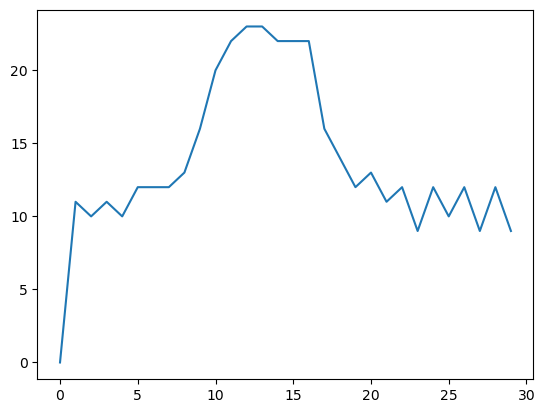

In [15]:
import pandas as pd


pd.Series(array.sum(axis=1)).plot()

<AxesSubplot:>

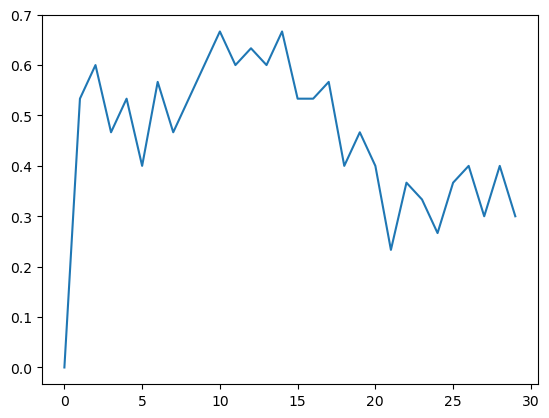

In [16]:
pd.Series(array.mean(axis=0)).plot()